### Brain MRI Segmentation Using SAM (Segment Anything Model)

# Introduction

This notebook is dedicated to an exploratory data analysis (EDA) of a comprehensive dataset that combines brain MRI images, tumor segmentation masks, and genomic as well as clinical data for cancer patients. The primary objective of this analysis is to uncover insights that can aid in understanding the relationship between imaging features and genetic markers, ultimately contributing to the advancement of personalized medicine for brain cancer.

The dataset consists of brain MRI images with corresponding segmentation masks that outline tumor regions, providing crucial information on the spatial characteristics of the tumors. In addition to the imaging data, the dataset includes detailed genomic profiles and clinical attributes for each patient, including:

- **RNASeqCluster**: Gene expression clusters derived from RNA sequencing data.
- **MethylationCluster**: DNA methylation clusters, indicative of epigenetic changes.
- **miRNACluster**: Clusters of microRNA expression profiles.
- **CNCluster**: Clusters based on copy number variation, reflecting changes in DNA sequence.
- **RPPACluster**: Protein expression clusters derived from reverse phase protein array data.
- **OncosignCluster**: Oncogenic signaling pathway clusters.
- **COCCluster**: Clusters based on consensus molecular subtypes.
- **Histological type**: The histological classification of the tumor.
- **Neoplasm histologic grade**: The grade of the tumor, indicating its aggressiveness.
- **Tumor tissue site**: The anatomical location of the tumor within the brain.
- **Laterality**: The side of the brain where the tumor is located.
- **Tumor location**: More detailed information on the tumor's position within the brain.
- **Gender**: The gender of the patient.
- **Age at initial pathologic diagnosis**: The patient's age at the time of diagnosis.
- **Race** and **Ethnicity**: Demographic information about the patient.

This EDA aims to explore the distribution and relationships within this diverse set of features, providing a foundation for subsequent modeling efforts. By analyzing both the imaging and genomic data, we hope to identify patterns that may reveal underlying biological mechanisms and support the development of predictive models for brain cancer prognosis and treatment.

# Exploratory Data Analysis (EDA)

## Importing Libraries and Setting Up the Environment

In this section, we import the necessary libraries and configure the environment for our analysis, suppressing unnecessary warnings and importing essential libraries for data processing and visualization.

- **NumPy and Pandas**: For handling data structures, performing numerical operations, and managing datasets.
- **OpenCV**: For image processing and manipulation.
- **Matplotlib and Seaborn**: For creating visualizations to explore and analyze the data.
- **Warnings**: To suppress unnecessary warnings for a cleaner output.

In [1]:
import os
import warnings
import numpy as np
import pandas as pd

import cv2
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import MinMaxScaler

# Suppress general warnings
warnings.filterwarnings('ignore')

# Loading and Preprocessing the Dataset

We begin by loading the dataset containing clinical and genomic information for the patients. The dataset is loaded into a Pandas DataFrame, and we then perform initial preprocessing steps, such as dropping irrelevant columns.

- **Loading the Data**: The dataset is read from a CSV file into a DataFrame.
- **Dropping Columns**: We remove the `death01` column, as it is not needed for our analysis.
- **Displaying the Data**: We display the first few rows of the processed DataFrame to get an overview of the data structure and contents.

In [2]:
df = pd.read_csv("/kaggle/input/lgg-mri-segmentation/kaggle_3m/data.csv")

# Drop Columns And showing First Rows
df = df.drop(columns=["death01"])
df.head()

,Patient,RNASeqCluster,MethylationCluster,miRNACluster,CNCluster,RPPACluster,OncosignCluster,COCCluster,histological_type,neoplasm_histologic_grade,tumor_tissue_site,laterality,tumor_location,gender,age_at_initial_pathologic,race,ethnicity
0,TCGA_CS_4941,2.0,4.0,2,2.0,NaN,3.0,2,1.0,2.0,1.0,3.0,2.0,2.0,67.0,3.0,2.0
1,TCGA_CS_4942,1.0,5.0,2,1.0,1.0,2.0,1,1.0,2.0,1.0,3.0,2.0,1.0,44.0,2.0,NaN
2,TCGA_CS_4943,1.0,5.0,2,1.0,2.0,2.0,1,1.0,2.0,1.0,1.0,2.0,2.0,37.0,3.0,NaN
3,TCGA_CS_4944,NaN,5.0,2,1.0,2.0,1.0,1,1.0,1.0,1.0,3.0,6.0,2.0,50.0,3.0,NaN
4,TCGA_CS_5393,4.0,5.0,2,1.0,2.0,3.0,1,1.0,2.0,1.0,1.0,6.0,2.0,39.0,3.0,NaN


In [3]:
# Assuming `df` is your DataFrame
print(f"Shape of DataFrame: {df.shape}")

Shape of DataFrame: (110, 17)


In [4]:
# Print summary statistics for numeric columns
print("Summary Statistics:\n")
df.describe()

Summary Statistics:



,RNASeqCluster,MethylationCluster,miRNACluster,CNCluster,RPPACluster,OncosignCluster,COCCluster,histological_type,neoplasm_histologic_grade,tumor_tissue_site,laterality,tumor_location,gender,age_at_initial_pathologic,race,ethnicity
count,92.000000,109.000000,110.000000,108.000000,98.000000,105.000000,110.000000,109.000000,109.000000,109.0,109.000000,109.000000,109.000000,109.000000,108.000000,102.000000
mean,2.445652,3.678899,1.900000,1.722222,2.367347,1.895238,1.763636,2.128440,1.532110,1.0,2.009174,3.513761,1.486239,45.834862,2.907407,1.970588
std,1.180092,1.169684,0.789263,0.862872,1.125045,0.663960,0.855927,0.850935,0.501273,0.0,0.995317,1.863960,0.502119,13.797151,0.291212,0.169792
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000,1.000000,20.000000,2.000000,1.000000
25%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,2.000000,1.000000,34.000000,3.000000,2.000000
50%,2.000000,4.000000,2.000000,1.000000,2.000000,2.000000,1.000000,2.000000,2.000000,1.0,2.000000,2.000000,1.000000,47.000000,3.000000,2.000000
75%,4.000000,5.000000,2.000000,3.000000,3.000000,2.000000,3.000000,3.000000,2.000000,1.0,3.000000,6.000000,2.000000,58.000000,3.000000,2.000000
max,4.000000,5.000000,4.000000,3.000000,4.000000,3.000000,3.000000,3.000000,2.000000,1.0,3.000000,6.000000,2.000000,75.000000,3.000000,2.000000


In [5]:
# Print column names
print(f"Columns: {df.columns.tolist()}")

Columns: ['Patient', 'RNASeqCluster', 'MethylationCluster', 'miRNACluster', 'CNCluster', 'RPPACluster', 'OncosignCluster', 'COCCluster', 'histological_type', 'neoplasm_histologic_grade', 'tumor_tissue_site', 'laterality', 'tumor_location', 'gender', 'age_at_initial_pathologic', 'race', 'ethnicity']


In [6]:
# Print count of unique values per column
print(f"Unique Values Count:\n{df.nunique()}")

Unique Values Count:
Patient                      110
RNASeqCluster                  4
MethylationCluster             5
miRNACluster                   4
CNCluster                      3
RPPACluster                    4
OncosignCluster                3
COCCluster                     3
histological_type              3
neoplasm_histologic_grade      2
tumor_tissue_site              1
laterality                     3
tumor_location                 5
gender                         2
age_at_initial_pathologic     45
race                           2
ethnicity                      2
dtype: int64


In [7]:
# Print data types of each column
print(f"Data Types:\n{df.dtypes}")

Data Types:
Patient                       object
RNASeqCluster                float64
MethylationCluster           float64
miRNACluster                   int64
CNCluster                    float64
RPPACluster                  float64
OncosignCluster              float64
COCCluster                     int64
histological_type            float64
neoplasm_histologic_grade    float64
tumor_tissue_site            float64
laterality                   float64
tumor_location               float64
gender                       float64
age_at_initial_pathologic    float64
race                         float64
ethnicity                    float64
dtype: object


In [8]:
# Print information about missing values
print(f"Missing Values:\n{df.isna().sum()}")

Missing Values:
Patient                       0
RNASeqCluster                18
MethylationCluster            1
miRNACluster                  0
CNCluster                     2
RPPACluster                  12
OncosignCluster               5
COCCluster                    0
histological_type             1
neoplasm_histologic_grade     1
tumor_tissue_site             1
laterality                    1
tumor_location                1
gender                        1
age_at_initial_pathologic     1
race                          2
ethnicity                     8
dtype: int64


In [9]:
# Esay Missaing Values
df = df.fillna(0)

In [10]:
# Print count of duplicate rows
print(f"Duplicate Rows Count: {df.duplicated().sum()}")

Duplicate Rows Count: 0


In [11]:
# Print memory usage
print(f"Memory Usage:\n{df.memory_usage(deep=True)}")

Memory Usage:
Index                         128
Patient                      7590
RNASeqCluster                 880
MethylationCluster            880
miRNACluster                  880
CNCluster                     880
RPPACluster                   880
OncosignCluster               880
COCCluster                    880
histological_type             880
neoplasm_histologic_grade     880
tumor_tissue_site             880
laterality                    880
tumor_location                880
gender                        880
age_at_initial_pathologic     880
race                          880
ethnicity                     880
dtype: int64


# Data Collection and Preprocessing

In this section, we outline the process of collecting and preprocessing brain MRI images and their corresponding segmentation masks. The goal is to prepare a dataset that includes not only the images and masks but also associated metadata such as patient IDs, diagnoses, and tumor sizes.

### Process Overview

1. **Labeling the Data**:
    - We extract the patient ID from the file names of the MRI images. A diagnosis label is assigned based on whether a tumor is detected in the mask (i.e., if the mask contains any non-zero pixels). Additionally, the size of the tumor is quantified by summing the pixels in the mask.

2. **Preprocessing Images and Masks**:
    - The MRI images and masks are read from the filesystem. The images are normalized and resized to a target size. The masks are also resized and converted to a binary format to clearly differentiate between tumor and non-tumor regions.

3. **Data Collection**:
    - The dataset is organized by iterating through patient directories, processing each image and its corresponding mask. The preprocessed images, masks, and associated metadata are stored in structured arrays and a DataFrame. This structured data includes paths to the images and masks, diagnosis labels, patient IDs, and tumor sizes.

### Output

The final output of this process includes:
- A numpy array of preprocessed images.
- A numpy array of corresponding masks.
- A DataFrame containing metadata such as image paths, mask paths, diagnoses, patient IDs, and tumor sizes.
- A list of patient IDs for reference.

In [12]:
def label_data(file_name, mask):
    patient_id = file_name.split('_')[0:3]
    patient_id = "_".join(patient_id)
    diagnosis = 1 if np.max(mask) > 0.5 else 0
    tumor_size = np.sum(mask)
    return patient_id, diagnosis, tumor_size

def preprocess_image_and_mask(image_path, mask_path, target_size):
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    if image is None or mask is None:
        return None, None
    image = image / 255.0
    image = cv2.resize(image, target_size)
    mask = cv2.resize(mask, target_size)
    mask = np.where(mask > 0, 1, 0).astype(np.float32)
    return image, mask

def collect_data(data_dir, target_size=(256, 256)):
    images = []
    masks = []
    records = []
    patient_ids = []
    patient_dirs = [os.path.join(data_dir, d) for d in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, d))]
    for patient_dir in patient_dirs:
        for file_name in os.listdir(patient_dir):
            if file_name.endswith('.tif') and '_mask' not in file_name:
                image_path = os.path.join(patient_dir, file_name)
                mask_path = os.path.join(patient_dir, file_name.replace('.tif', '_mask.tif'))
                if not os.path.exists(mask_path):
                    continue
                image, mask = preprocess_image_and_mask(image_path, mask_path, target_size)
                if image is None or mask is None:
                    continue
                patient_id, diagnosis, tumor_size = label_data(file_name, mask)
                images.append(image)
                masks.append(mask)
                patient_ids.append(patient_id)
                records.append({
                    "image_path": image_path,
                    "mask_path": mask_path,
                    "diagnosis": diagnosis,
                    "patient_id": patient_id,
                    "tumor_size": tumor_size
                })
    images = np.array(images)
    masks = np.array(masks)
    df = pd.DataFrame(records)
    return images, masks, df, patient_ids

In [13]:
# usage:
data_directory = '/kaggle/input/lgg-mri-segmentation/kaggle_3m'
images, masks, df_row, patient_ids = collect_data(data_directory)

In [14]:
# information Shape outof `images, masks, lalbels`
print("Images Shape", images.shape)
print("Masks Shape", masks.shape)
print("Label Shape", df_row.diagnosis.shape)

Images Shape (3929, 256, 256, 3)
Masks Shape (3929, 256, 256)
Label Shape (3929,)


### Display Data Row `df_row`

In [15]:
df_row.to_csv("/kaggle/working/row-data.csv")

In [16]:
# Scaling Tumore Size `tumor_size`
# Initialize the scaler
scaler = MinMaxScaler()

# Reshape the data to fit the scaler (MinMaxScaler expects 2D array)
tumor_sizes = df_row['tumor_size'].values.reshape(-1, 1)

# Fit and transform the tumor sizes
scaled_tumor_sizes = scaler.fit_transform(tumor_sizes)

# Update the DataFrame with scaled values
df_row['tumor_size'] = scaled_tumor_sizes

# Merging Human Genome Data with Brain Tumor Image Data

In this section, we merge the human genome data with brain tumor image data based on the common identifier, `patient_id`. After the merge, we also save the resulting DataFrame to a CSV file for future use and inspect the merged data.

### Steps

1. **Mapping `Patient` to `patient_id`**:
   - We ensure that the patient IDs are aligned by creating a new column `patient_id` from the `Patient` column in the human genome data.
   - We then drop the original `Patient` column as it is no longer needed.

2. **Merging the DataFrames**:
   - The brain tumor image data and the human genome data are merged on the `patient_id` column using an inner join to ensure only common patients in both datasets are retained.

3. **Saving the Merged Data**:
   - The resulting merged DataFrame is saved as a CSV file for later use.

4. **Inspecting the Data**:
   - We display the last few rows of the merged data to confirm the operation.
   - We check the columns of the merged DataFrame, which now include both genomic and image-related features.

5. **Distribution of Labels**:
   - Finally, we check the distribution of the target variable `diagnosis` to understand the balance between the classes.

### Code Explanation

- **df['patient_id'] = df['Patient']**: Create a new column `patient_id` from the `Patient` column.
- **df = df.drop(columns=['Patient'])**: Remove the original `Patient` column.
- **df_merging = df_row.merge(df, on='patient_id', how='inner')**: Perform an inner merge on `patient_id` to combine the image and genomic data.
- **df_merging.to_csv("/kaggle/working/dataframe_merging.csv")**: Save the merged DataFrame to a CSV file.
- **df_merging.tail()**: Display the last few rows of the merged DataFrame.
- **df_merging['diagnosis'].value_counts()**: Display the distribution of the `diagnosis` column to check for class balance.

### Merged Data Columns

After merging, the final dataset contains the following columns:
- `image_path`, `mask_path`, `diagnosis`, `patient_id`, `tumor_size`
- Genomic features: `RNASeqCluster`, `MethylationCluster`, `miRNACluster`, `CNCluster`, `RPPACluster`, `COCCluster`
- Clinical features: `histological_type`, `neoplasm_histologic_grade`, `tumor_tissue_site`, `laterality`, `tumor_location`, `gender`, `age_at_initial_pathologic`, `race`, `ethnicity`

In [17]:
df['patient_id'] = df['Patient']
df = df.drop(columns=['Patient'])

In [18]:
df_merging = df_row.merge(df, on='patient_id', how='inner')

In [19]:
df_merging.to_csv("/kaggle/working/dataframe_merging.csv")

In [20]:
df_merging.tail()

,image_path,mask_path,diagnosis,patient_id,tumor_size,RNASeqCluster,MethylationCluster,miRNACluster,CNCluster,RPPACluster,...,COCCluster,histological_type,neoplasm_histologic_grade,tumor_tissue_site,laterality,tumor_location,gender,age_at_initial_pathologic,race,ethnicity
3924,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0,TCGA_DU_7306,0.000000,0.0,3.0,2,1.0,2.0,...,1,2.0,1.0,1.0,3.0,6.0,2.0,67.0,3.0,2.0
3925,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0,TCGA_DU_7306,0.000000,0.0,3.0,2,1.0,2.0,...,1,2.0,1.0,1.0,3.0,6.0,2.0,67.0,3.0,2.0
3926,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1,TCGA_DU_7306,0.318073,0.0,3.0,2,1.0,2.0,...,1,2.0,1.0,1.0,3.0,6.0,2.0,67.0,3.0,2.0
3927,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0,TCGA_DU_7306,0.000000,0.0,3.0,2,1.0,2.0,...,1,2.0,1.0,1.0,3.0,6.0,2.0,67.0,3.0,2.0
3928,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0,TCGA_DU_7306,0.000000,0.0,3.0,2,1.0,2.0,...,1,2.0,1.0,1.0,3.0,6.0,2.0,67.0,3.0,2.0


In [21]:
df_merging.columns

Index(['image_path', 'mask_path', 'diagnosis', 'patient_id', 'tumor_size',
       'RNASeqCluster', 'MethylationCluster', 'miRNACluster', 'CNCluster',
       'RPPACluster', 'OncosignCluster', 'COCCluster', 'histological_type',
       'neoplasm_histologic_grade', 'tumor_tissue_site', 'laterality',
       'tumor_location', 'gender', 'age_at_initial_pathologic', 'race',
       'ethnicity'],
      dtype='object')

In [22]:
# Destbution Leables for target
df_merging['diagnosis'].value_counts()

diagnosis
0    2556
1    1373
Name: count, dtype: int64

# Data Visualization and Analysis

In this section, we conduct a visual exploratory data analysis (EDA) of the brain MRI images, segmentation masks, and genomic features. We display various plots to better understand the distribution, relationships, and correlations in the dataset.

### Image and Mask Visualization

We start by visualizing the first five MRI images alongside their corresponding segmentation masks. This helps us understand the data's structure and the alignment of images with their masks.

- **Image**: Displays the MRI scan in RGB format.
- **Mask**: Displays the corresponding segmentation mask, highlighting the tumor region.

### Feature Distributions

We proceed to examine the distributions of several numerical and categorical features in the dataset. The selected features include:
- **Clinical Features**: `tumor_size`, `histological_type`, `neoplasm_histologic_grade`, `tumor_tissue_site`, etc.
- **Genomic Features**: `RNASeqCluster`, `MethylationCluster`, `miRNACluster`, `CNCluster`, `RPPACluster`, etc.

For each feature, we plot histograms to understand the range and spread of values across the dataset.

### Pairwise Feature Relationships

Next, we visualize the pairwise relationships between the numerical features using a pairplot. This is useful for observing potential correlations and interactions between different features in the dataset.

### Correlation Analysis

We compute and visualize the correlation matrix for the selected features:
- **Pearson Correlation Matrix**: Displays linear correlations between features.
- **Spearman's Rank Correlation Matrix**: Shows monotonic relationships between features.
- **Kendall's Tau Correlation Matrix**: Measures ordinal associations between features.

These correlation matrices help us identify any strong relationships between genomic, clinical, and tumor-related features.

### Grouped Visualizations by Diagnosis

To understand how features vary with the diagnosis (tumor vs. no tumor), we plot:
- **Box Plots**: Display the spread of each feature, grouped by the diagnosis label. These plots highlight potential differences in the feature distributions between patients with and without a tumor.
- **Violin Plots**: Visualize the density and distribution of features by diagnosis, providing insights into the shape of the data for each class.

### Summary

Through these visualizations, we aim to uncover patterns and relationships in the brain tumor MRI dataset. The analysis offers a better understanding of how different genomic and clinical features relate to the presence of tumors, helping to inform the next steps in model building.


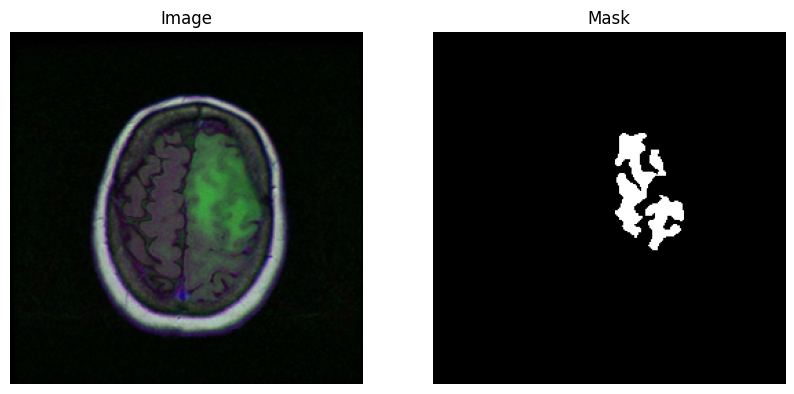

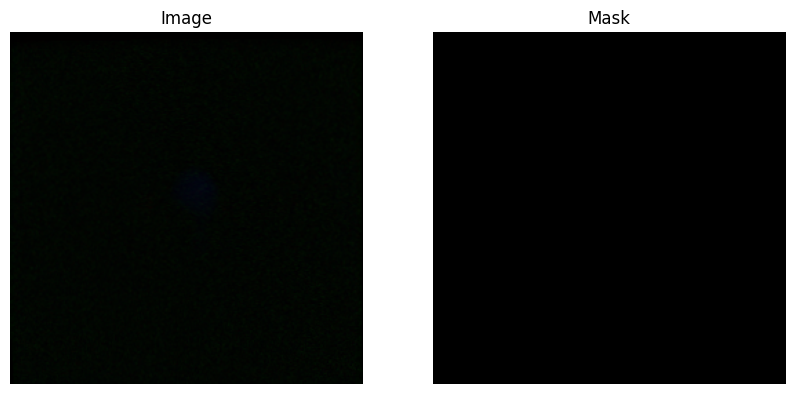

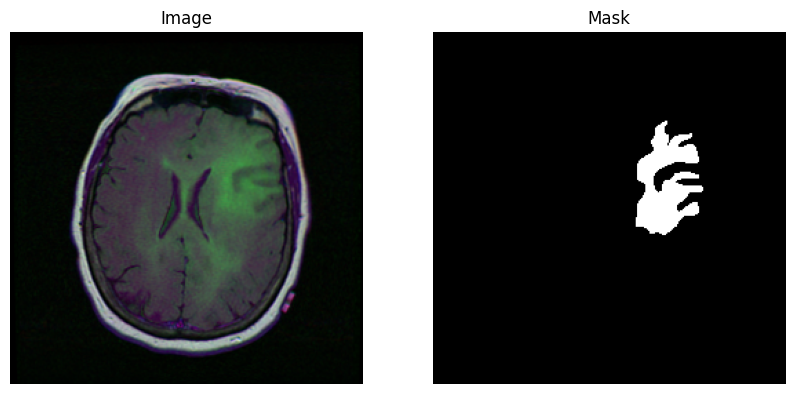

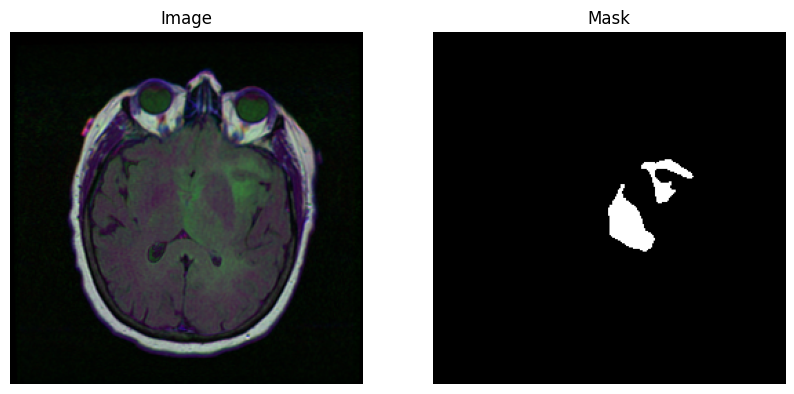

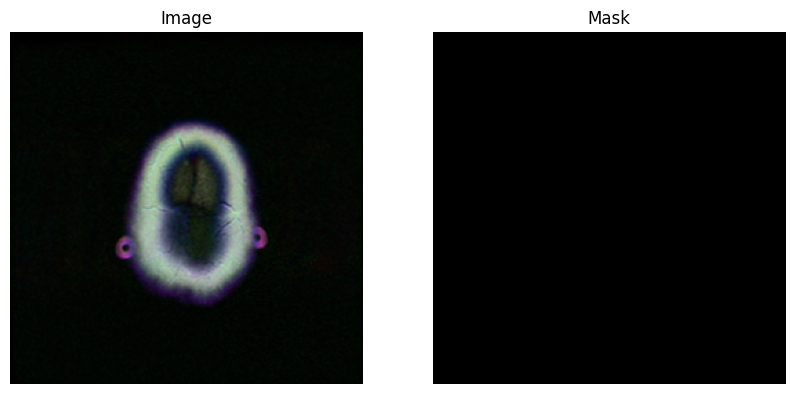

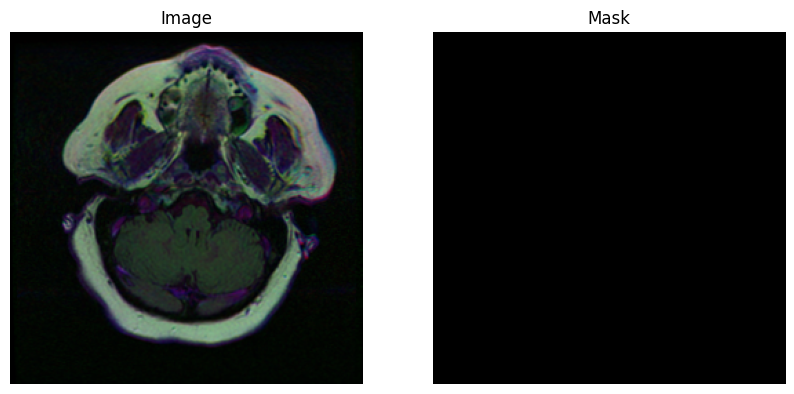

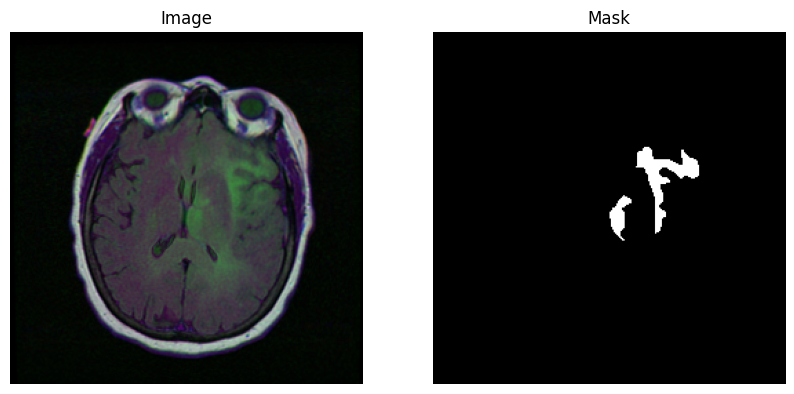

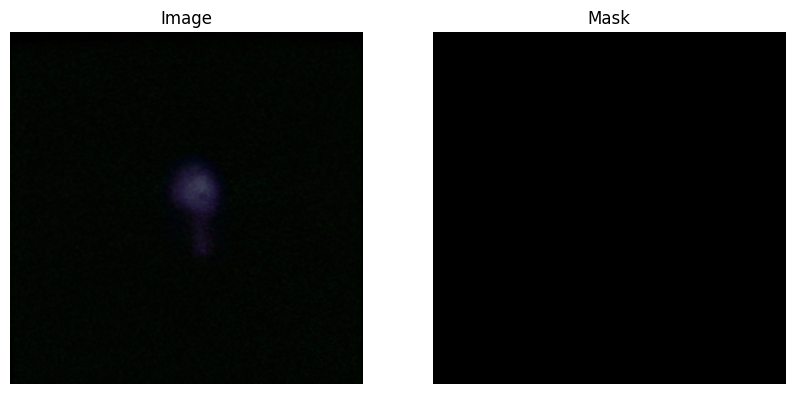

In [23]:
import cv2
import matplotlib.pyplot as plt

# Assuming full_df DataFrame
image_paths = df_merging.image_path.tolist()
mask_paths = df_merging.mask_path.tolist()

# Load and display the first image and its corresponding mask
def load_and_display(image_path, mask_path):
    image = cv2.imread(image_path, cv2.IMREAD_COLOR)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

    # Convert color image from BGR to RGB for matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title('Image')
    plt.imshow(image_rgb)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Mask')
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    plt.show()

# Example usage
for image_path , mask_path in zip(image_paths[:8], mask_paths[:8]):
    if image_paths and mask_paths:
        load_and_display(image_path, mask_path)

### 1.Distribution of Each Feature

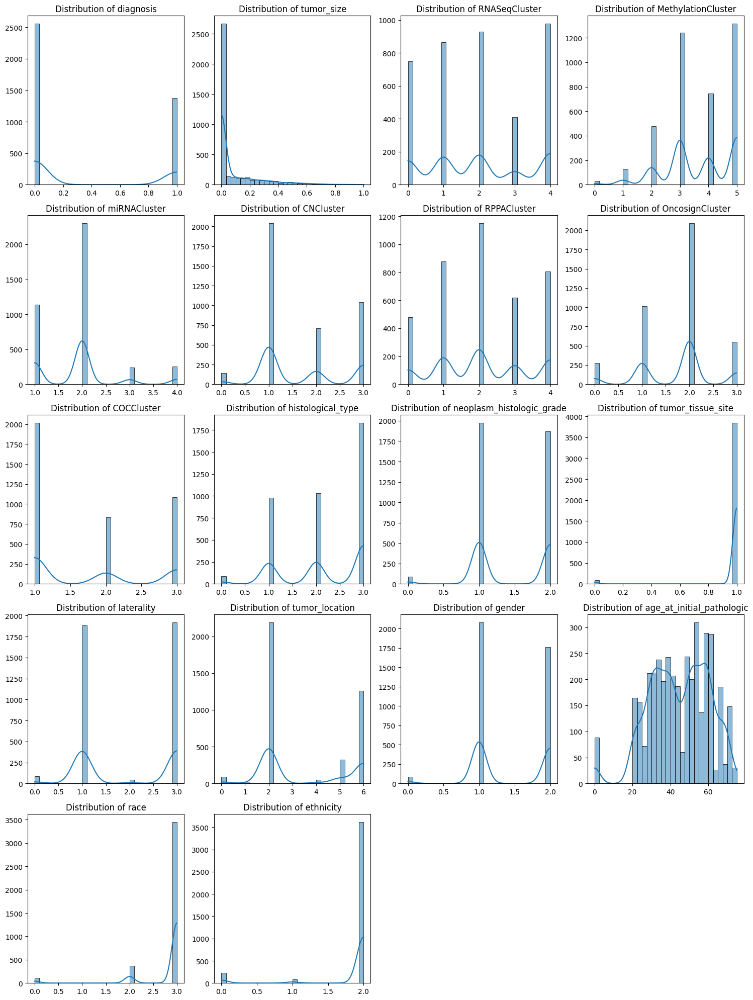

In [24]:
# Set the size of the plots
plt.figure(figsize=(15, 20))

# List of numerical features
numerical_features = [
    'diagnosis', 'tumor_size', 'RNASeqCluster', 'MethylationCluster', 'miRNACluster', 'CNCluster',
    'RPPACluster', 'OncosignCluster', 'COCCluster', 'histological_type', 'neoplasm_histologic_grade',
    'tumor_tissue_site', 'laterality', 'tumor_location', 'gender', 'age_at_initial_pathologic',
    'race', 'ethnicity'
]

# Plot histograms for each feature
for i, feature in enumerate(numerical_features, 1):
    plt.subplot(5, 4, i)
    sns.histplot(df_merging[feature], kde=True, bins=30)
    plt.title(f'Distribution of {feature}')
    plt.xlabel('')
    plt.ylabel('')

plt.tight_layout()
plt.show()

### 2. Pairwise Relationships

<Figure size 10000x15500 with 0 Axes>

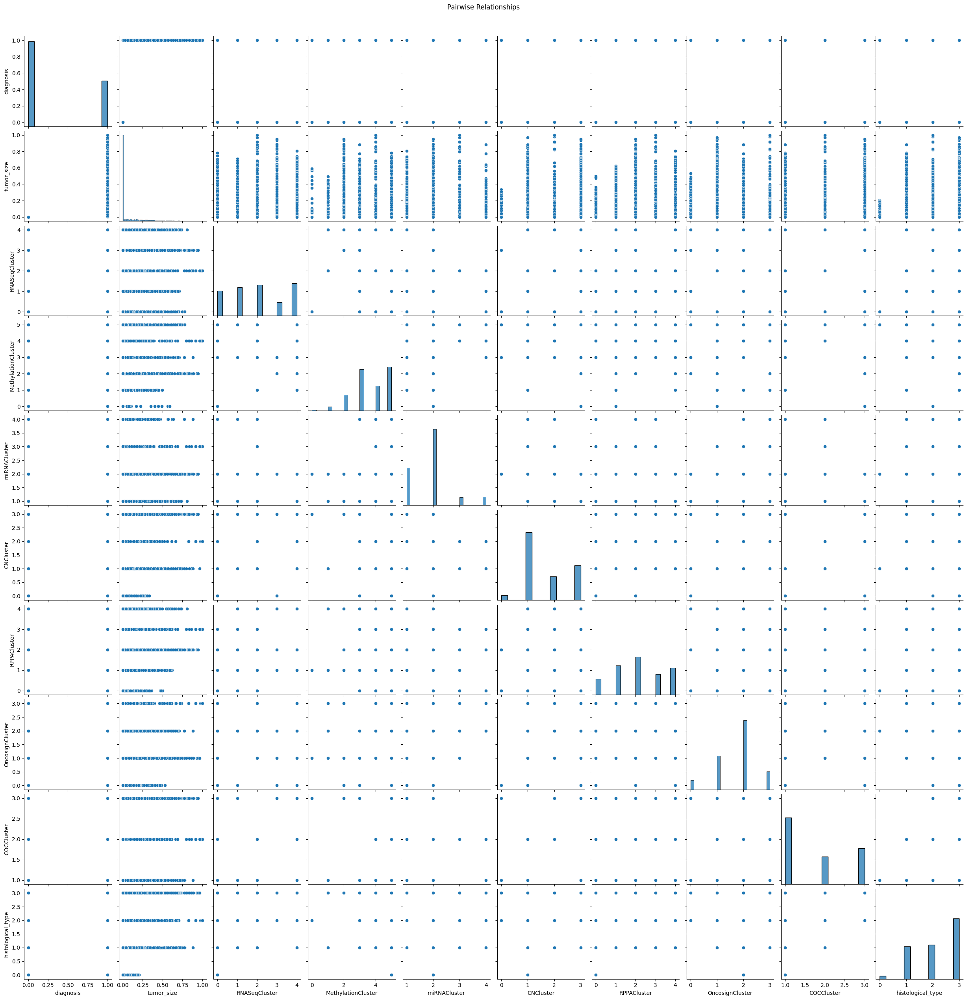

In [25]:
# Set the size of the plots
plt.figure(figsize=(100, 155))

# Pairplot (for a subset of features or sample of data)
sns.pairplot(df_merging[numerical_features[:10]])
plt.suptitle('Pairwise Relationships', y=1.02)
plt.show()

<Figure size 5000x5500 with 0 Axes>

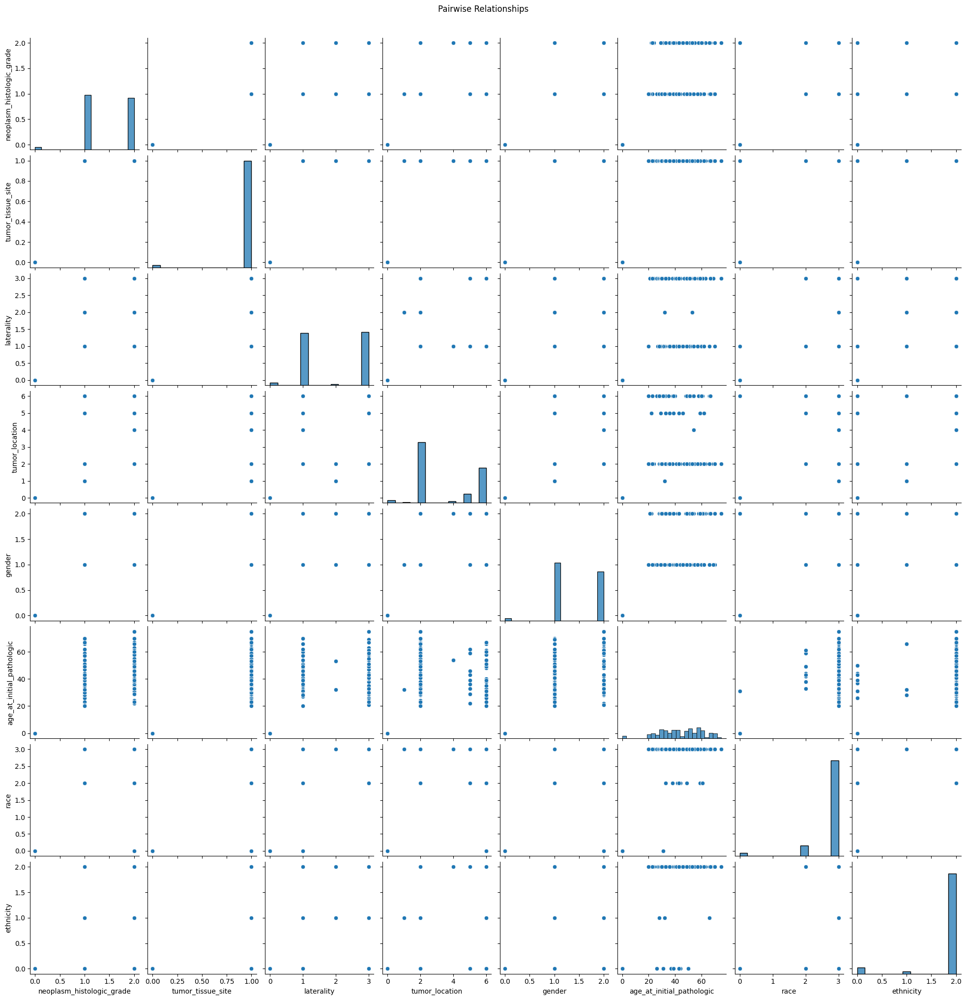

In [26]:
# Set the size of the plots
plt.figure(figsize=(50, 55))

# Pairplot (for a subset of features or sample of data)
sns.pairplot(df_merging[numerical_features[10:]])
plt.suptitle('Pairwise Relationships', y=1.02)
plt.show()

### 3.Correlation Matrix

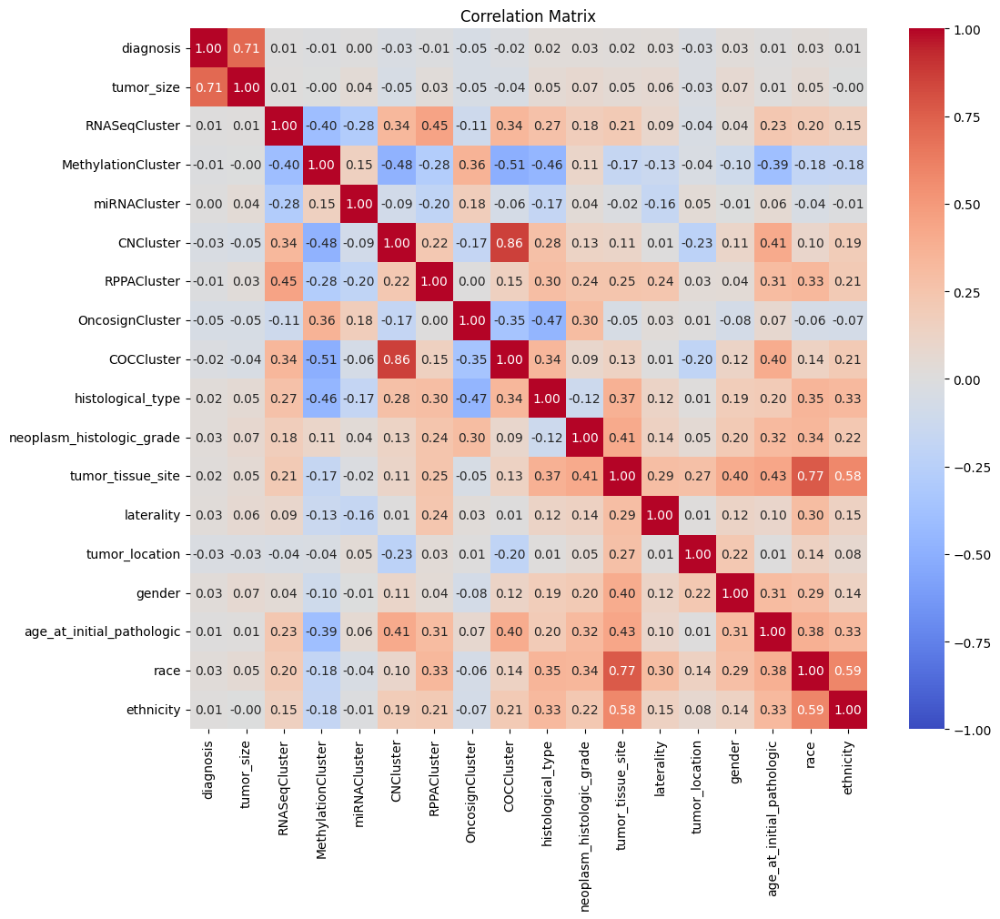

In [27]:
# Compute the correlation matrix
correlation_matrix = df_merging[numerical_features].corr()

# Plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

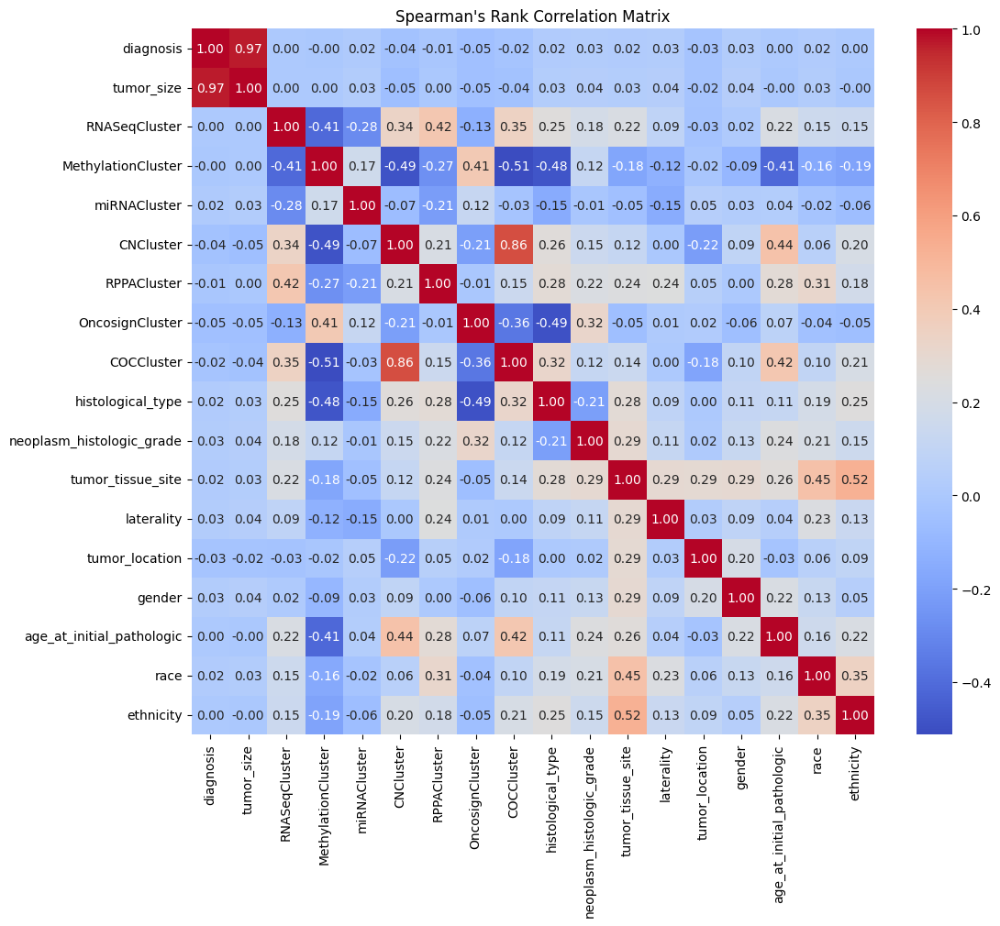

In [28]:
# Compute Spearman's rank correlation matrix
spearman_corr = df_merging[numerical_features].corr(method='spearman')

plt.figure(figsize=(12, 10))
sns.heatmap(spearman_corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Spearman\'s Rank Correlation Matrix')
plt.show()

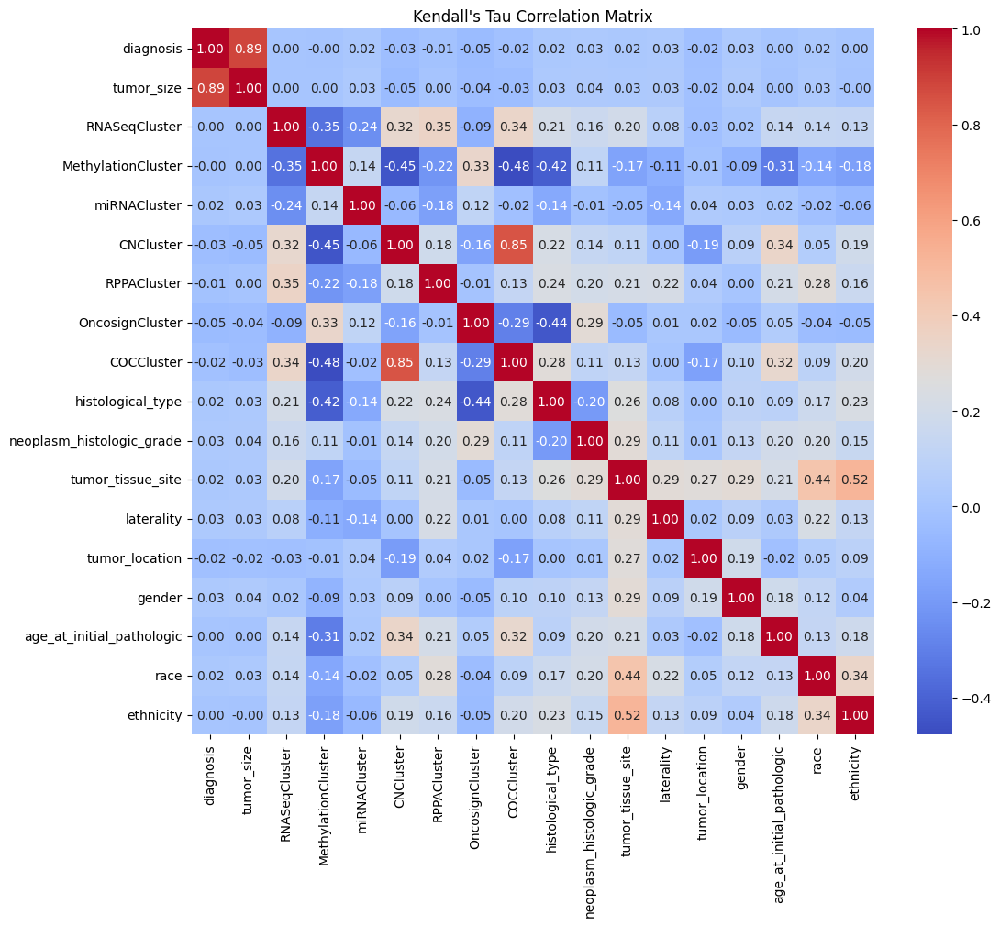

In [29]:
# Compute Spearman's rank correlation matrix
spearman_corr = df_merging[numerical_features].corr(method='kendall')

plt.figure(figsize=(12, 10))
sns.heatmap(spearman_corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Kendall\'s Tau Correlation Matrix')
plt.show()

### 4. Box Plots by Diagnosis

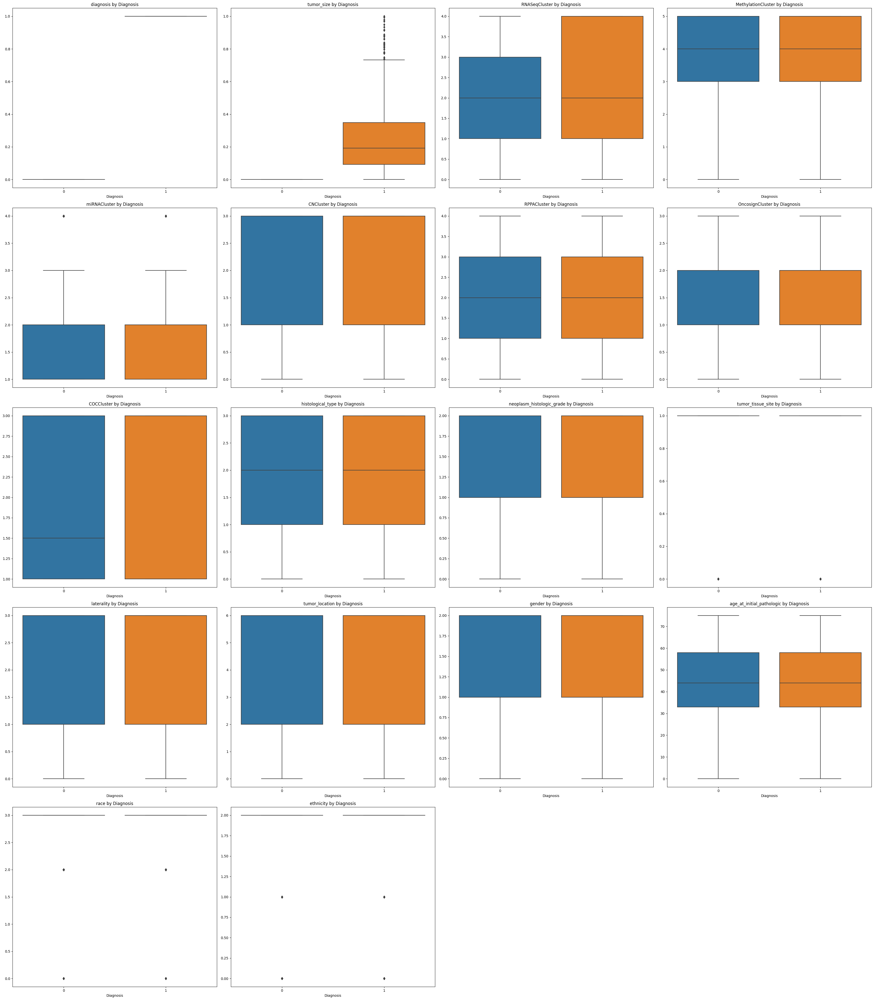

In [30]:
# Set the size of the plots
plt.figure(figsize=(35, 40))

# Plot box plots for each feature grouped by diagnosis
for i, feature in enumerate(numerical_features, 1):
    plt.subplot(5, 4, i)
    sns.boxplot(x='diagnosis', y=feature, data=df_merging)
    plt.title(f'{feature} by Diagnosis')
    plt.xlabel('Diagnosis')
    plt.ylabel('')

plt.tight_layout()
plt.show()

# Violin Plots for Feature Distributions by Diagnosis

We generate violin plots to visualize the distribution of each feature, grouped by the `diagnosis` label. Violin plots are useful for showing the density of the data across different values, providing a clearer view of how features are distributed between patients with and without tumors.

### Visualization Details

- **Figure Size**: The figure size is set to 15x20 inches to accommodate all plots clearly.
- **Plot Arrangement**: We use a 5x4 grid layout to display the violin plots for each feature.
- **Feature Labels**: Each plot is titled with the feature name and shows its distribution grouped by the diagnosis (`0` for no tumor, `1` for tumor).

### Code Explanation
- **`plt.figure(figsize=(15, 20))`**: Sets the size of the figure.
- **`plt.subplot(5, 4, i)`**: Creates a subplot in a 5x4 grid for each feature.
- **`sns.violinplot(x='diagnosis', y=feature, data=df_merging)`**: Plots the violin plot for the feature, grouped by diagnosis.
- **`plt.title(f'{feature} by Diagnosis')`**: Sets the title of each plot.
- **`plt.tight_layout()`**: Adjusts subplot parameters to give some padding and avoid overlap.
- **`plt.show()`**: Displays the plots.

These violin plots help in understanding the variation and distribution of features between different diagnostic categories, aiding in the interpretation of how features correlate with tumor presence.

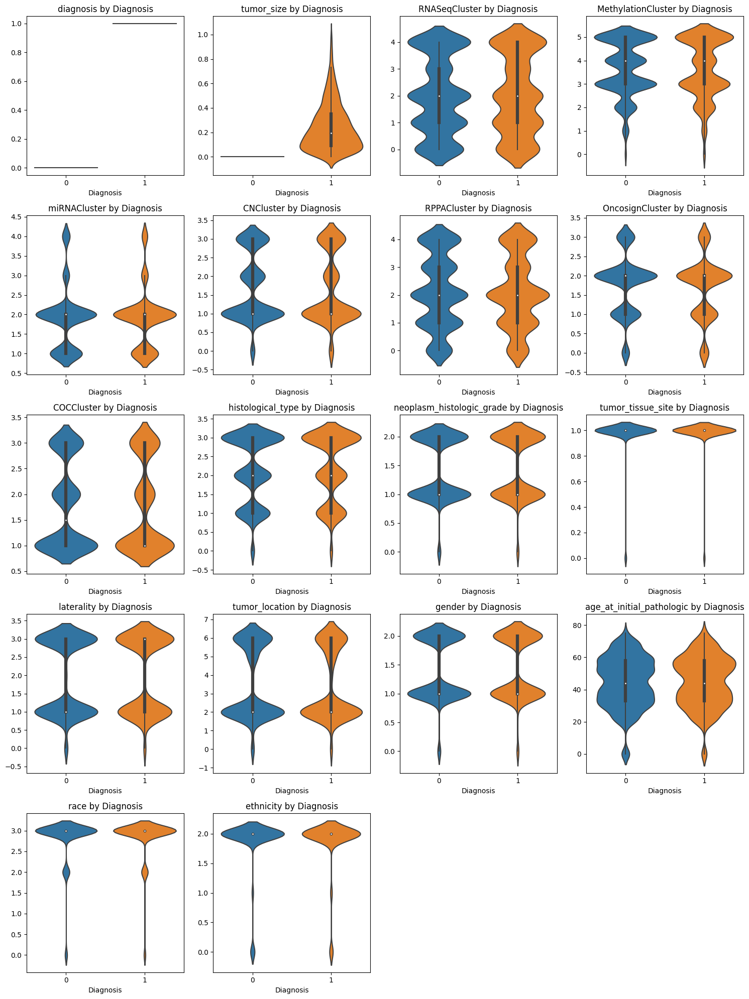

In [31]:
# Set the size of the plots
plt.figure(figsize=(15, 20))

# Plot violin plots for each feature grouped by diagnosis
for i, feature in enumerate(numerical_features, 1):
    plt.subplot(5, 4, i)
    sns.violinplot(x='diagnosis', y=feature, data=df_merging)
    plt.title(f'{feature} by Diagnosis')
    plt.xlabel('Diagnosis')
    plt.ylabel('')

plt.tight_layout()
plt.show()

# Conclusion

In this notebook, we conducted a thorough exploratory data analysis (EDA) of the brain MRI images and their associated genomic data. Through various visualizations and statistical analyses, we have gained insights into the distribution of features, their relationships, and how they correlate with the presence of tumors.

Key findings include:
- **Feature Distributions**: We observed the distribution of both genomic and clinical features, which helps in understanding their spread and potential variations between diagnostic groups.
- **Pairwise Relationships**: The pairwise plots revealed interactions between features, providing a view of how they relate to each other.
- **Correlation Analysis**: We computed and visualized correlation matrices to identify linear, monotonic, and ordinal relationships among features.
- **Violin Plots**: These plots illustrated how features vary between patients with and without tumors, highlighting potential markers for diagnosis.

This analysis forms a strong foundation for developing predictive models, as it uncovers patterns and relationships that can be leveraged for machine learning tasks.

## Next Steps

In the upcoming Part Two of this project, we will focus on:

1. **Model Training**:
   - **Segmentation Model**: Develop and train a segmentation model to identify and delineate tumor regions in MRI images.
   - **Classification Model**: Build and train a classification model to predict the presence or absence of tumors based on the features.

2. **Model Tuning**:
   - Perform hyperparameter tuning to optimize model performance.
   - Utilize techniques such as cross-validation to ensure robustness and generalization.

3. **Model Deployment**:
   - **API Development**: Create an API using Django to enable interaction with the models.
   - **Containerization**: Containerize the application using Docker to facilitate deployment and scalability.

4. **CI/CD**:
   - Implement Continuous Integration and Continuous Deployment (CI/CD) pipelines to automate testing and deployment processes.

5. **Experiment Tracking**:
   - Use MLflow for tracking experiments, model versions, and performance metrics to manage the model lifecycle effectively.

By following these steps, we aim to build, deploy, and maintain robust machine learning models that can accurately segment and classify brain MRI images, providing valuable insights for medical diagnostics.

In [32]:
!pip install datasets

In [33]:
!pip install monai

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 7.1 MB/s eta 0:00:0000:0100:01


In [34]:
import random
import os
import glob
import time
import warnings
import io

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
# import opendatasets as od
import datasets as dts

from PIL import Image
from IPython.display import clear_output
from tqdm.notebook import tqdm
from typing import Dict, List, Tuple
from statistics import mean


import torch
import monai
import cv2
import torchvision
import torch.optim.lr_scheduler as lr_scheduler
from torch import nn
from torch.utils.data import DataLoader
from torch.optim import Adam
from torchvision import transforms
from monai.transforms import Compose, NormalizeIntensityd
from monai.metrics import compute_iou
from sklearn.model_selection import train_test_split

from transformers import SamProcessor
from transformers import SamModel


/opt/conda/lib/python3.10/site-packages/ignite/handlers/checkpoint.py:16: DeprecationWarning: `TorchScript` support for functional optimizers is deprecated and will be removed in a future PyTorch release. Consider using the `torch.compile` optimizer instead.
  from torch.distributed.optim import ZeroRedundancyOptimizer


# CONFIGURATION

In [35]:
plt.style.use("dark_background")
warnings.filterwarnings("ignore", "is_categorical_dtype")
warnings.filterwarnings("ignore", "use_inf_as_na")

In [36]:
class CFG:
    # define paths
    TEST_PATH = "/kaggle/input/lgg-mri-segmentation/"
    TRAIN_PATH = "/kaggle/input/lgg-mri-segmentation/kaggle_3m/"
    
    DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    TRAIN_BATCH_SIZE = 2
    TEST_BATCH_SIZE = 1
    LEARNING_RATE = 1e-3
    WEIGHT_DECAY = 0
    EPOCH = 6

In [37]:
dataset_images = glob.glob(f"{CFG.TRAIN_PATH}**/*.tif")
dataset_images[:10]

['/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_45.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_56_mask.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_57.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_33.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_27.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_52.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_10.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_8_mask.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_34_mask.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_1986

In [38]:
def get_sample_patient_id(image_paths):
    return [(_.split('/')[-2:][0]) for _ in image_paths]

def get_sample_number(image_paths):
    sample_numbers = []
    is_mask = []

    for path in image_paths:
        path_list = path.split('/')[-2:][1].split('_')

        if 'mask.tif' in path_list:
            sample_numbers.append(int(path_list[-2]))
            is_mask.append(1)
        else:
            sample_numbers.append(int(path_list[-1].replace('.tif', '')))
            is_mask.append(0)

    return sample_numbers, is_mask

def build_df(image_paths):
    sample_numbers, mask_label = get_sample_number(image_paths)
    # create dataframe
    df = pd.DataFrame({
        'id'        : sample_numbers,
        'patient'   : get_sample_patient_id(image_paths),
        'image_path': image_paths,
        'is_mask'   : mask_label
    })

    # return df
    return df

In [39]:
# 0 = image
# 1 = mask

dataset_df = (
    build_df(dataset_images)
    .sort_values(by=['id', 'patient', 'image_path'])
    .reset_index(drop=True)
)

dataset_df

,id,patient,image_path,is_mask
0,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
1,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
2,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
3,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
4,1,TCGA_CS_4943_20000902,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
...,...,...,...,...
7853,87,TCGA_HT_A61B_19991127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
7854,88,TCGA_HT_A61A_20000127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
7855,88,TCGA_HT_A61A_20000127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
7856,88,TCGA_HT_A61B_19991127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0


In [40]:
# images_df: for images
# mask_df: for masks

grouped_df = dataset_df.groupby(by='is_mask')
images_df, mask_df = (
    grouped_df.get_group(0).drop('is_mask', axis=1).reset_index(drop=True),
    grouped_df.get_group(1).drop('is_mask', axis=1).reset_index(drop=True)
)

mask_df = mask_df.rename({'image_path': 'mask_path'}, axis=1)

mask_df.head()

,id,patient,mask_path
0,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
1,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
2,1,TCGA_CS_4943_20000902,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
3,1,TCGA_CS_4944_20010208,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
4,1,TCGA_CS_5393_19990606,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...


In [41]:
def _load(image_path, as_tensor=True):
    image = Image.open(image_path)
    return np.array(image).astype(np.float32) / 255.

def generate_label(mask_path, load_fn):
    mask = load_fn(mask_path)
    if mask.max() > 0:
        return 1 # Brain Tumor Present
    return 0 # Normal

In [42]:
# merge images dataframe and masks dataframe
ds = images_df.merge(
    mask_df,
    on=['id', 'patient'],
    how='left'
)

# generate MRI Label
ds['diagnosis'] = [generate_label(_, _load) for _ in tqdm(ds['mask_path'])]
ds.head()

  0%|          | 0/3929 [00:00<?, ?it/s]

,id,patient,image_path,mask_path,diagnosis
0,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
1,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
2,1,TCGA_CS_4943_20000902,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
3,1,TCGA_CS_4944_20010208,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
4,1,TCGA_CS_5393_19990606,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0


In [43]:
# filter valid masks and choose only 1360
ds = ds[ds['diagnosis']==1]
ds = ds.head(1360)

# Splitting Dataset

In [44]:
image_train, image_test, mask_train, mask_test = train_test_split(
ds['image_path'], ds['mask_path'], test_size = 0.10)

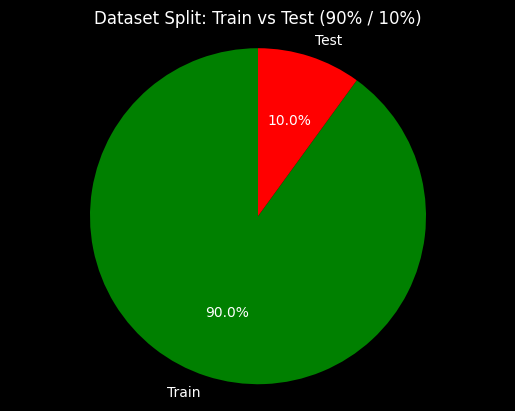

In [45]:
import numpy as np
import matplotlib.pyplot as plt

# Slices will be ordered and plotted counter-clockwise
labels = ['Train', 'Test']
sizes = [90, 10]
colors = ['green', 'red']  # Colors for the pie chart

fig, ax = plt.subplots()
ax.pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=90)

# Adding title
ax.set_title('Dataset Split: Train vs Test (90% / 10%)')

# Ensuring equal aspect ratio so the pie is drawn as a circle
ax.axis('equal')

plt.show()


# Combining and Displaying Image and Mask Paths for Training

In [46]:
train_df = pd.concat([image_train, mask_train], axis=1).reset_index(drop=True)
train_dataset = dts.Dataset.from_pandas(train_df)
train_dataset

Dataset({
    features: ['image_path', 'mask_path'],
    num_rows: 1224
})

# Combining and Displaying Image and Mask Paths for Testing

In [47]:
test_df = pd.concat([image_test, mask_test], axis=1).reset_index(drop=True)
test_dataset = dts.Dataset.from_pandas(test_df)
test_dataset

Dataset({
    features: ['image_path', 'mask_path'],
    num_rows: 136
})

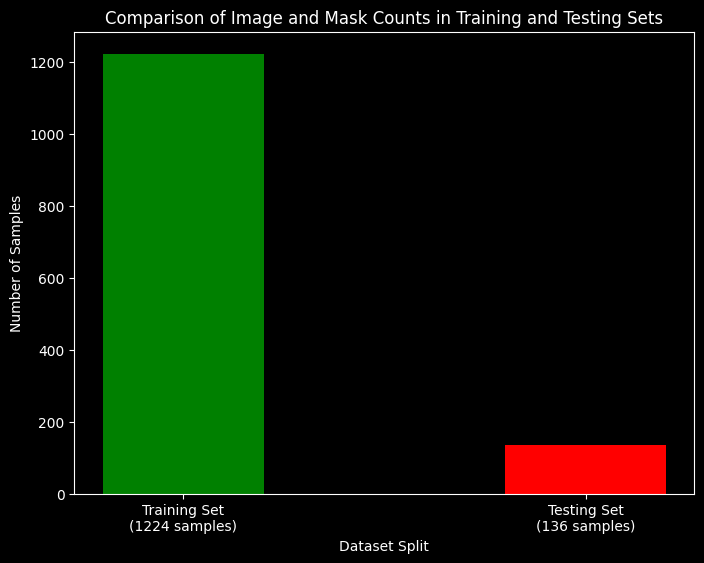

In [48]:
import matplotlib.pyplot as plt

# Data: number of samples in training and testing sets
train_size = len(train_dataset)
test_size = len(test_dataset)

# Creating the bar chart
labels = [f'Training Set\n({train_size} samples)', f'Testing Set\n({test_size} samples)']
counts = [train_size, test_size]

x = range(len(labels))

plt.figure(figsize=(8, 6))

# Plot bars for image and mask splits
plt.bar(x, counts, width=0.4, color=['green', 'red'], align='center')

# Adding labels and title
plt.xlabel('Dataset Split')
plt.ylabel('Number of Samples')
plt.title('Comparison of Image and Mask Counts in Training and Testing Sets')
plt.xticks(x, labels)

# Show the plot
plt.show()


In [49]:
def transform(data):
    # Load the image
    with open(data['image_path'], 'rb') as f:
        image = Image.open(io.BytesIO(f.read())).convert('RGB')
    data['image'] = image

    with open(data['mask_path'], 'rb') as f:
        mask = Image.open(io.BytesIO(f.read())).convert('L') # to grayscale
    data['mask'] = mask

    return data

# Clean Up Train Dataset Columns

In [50]:
train_dataset = train_dataset.map(transform, remove_columns=['image_path','mask_path'])

Map:   0%|          | 0/1224 [00:00<?, ? examples/s]

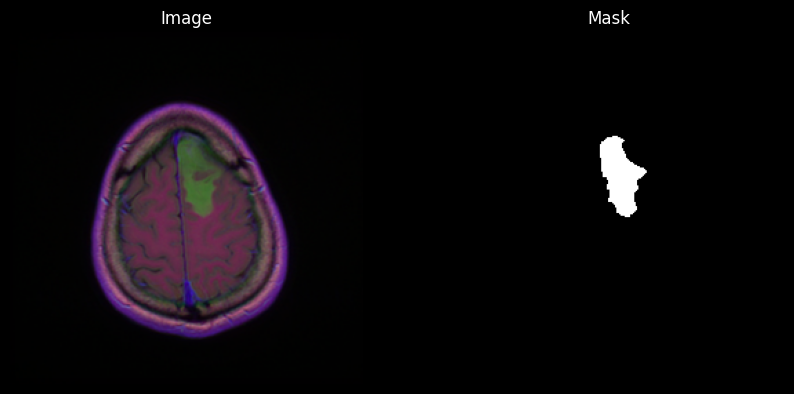

In [51]:
example = train_dataset[40]
img = example['image']
msk = example['mask']

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))

# Display Image
plt.subplot(1, 2, 1)
plt.title('Image')
plt.imshow(img)
plt.axis('off')

# Display Mask
plt.subplot(1, 2, 2)
plt.title('Mask')
plt.imshow(msk, cmap='gray')
plt.axis('off')

plt.show()

# Clean Up Test Dataset Columns

In [52]:
test_dataset = test_dataset.map(transform, remove_columns=['image_path','mask_path'])

Map:   0%|          | 0/136 [00:00<?, ? examples/s]

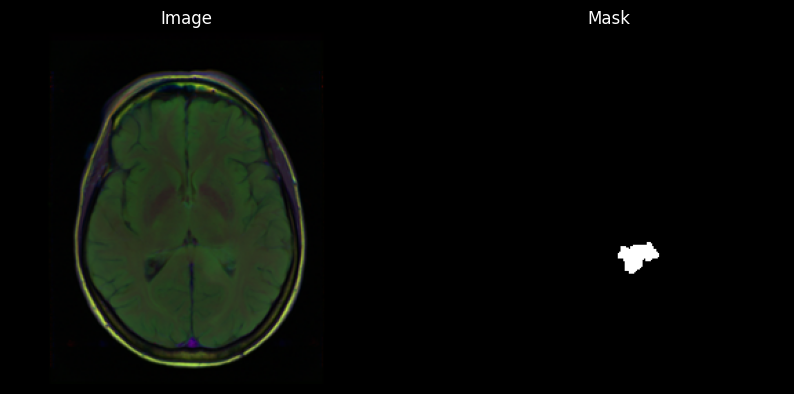

In [53]:
import matplotlib.pyplot as plt

sample = test_dataset[0]
image = sample['image']
mask = sample['mask']

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('Image')
plt.imshow(image)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Mask')
plt.imshow(mask, cmap='gray')
plt.axis('off')

plt.show()


# Pixel Value Range Analysis for Image and Mask

In [54]:
np.array(msk).max(), np.array(msk).min(), np.array(img).max(), np.array(img).min()

(255, 0, 176, 0)

# Display Mask with Optional Random or Fixed Color

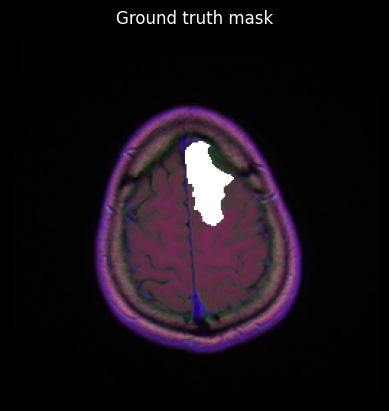

In [55]:
import numpy as np
import matplotlib.pyplot as plt

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

# Example usage
fig, axes = plt.subplots()

# Assuming 'img' and 'example["mask"]' are defined elsewhere
axes.imshow(np.array(img))  # Display the image
ground_truth_seg = np.array(example["mask"])  # Load the ground truth mask
show_mask(ground_truth_seg, axes)  # Overlay the mask

axes.title.set_text("Ground truth mask")
axes.axis("off")

plt.show()


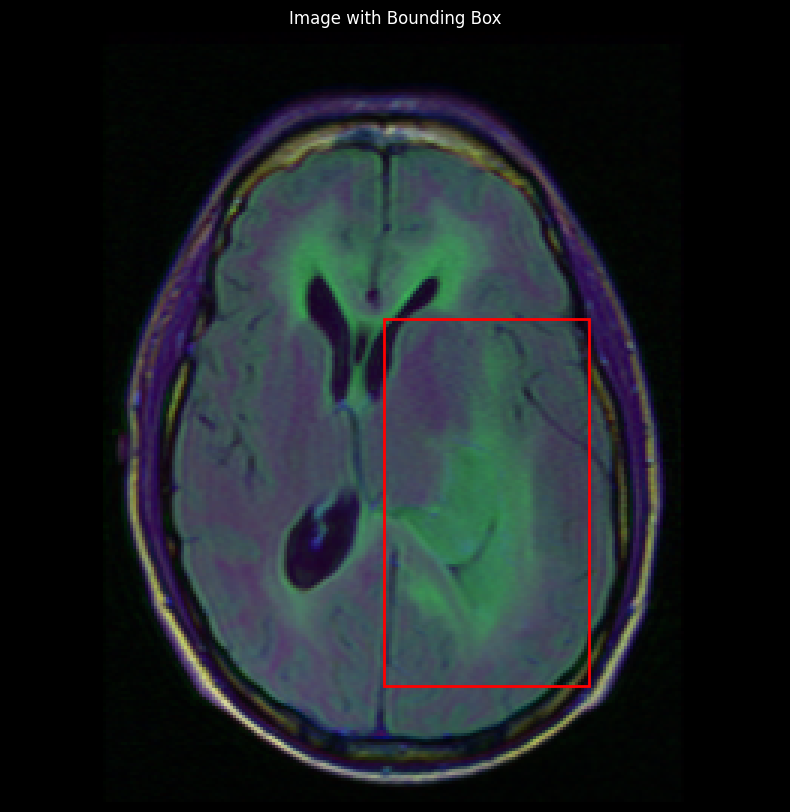

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def get_bounding_box(ground_truth_map):
    '''
    This function creates varying bounding box coordinates based on the segmentation contours as a prompt for the SAM model.
    The padding is random int values between 5 and 20 pixels.
    '''

    if len(np.unique(ground_truth_map)) > 1:
        # Get bounding box from mask
        y_indices, x_indices = np.where(ground_truth_map > 0)
        x_min, x_max = np.min(x_indices), np.max(x_indices)
        y_min, y_max = np.min(y_indices), np.max(y_indices)

        # Add perturbation to bounding box coordinates
        H, W = ground_truth_map.shape
        x_min = max(0, x_min - np.random.randint(5, 20))
        x_max = min(W, x_max + np.random.randint(5, 20))
        y_min = max(0, y_min - np.random.randint(5, 20))
        y_max = min(H, y_max + np.random.randint(5, 20))

        bbox = [x_min, y_min, x_max, y_max]

        return bbox
    else:
        return [0, 0, 256, 256]

def plot_image_with_bbox(image_path, mask_path):
    # Load image and mask
    image = Image.open(image_path)
    mask = Image.open(mask_path).convert('L')  # Convert mask to grayscale
    
    # Convert image and mask to numpy arrays
    img_array = np.array(image)
    mask_array = np.array(mask)

    # Get bounding box
    bbox = get_bounding_box(mask_array)
    
    # Plot the image and the bounding box
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(img_array)
    
    # Draw bounding box
    rect = plt.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],
                         linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
    
    ax.set_title('Image with Bounding Box')
    ax.axis('off')  # Hide axes
    plt.show()

# Example usage
plot_image_with_bbox('/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_CS_5393_19990606/TCGA_CS_5393_19990606_12.tif', 
                     '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_CS_5393_19990606/TCGA_CS_5393_19990606_12_mask.tif')


In [57]:
class SAMDataset(torch.utils.data.Dataset):
  def __init__(self, dataset, processor):
    self.dataset = dataset
    self.processor = processor
    #self.transforms = transforms = Compose([NormalizeIntensityd(divisor=255, keys=['mask'])])

  def __len__(self):
    return len(self.dataset)

  def __getitem__(self, idx):
    item = self.dataset[idx]
    image = item["image"]
    ground_truth_mask = np.array(item["mask"])
    # ground_truth_mask = item["mask"]

    # get bounding box prompt
    prompt = get_bounding_box(ground_truth_mask)

    # prepare image and prompt for the model
    inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")

    # remove batch dimension which the processor adds by default
    inputs = {k:v.squeeze(0) for k,v in inputs.items()}

    # add ground truth segmentation
    inputs["ground_truth_mask"] = ground_truth_mask/255

    return inputs

In [58]:
processor = SamProcessor.from_pretrained("facebook/sam-vit-base", do_normalize=False)

preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

In [59]:
train_sam_ds = SAMDataset(dataset=train_dataset, processor=processor)

In [60]:
exmpl = train_sam_ds[10]
for k, v in exmpl.items():
    print(k, v.shape)


pixel_values torch.Size([3, 1024, 1024])
original_sizes torch.Size([2])
reshaped_input_sizes torch.Size([2])
input_boxes torch.Size([1, 4])
ground_truth_mask (256, 256)


In [61]:
train_dataloader = DataLoader(train_sam_ds, batch_size=CFG.TRAIN_BATCH_SIZE, shuffle=False)

In [62]:
batch = next(iter(train_dataloader))
for k,v in batch.items():
  print(k,v.shape)

pixel_values torch.Size([2, 3, 1024, 1024])
original_sizes torch.Size([2, 2])
reshaped_input_sizes torch.Size([2, 2])
input_boxes torch.Size([2, 1, 4])
ground_truth_mask torch.Size([2, 256, 256])


In [63]:
train_df.shape

(1224, 2)

# Modeling


In [64]:
model = SamModel.from_pretrained("facebook/sam-vit-base")

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/375M [00:00<?, ?B/s]

In [65]:
# Note: Hyperparameter tuning could improve performance here
optimizer = Adam(model.mask_decoder.parameters(), lr=CFG.LEARNING_RATE, weight_decay=CFG.WEIGHT_DECAY)
seg_loss = monai.losses.FocalLoss(reduction='mean')

In [66]:
num_epochs = CFG.EPOCH

device = CFG.DEVICE
model.to(device)

model.train()

epoch_losses = []
epoch_ious = []
# epoch_preds = []
# epoch_actls = []

for epoch in range(num_epochs):
    print(f'EPOCH: {epoch}')
    # menyimpan losses di setiap batch
    batch_losses = []
    # menyimpan iou di setiap batch
    batch_ious = []

    for i, batch in enumerate(tqdm(train_dataloader)):

      # forward pass
      outputs = model(pixel_values=batch["pixel_values"].to(device),
                      input_boxes=batch["input_boxes"].to(device),
                      multimask_output=False)

      # process the output
      predicted_masks = outputs.pred_masks.squeeze(1) # perlu diubah ke sigmoid
      ground_truth_masks = batch["ground_truth_mask"].float().to(device)

      sam_masks_prob = torch.sigmoid(predicted_masks)
      sam_masks_prob = sam_masks_prob.squeeze()
      sam_masks = (sam_masks_prob > 0.5)

      # compute loss
      loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))
      batch_losses.append(loss.item())
      # batch_preds.append(predicted_masks)
      # batch_actls.append(ground_truth_masks.unsqueeze(1))

      # compute iou: return 2 values: 1 for each batch
      ious = compute_iou(sam_masks.unsqueeze(1),
                        ground_truth_masks.unsqueeze(1), ignore_empty=False)
      batch_ious.append(ious.mean())

      '''
      clear_output(wait=True)

      fig, axs = plt.subplots(1, 3)
      xmin, ymin, xmax, ymax = get_bounding_box(batch['ground_truth_mask'][0])
      rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=1, edgecolor='r', facecolor='none')

      axs[0].set_title('Input Image')
      axs[0].imshow(batch["pixel_values"][0,1], cmap='gray')
      axs[0].axis('off')

      axs[1].set_title('Actual Mask')
      axs[1].imshow(batch['ground_truth_mask'][0], cmap='copper')
      axs[1].add_patch(rect)
      axs[1].axis('off')

      # apply sigmoid
      medsam_seg_prob = torch.sigmoid(outputs.pred_masks[0].squeeze(1))

      # convert soft mask to hard mask
      medsam_seg_prob = medsam_seg_prob.detach().cpu().numpy().squeeze()
      medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)

      axs[2].set_title('Predicted Mask')
      # axs[2].imshow(predicted_masks[0].cpu().detach().numpy().reshape(256,256,1)*255, cmap='copper')
      axs[2].imshow(medsam_seg, cmap='copper')
      axs[2].axis('off')

      plt.tight_layout()
      plt.show()
      '''

      # backward pass (compute gradients of parameters w.r.t. loss)
      optimizer.zero_grad()
      loss.backward()

      # optimize
      optimizer.step()

      if torch.cuda.is_available():
        torch.cuda.empty_cache()

    # epoch_preds.append(batch_preds)
    # epoch_actls.append(batch_actls)

    mean_loss = mean(batch_losses)
    epoch_losses.append(mean_loss)
    print(f'Mean loss: {mean_loss}')

    mean_iou = mean([t.cpu().item() for t in batch_ious])
    epoch_ious.append(mean_iou)
    print(f'Mean IoU: {mean_iou}')

# setiap batch: IoU-nya adalah rata2 dari 2 IoU (ada 2 batch size)
# setiap epoch: rata-rata dari IoU setiap batch

EPOCH: 0


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.02714758752685442
Mean IoU: 0.48588482230520136
EPOCH: 1


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005993828661755044
Mean IoU: 0.6276341792031684
EPOCH: 2


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005397099868228562
Mean IoU: 0.6533305104334954
EPOCH: 3


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.0053104169619592285
Mean IoU: 0.6573434465315978
EPOCH: 4


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005021695817346697
Mean IoU: 0.6669572275055853
EPOCH: 5


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.0049036049880954785
Mean IoU: 0.6693586586834559


In [67]:
sam_masks.shape

torch.Size([2, 256, 256])

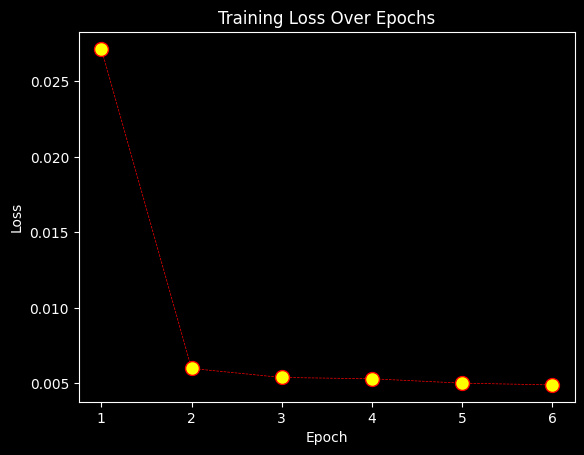

In [75]:
plt.plot(np.arange(1, CFG.EPOCH + 1), epoch_losses, 
    linewidth=0.5,
    linestyle='--',
    color='r',
    marker='o',
    markersize=10,
    markerfacecolor='yellow')
 
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs')

plt.show()


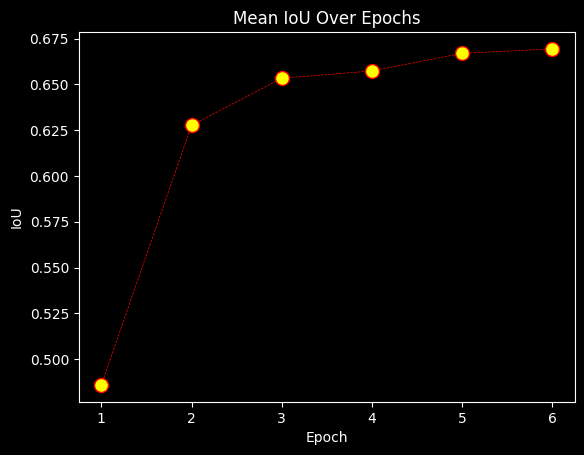

In [79]:
plt.plot(np.arange(1, CFG.EPOCH + 1), epoch_ious,
    linewidth=0.5,
    linestyle='--',
    color='r',
    marker='o',
    markersize=10,
    markerfacecolor='yellow')

plt.xlabel('Epoch')
plt.ylabel('IoU')
plt.title('Mean IoU Over Epochs')

plt.show()


In [80]:
import pandas as pd
import numpy as np
from tabulate import tabulate

# Define the updated data
epoch_losses = [0.02714758752685442, 0.005993828661755044, 0.005397099868228562, 
                0.0053104169619592285, 0.005021695817346697, 0.0049036049880954785]
epoch_ious = [0.48588482230520136, 0.6276341792031684, 0.6533305104334954, 
              0.6573434465315978, 0.6669572275055853, 0.6693586586834559]
num_epochs = len(epoch_losses)

# Create a DataFrame with the results
results_df = pd.DataFrame({
    'Epoch': np.arange(1, num_epochs + 1),
    'Loss': epoch_losses,
    'IoU': epoch_ious
})

# Display the summary table with lines
print(tabulate(results_df, headers='keys', tablefmt='grid'))

# Optional: Save to a CSV file
# results_df.to_csv('training_summary.csv', index=False)


+----+---------+------------+----------+
|    |   Epoch |       Loss |      IoU |
+====+=========+============+==========+
|  0 |       1 | 0.0271476  | 0.485885 |
+----+---------+------------+----------+
|  1 |       2 | 0.00599383 | 0.627634 |
+----+---------+------------+----------+
|  2 |       3 | 0.0053971  | 0.653331 |
+----+---------+------------+----------+
|  3 |       4 | 0.00531042 | 0.657343 |
+----+---------+------------+----------+
|  4 |       5 | 0.0050217  | 0.666957 |
+----+---------+------------+----------+
|  5 |       6 | 0.0049036  | 0.669359 |
+----+---------+------------+----------+


# Inference

# Creating a Test Dataloader

In [81]:
# create test dataloader
test_sam_ds = SAMDataset(test_dataset, processor=processor)
test_dataloader = DataLoader(test_sam_ds, batch_size=CFG.TEST_BATCH_SIZE, shuffle=False)

  0%|          | 0/136 [00:00<?, ?it/s]

IoU: tensor([[0.4839]])


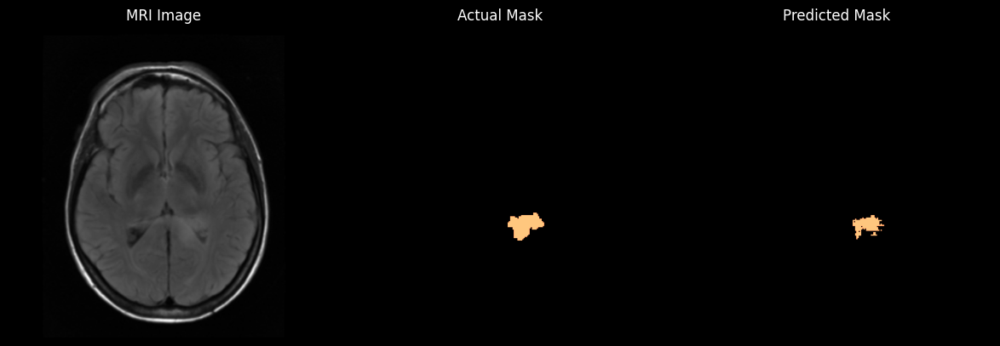

IoU: tensor([[0.5777]])


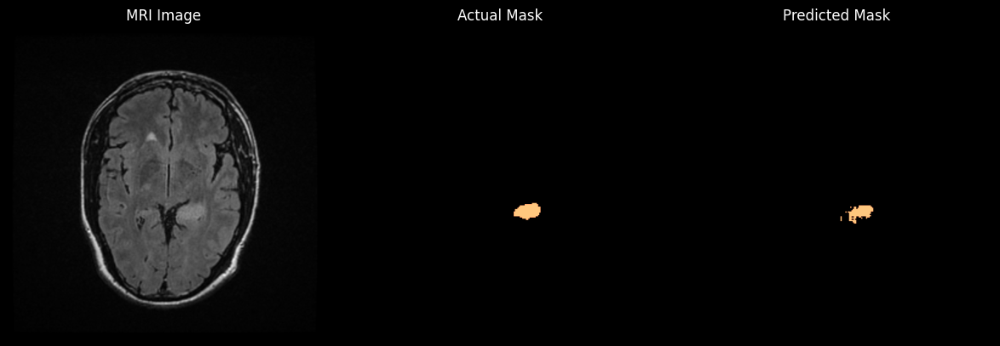

IoU: tensor([[0.6029]])


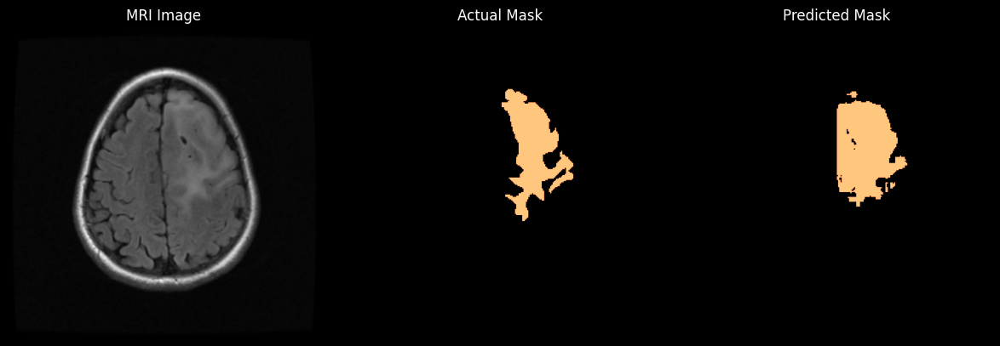

IoU: tensor([[0.9357]])


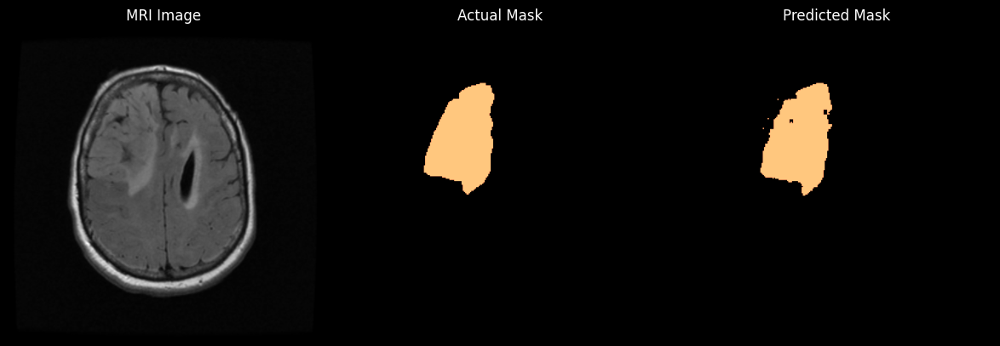

IoU: tensor([[0.9265]])


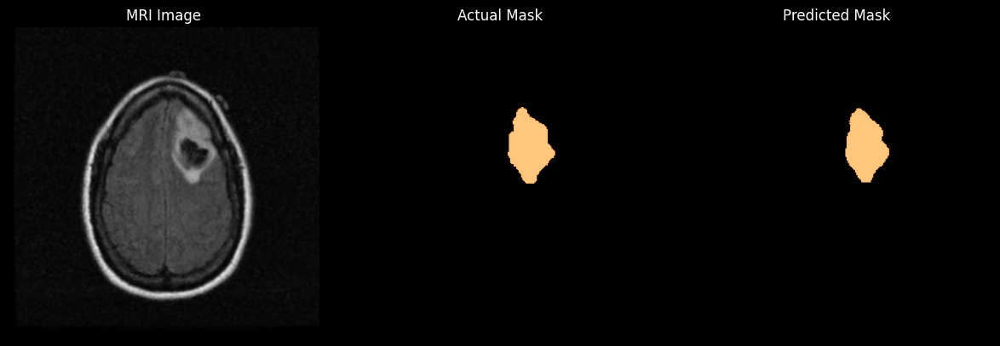

IoU: tensor([[0.6093]])


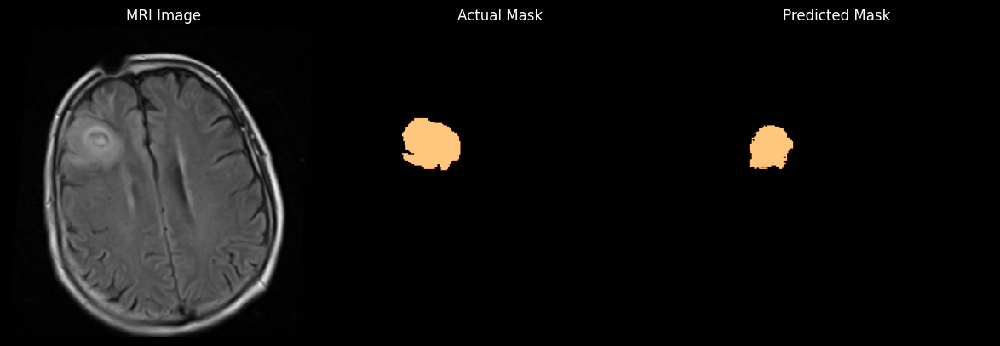

IoU: tensor([[0.3233]])


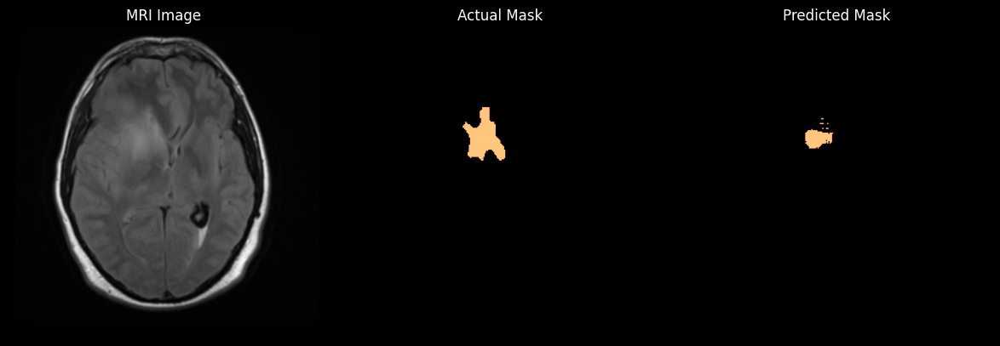

IoU: tensor([[0.8905]])


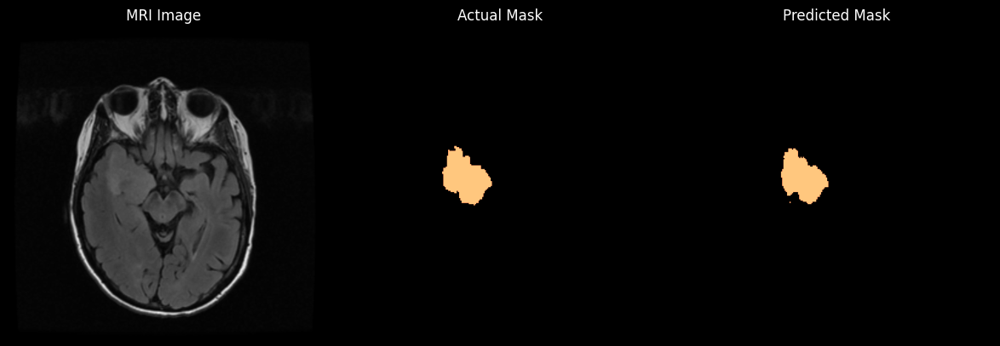

IoU: tensor([[0.4823]])


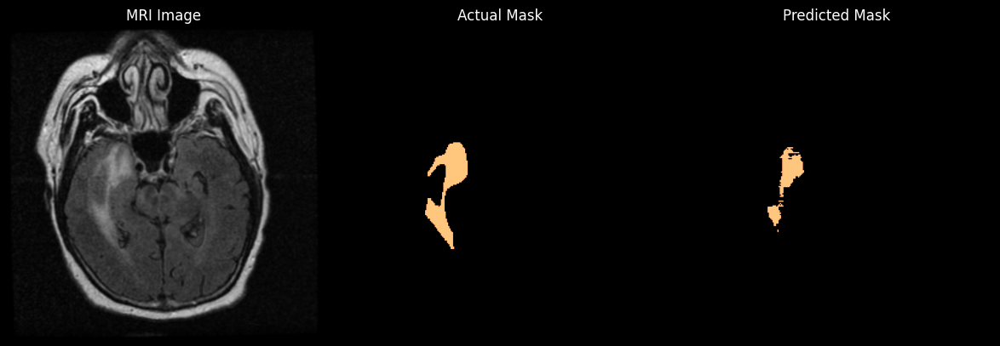

IoU: tensor([[0.8280]])


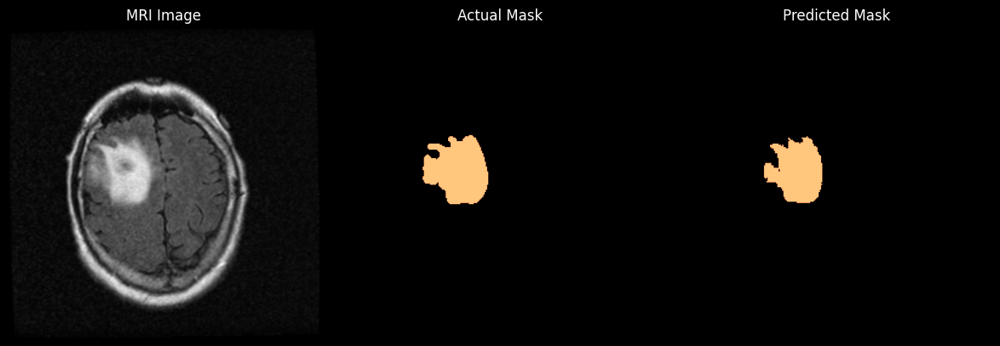

IoU: tensor([[0.5272]])


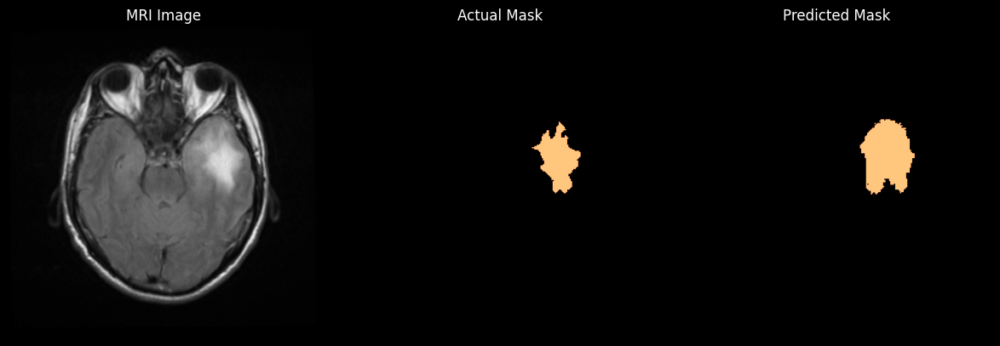

IoU: tensor([[0.8043]])


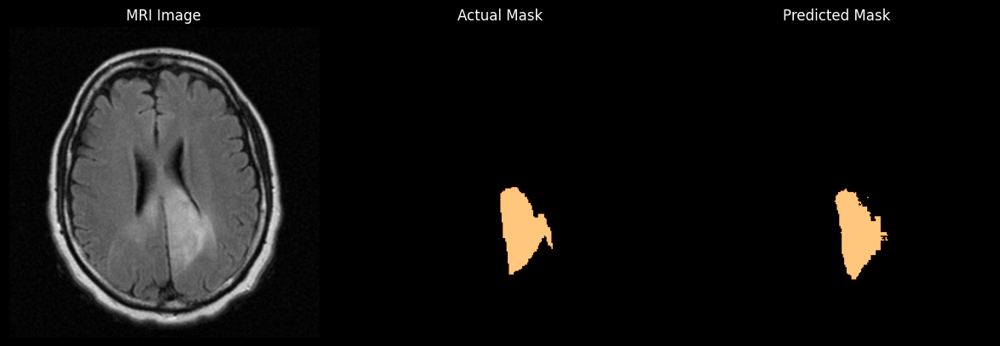

IoU: tensor([[0.8918]])


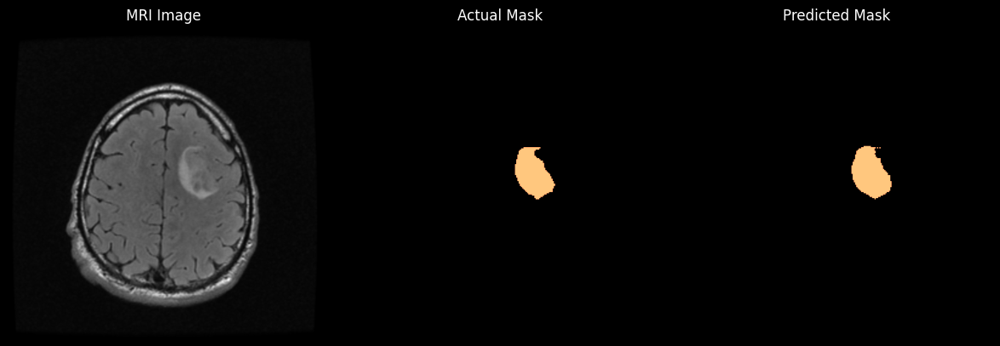

IoU: tensor([[0.8977]])


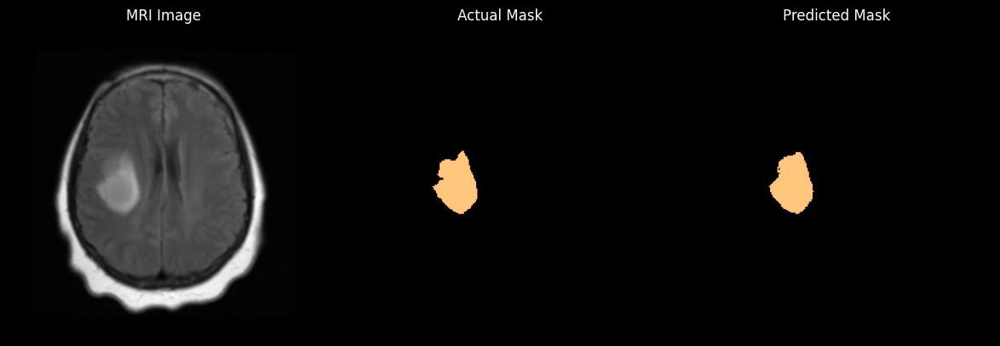

IoU: tensor([[0.8246]])


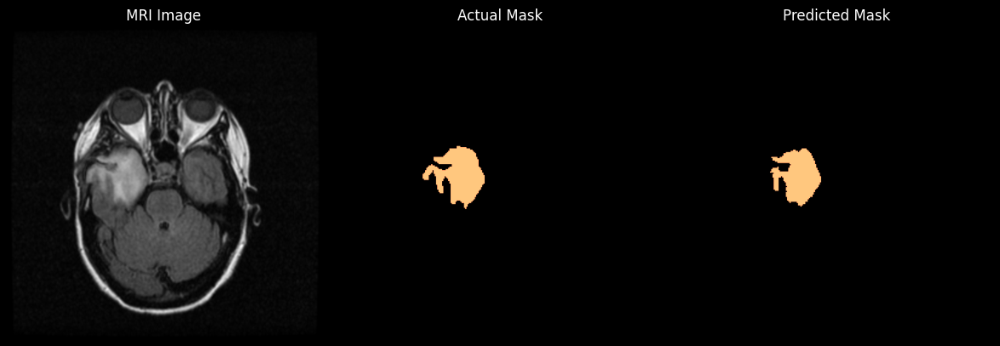

IoU: tensor([[0.4690]])


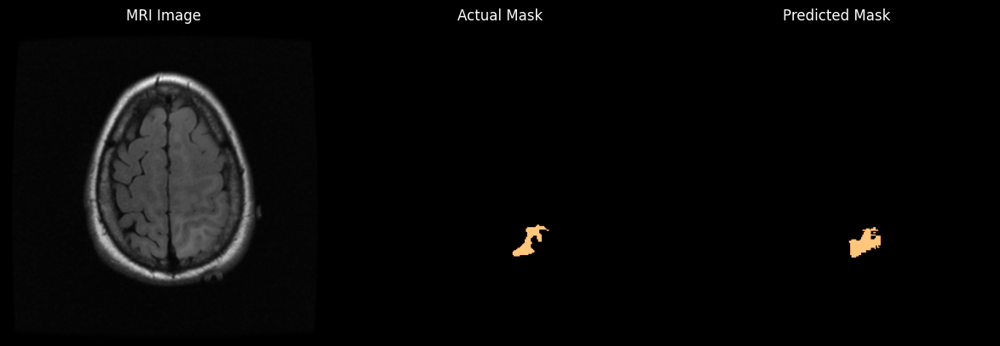

IoU: tensor([[0.9265]])


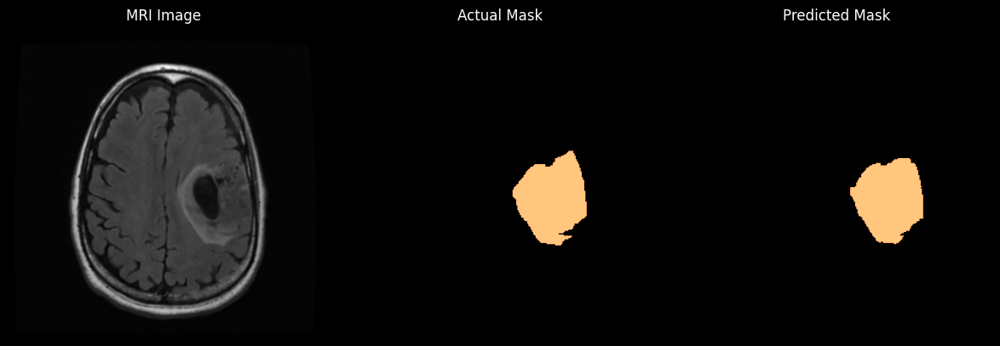

IoU: tensor([[0.8655]])


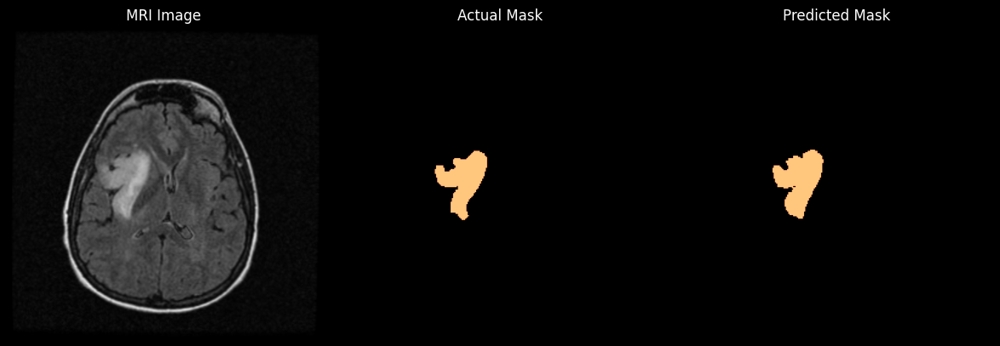

IoU: tensor([[0.5212]])


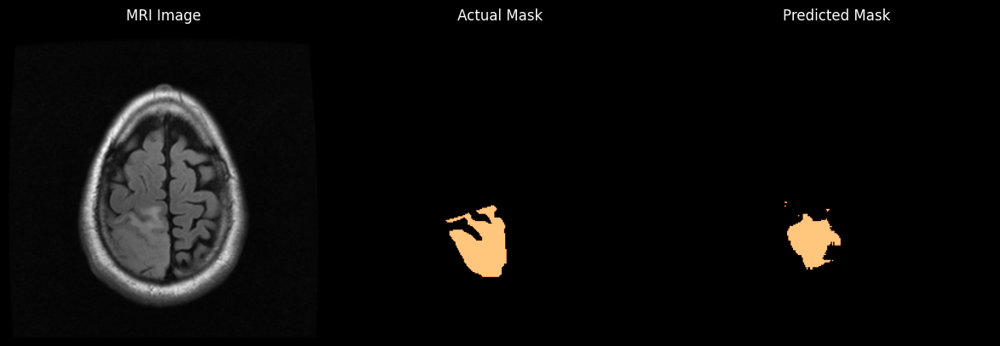

IoU: tensor([[0.7698]])


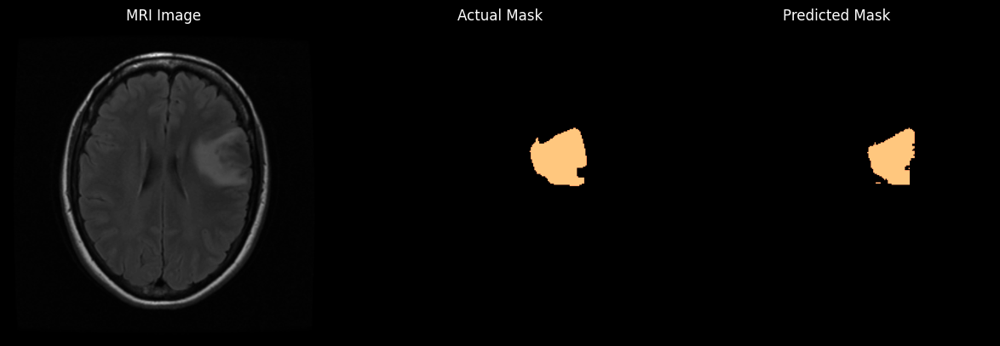

IoU: tensor([[0.6981]])


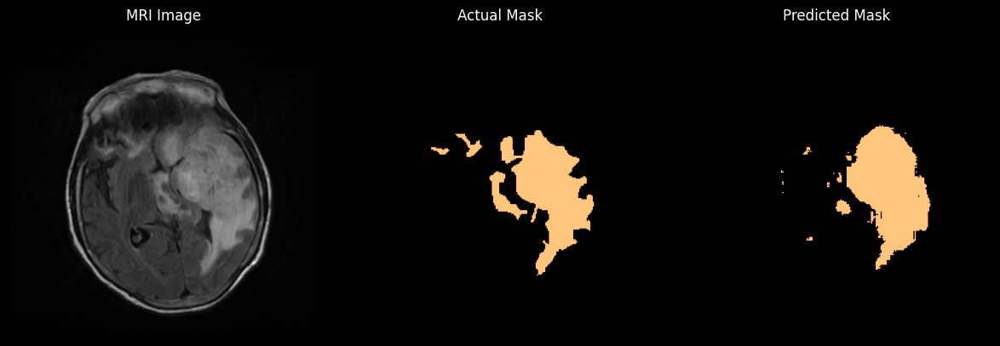

IoU: tensor([[0.5689]])


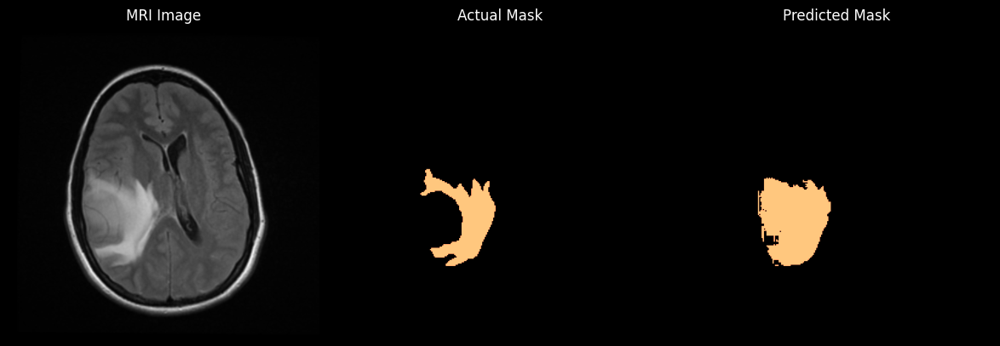

IoU: tensor([[0.6991]])


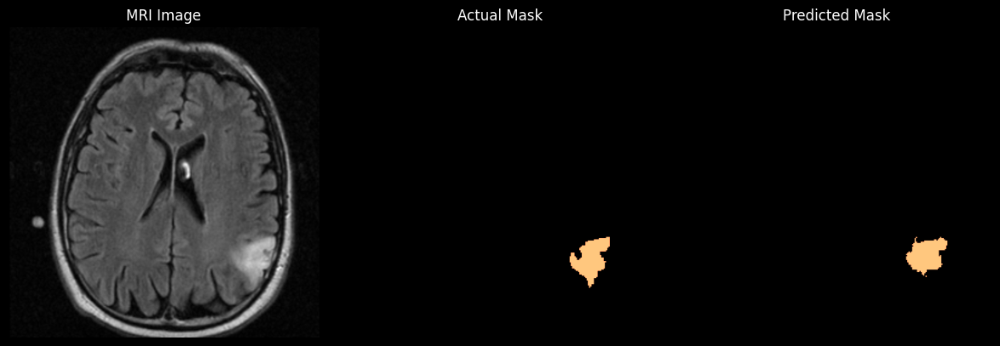

IoU: tensor([[0.6660]])


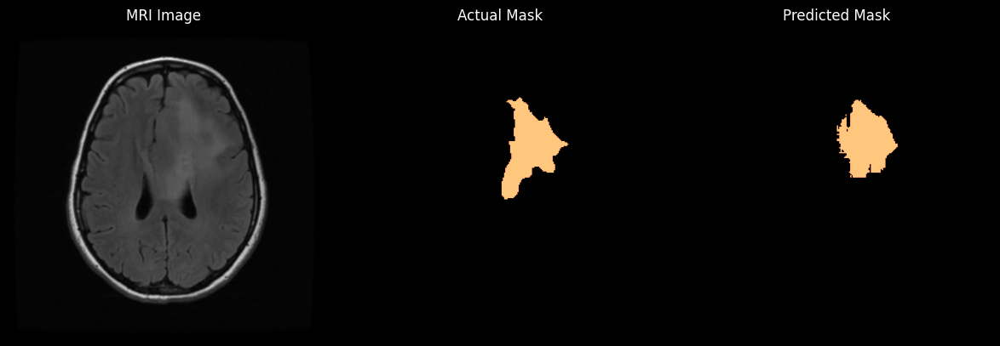

IoU: tensor([[0.6605]])


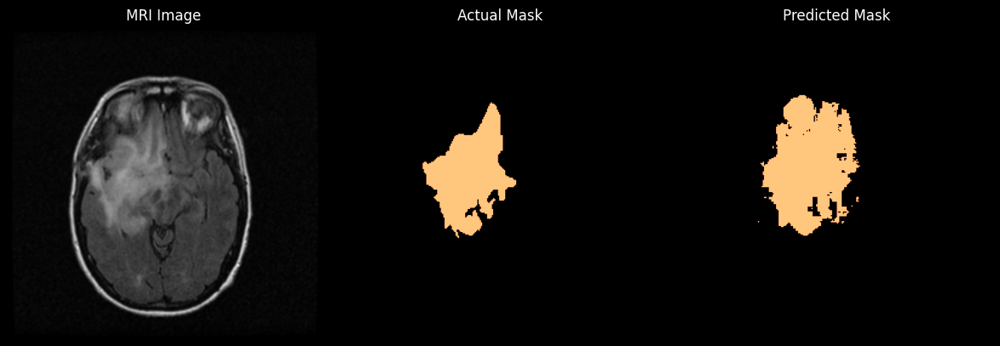

IoU: tensor([[0.4558]])


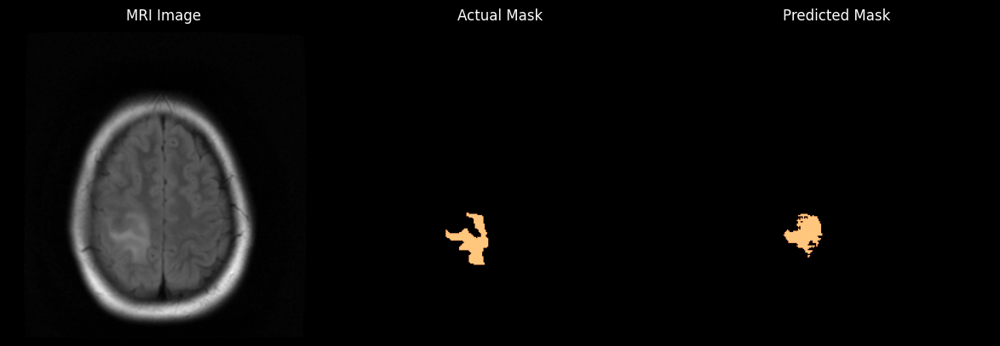

IoU: tensor([[0.7603]])


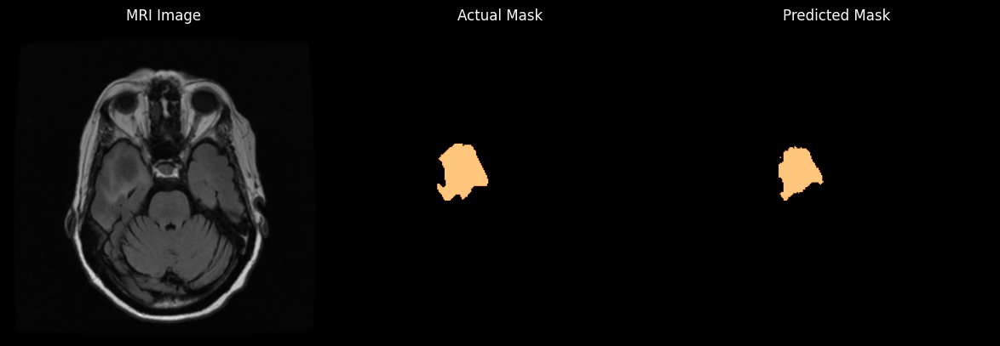

IoU: tensor([[0.9056]])


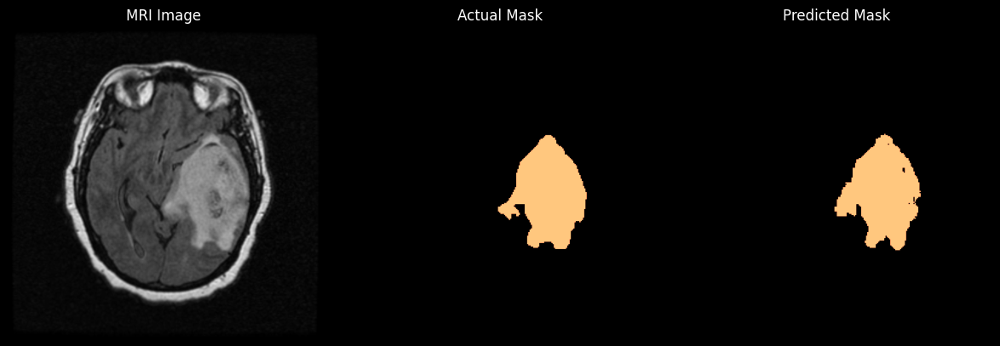

IoU: tensor([[0.0233]])


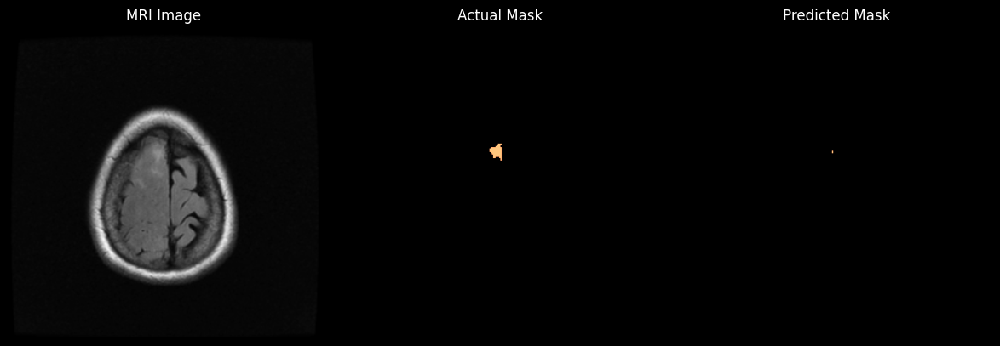

IoU: tensor([[0.7522]])


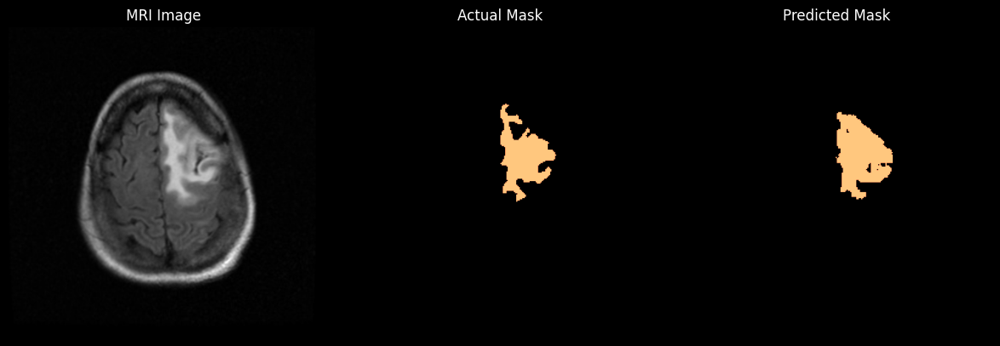

IoU: tensor([[0.5011]])


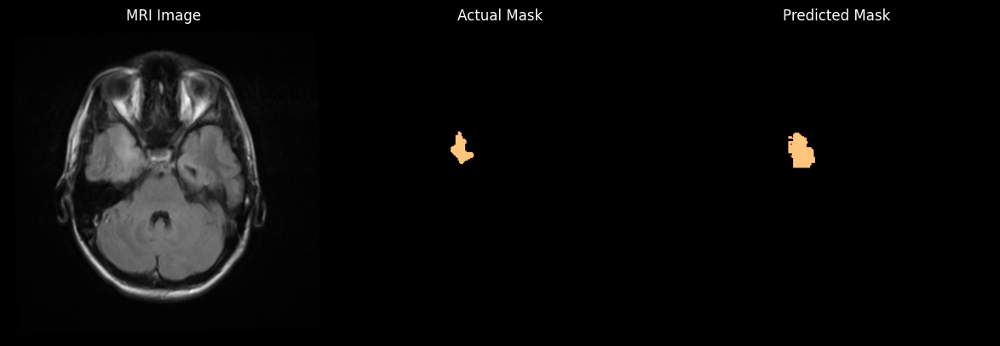

IoU: tensor([[0.5980]])


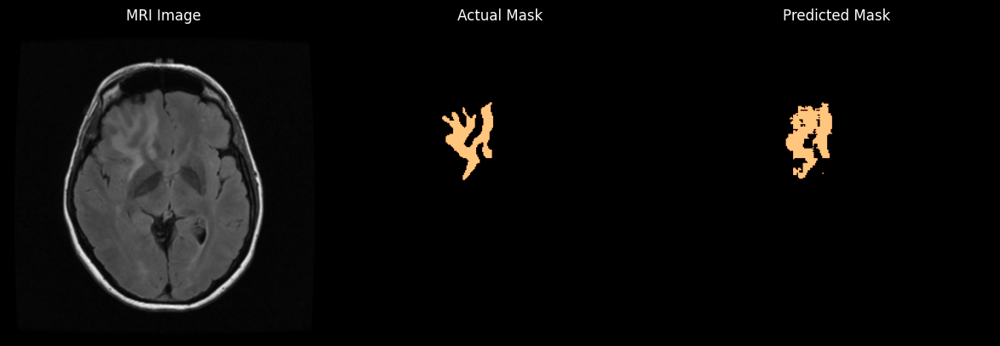

IoU: tensor([[0.9203]])


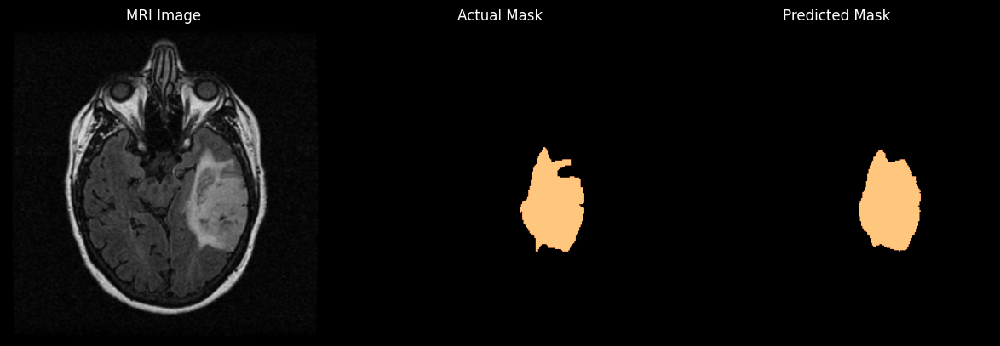

IoU: tensor([[0.9113]])


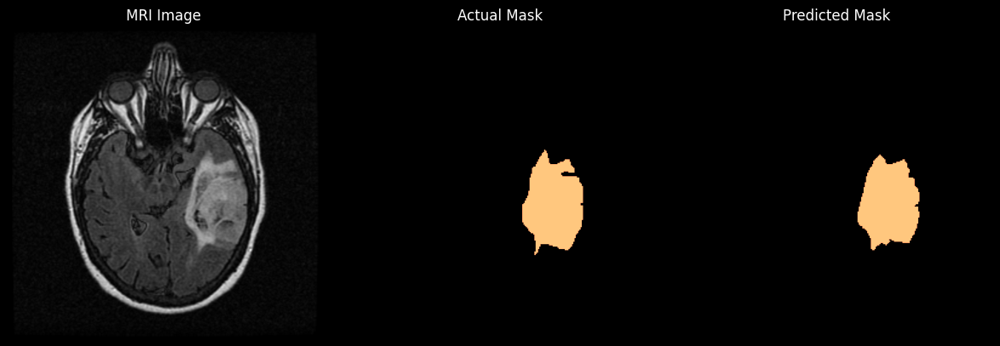

IoU: tensor([[0.8418]])


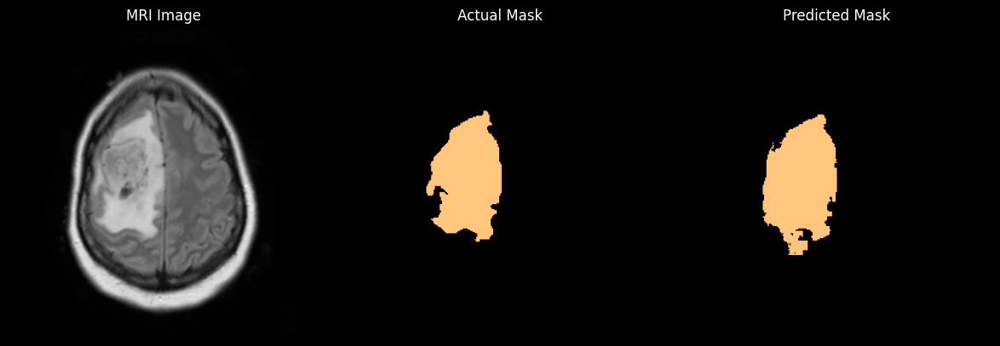

IoU: tensor([[0.7376]])


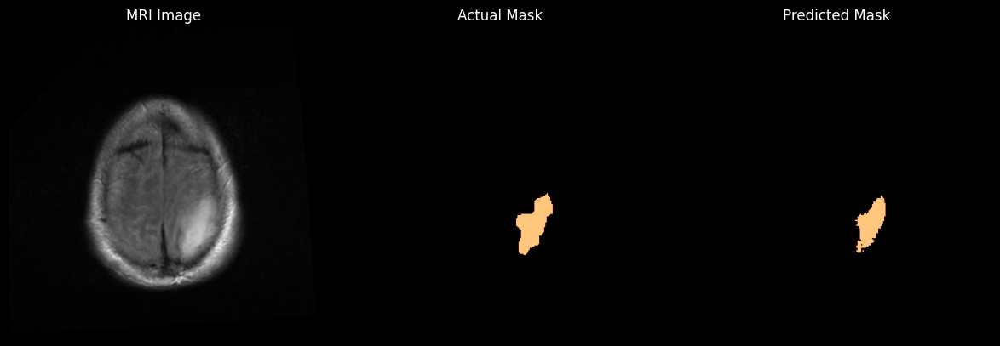

IoU: tensor([[0.8353]])


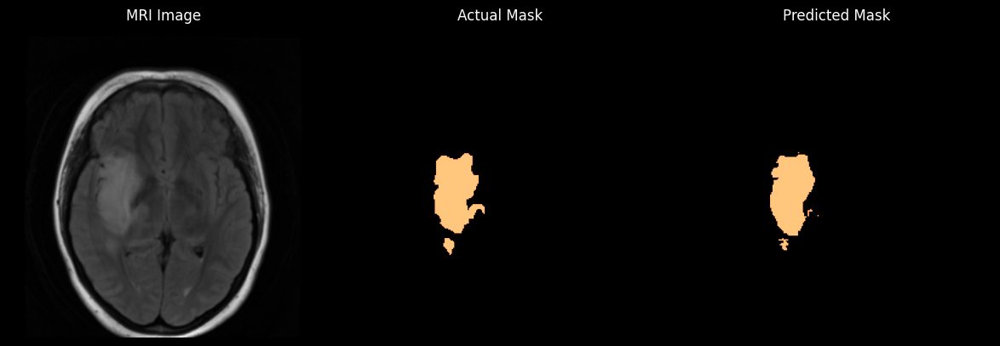

IoU: tensor([[0.8023]])


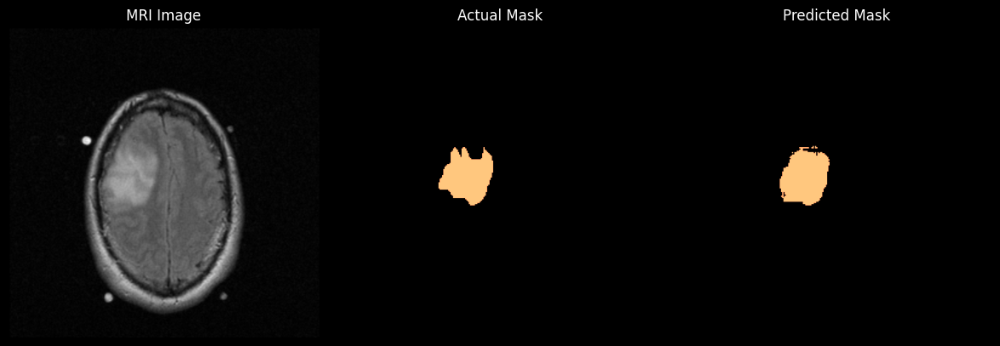

IoU: tensor([[0.5223]])


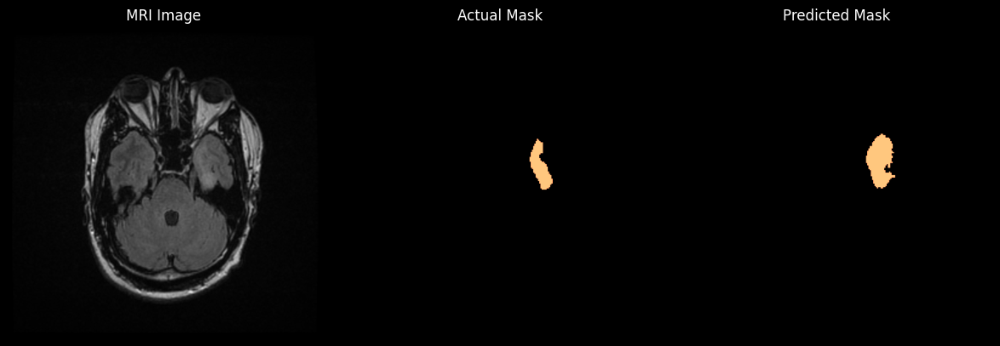

IoU: tensor([[0.4459]])


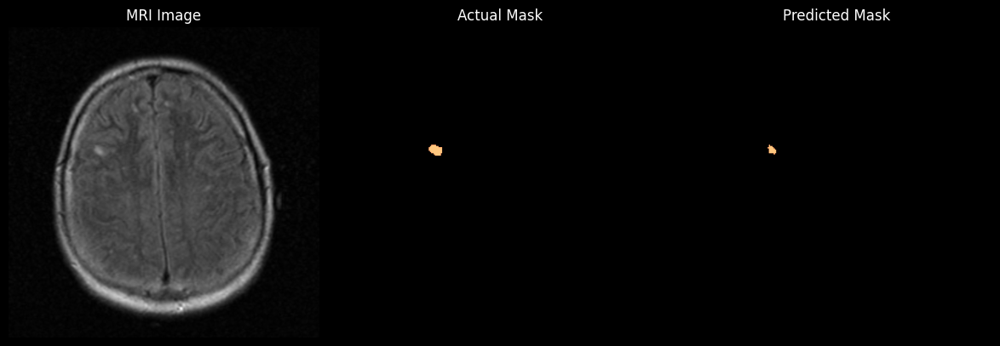

IoU: tensor([[0.7822]])


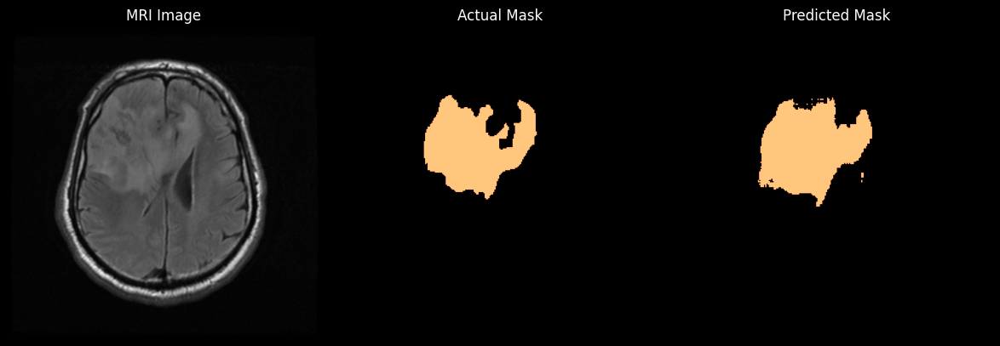

IoU: tensor([[0.7200]])


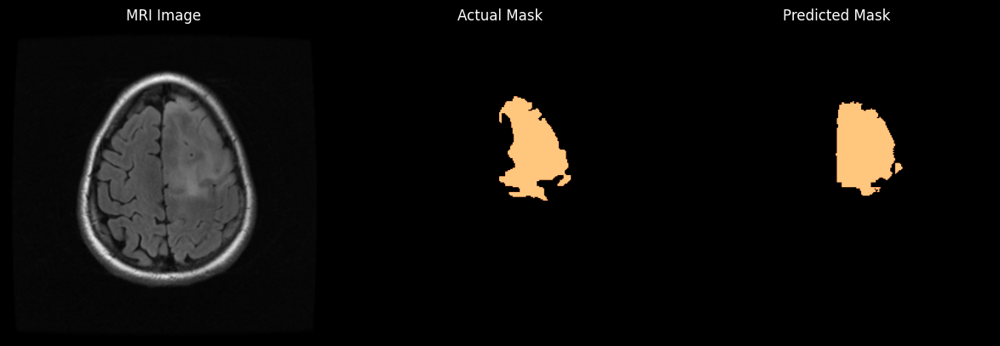

IoU: tensor([[0.5938]])


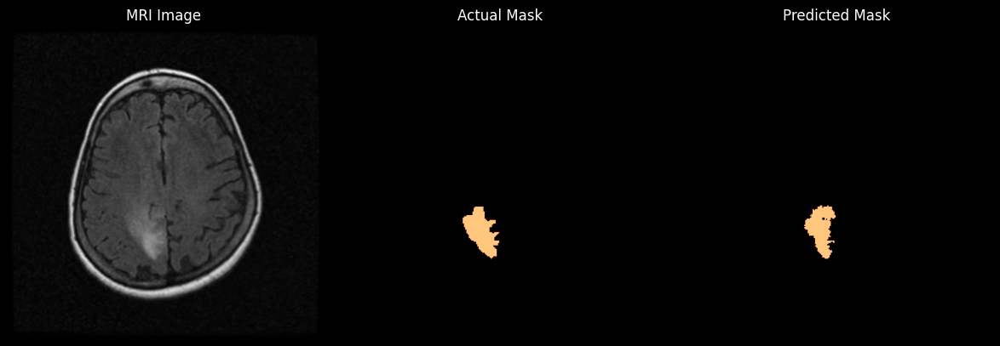

IoU: tensor([[0.6180]])


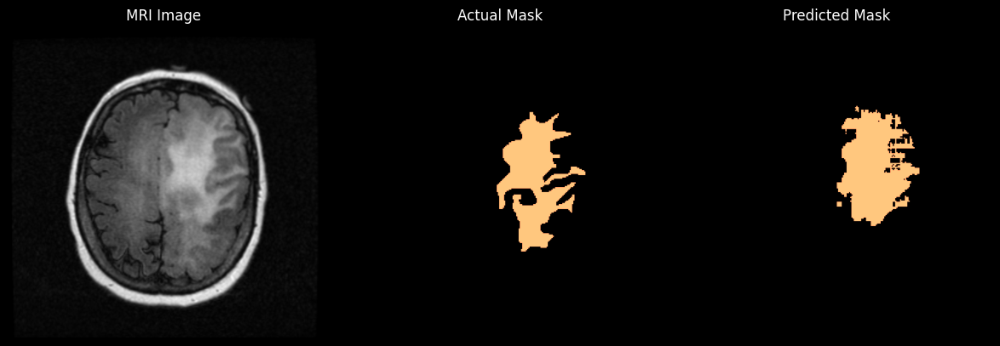

IoU: tensor([[0.6836]])


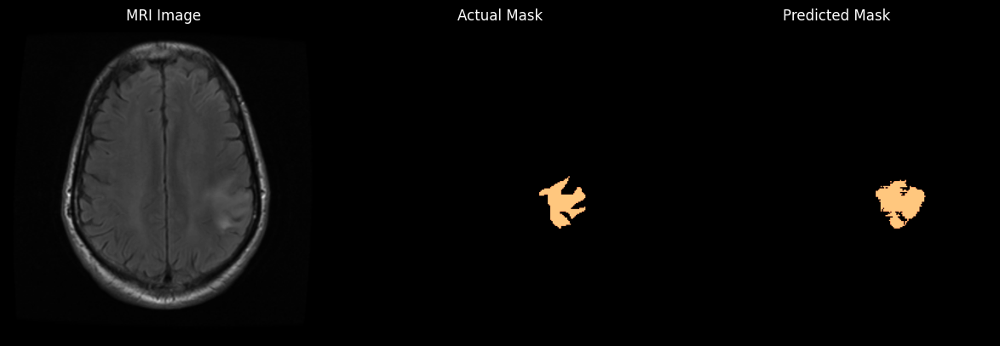

IoU: tensor([[0.9377]])


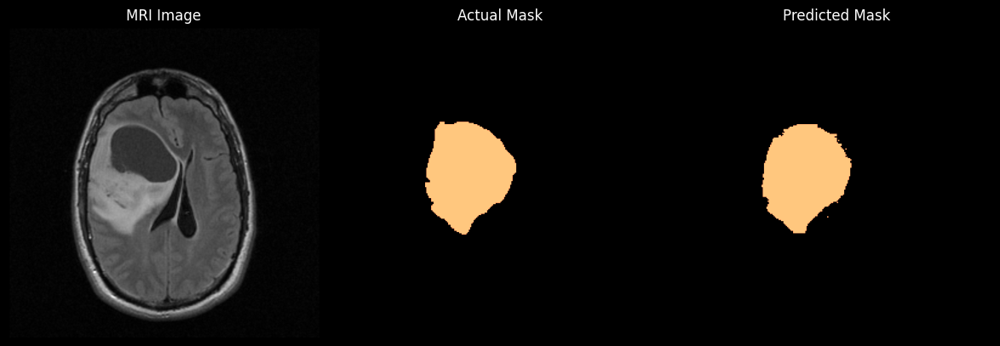

IoU: tensor([[0.6856]])


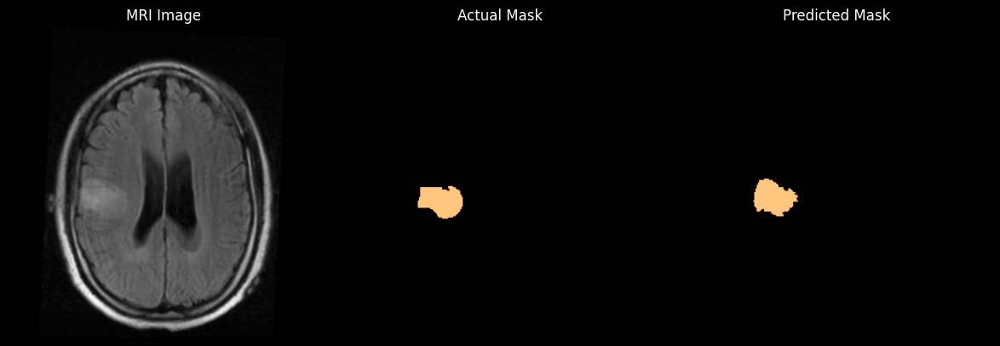

IoU: tensor([[0.7419]])


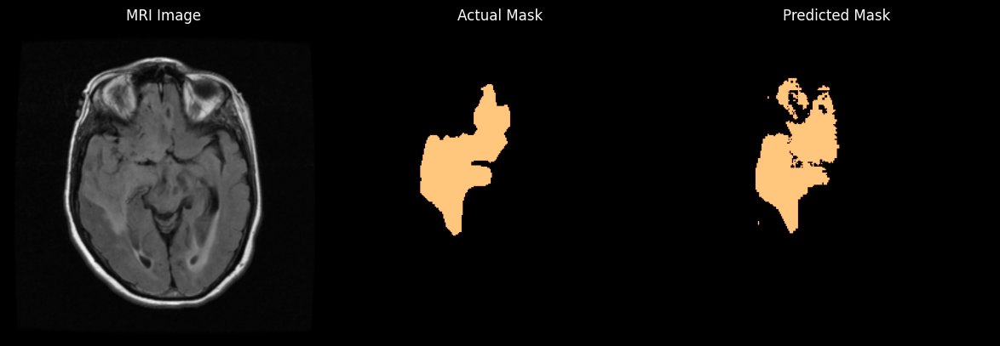

IoU: tensor([[0.8351]])


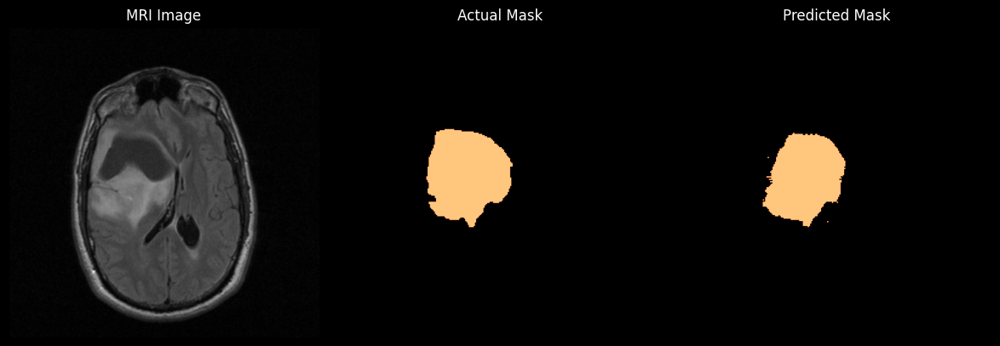

IoU: tensor([[0.7860]])


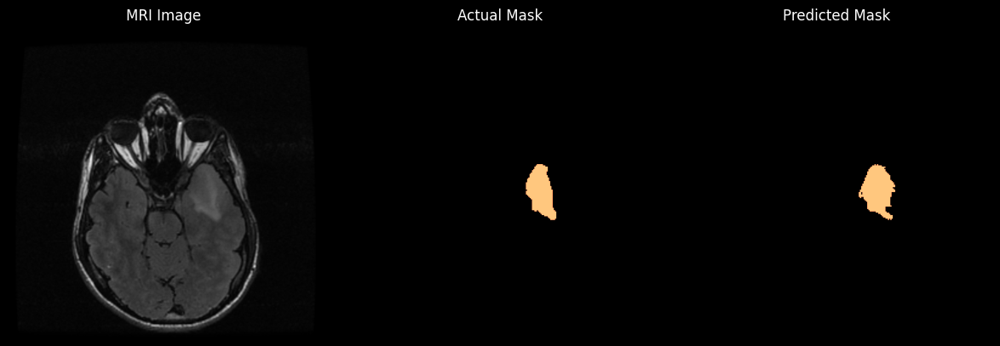

IoU: tensor([[0.9340]])


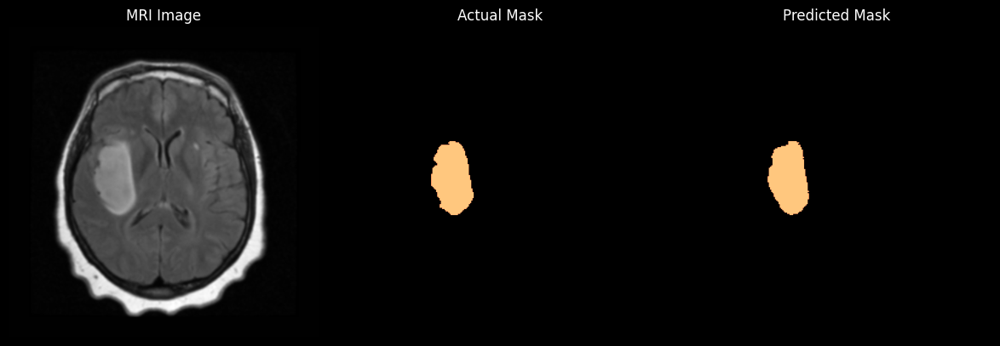

IoU: tensor([[0.8034]])


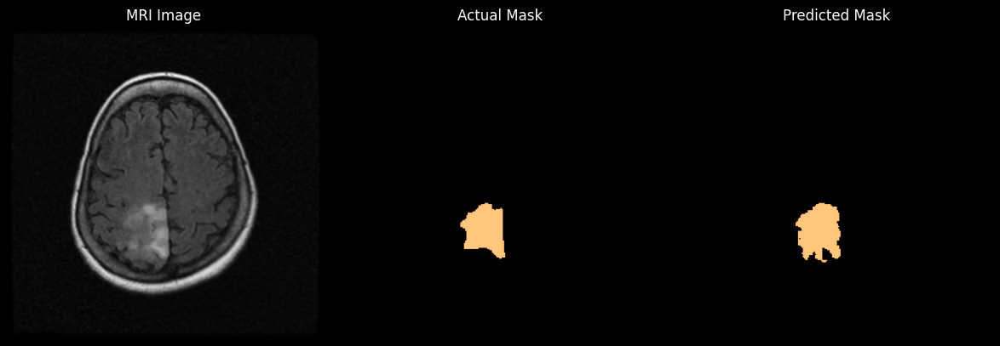

IoU: tensor([[0.3482]])


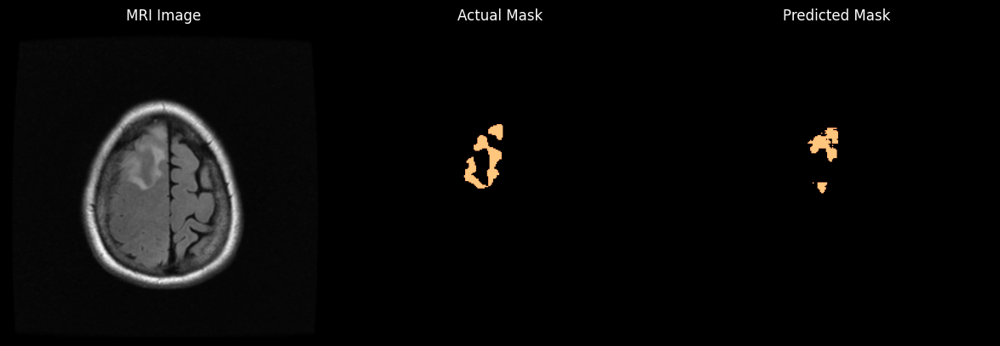

IoU: tensor([[0.6415]])


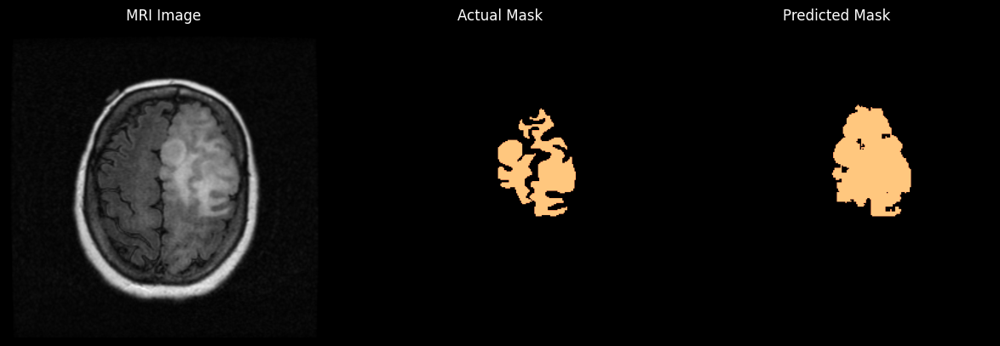

IoU: tensor([[0.5429]])


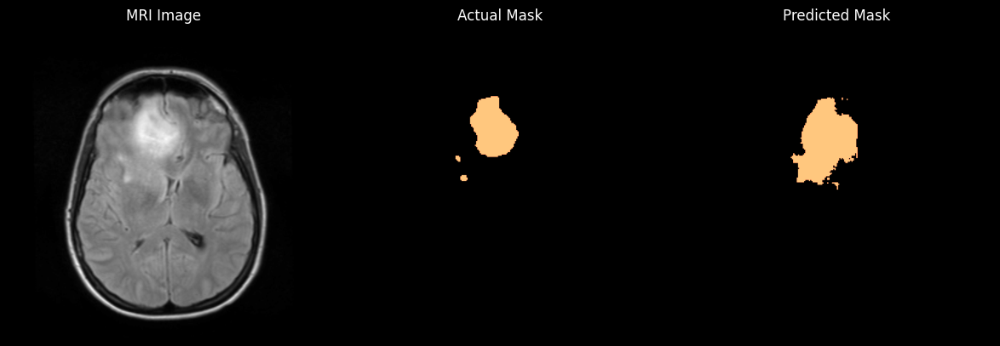

IoU: tensor([[0.7202]])


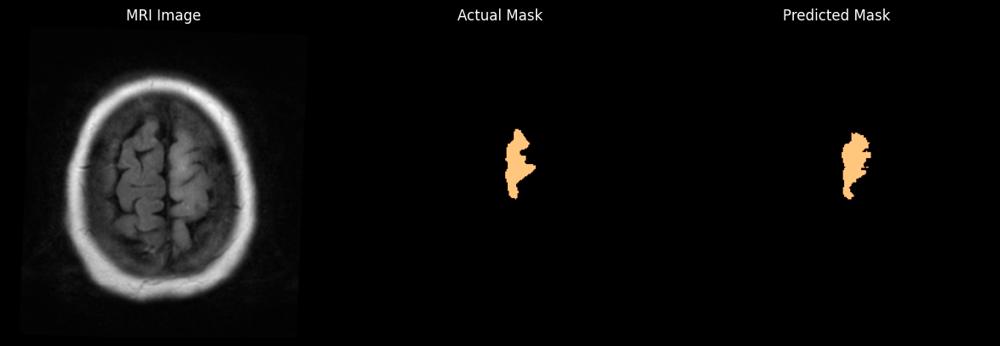

IoU: tensor([[0.5757]])


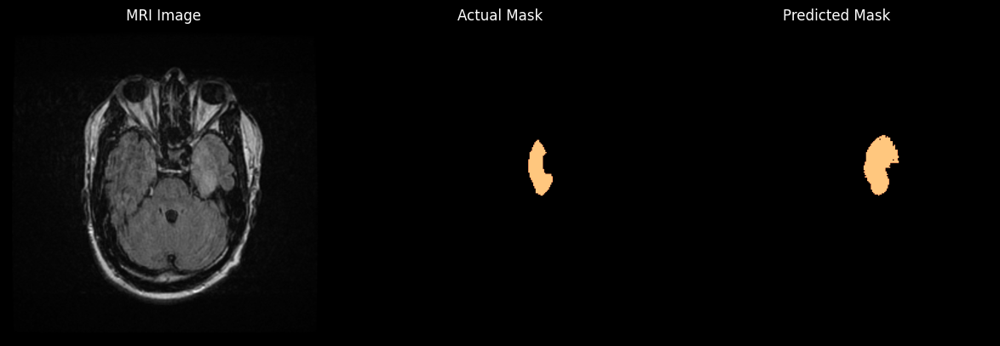

IoU: tensor([[0.3529]])


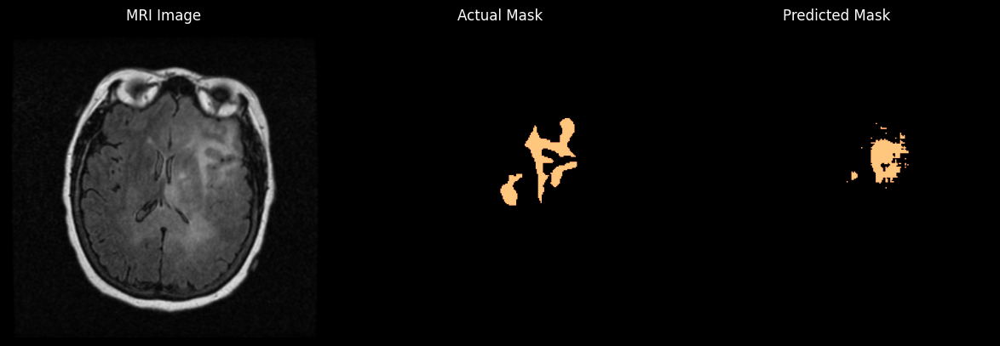

IoU: tensor([[0.5210]])


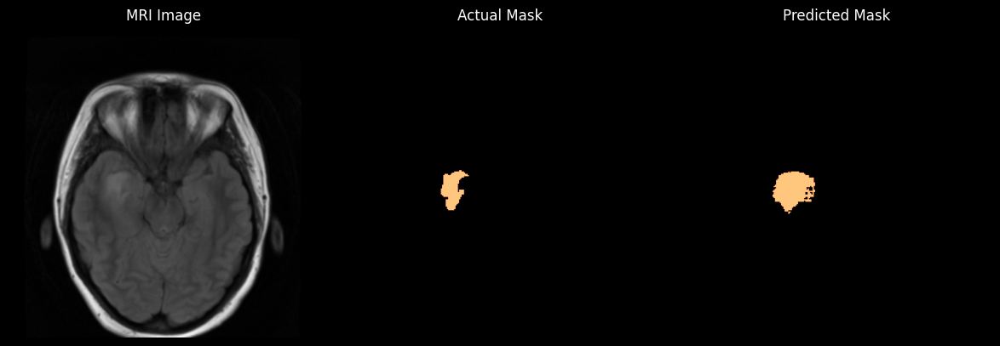

IoU: tensor([[0.8076]])


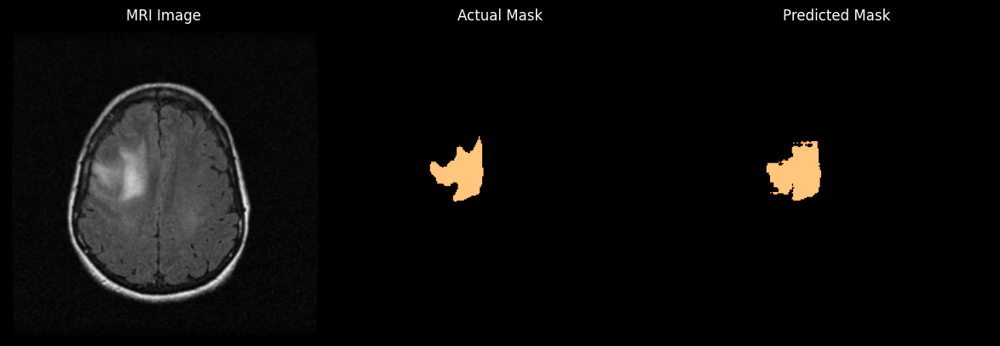

IoU: tensor([[0.5398]])


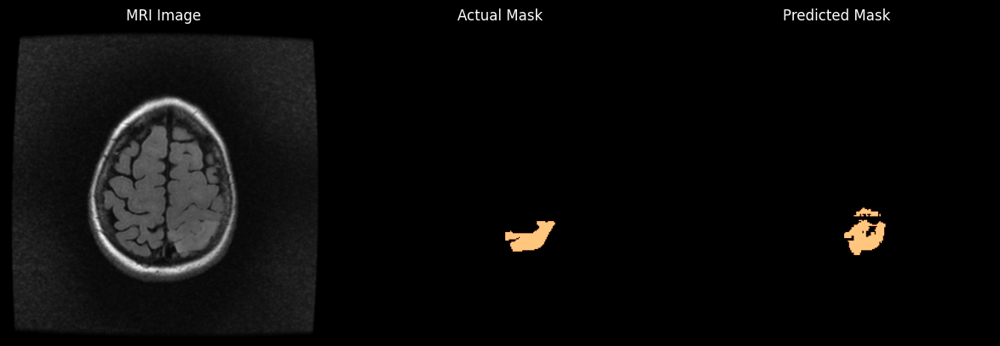

IoU: tensor([[0.8179]])


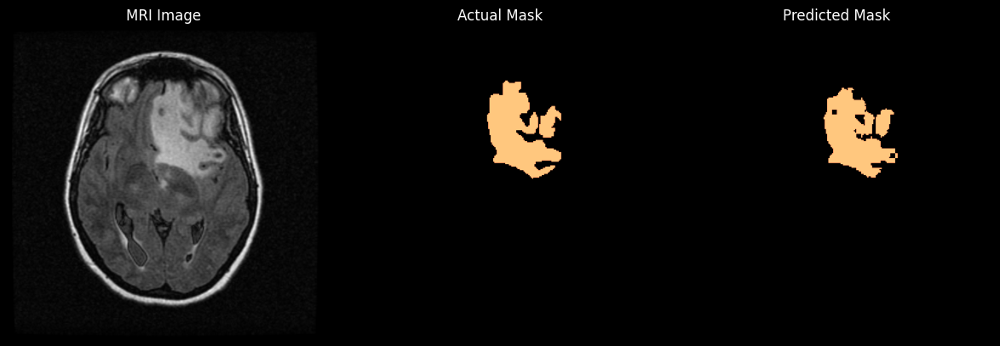

IoU: tensor([[0.8961]])


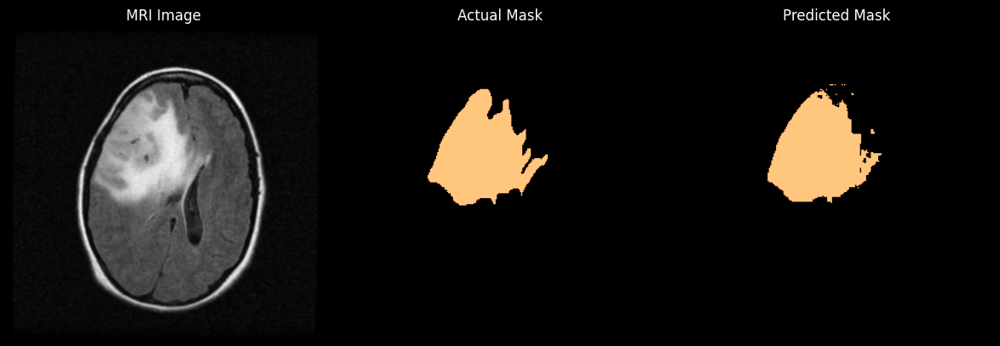

IoU: tensor([[0.7169]])


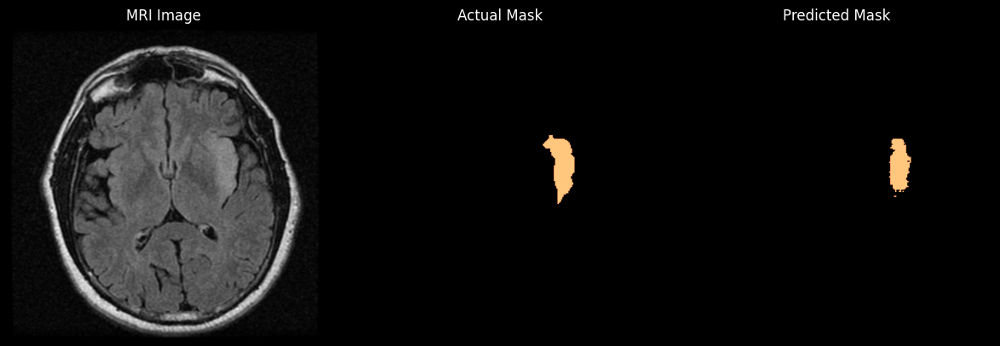

IoU: tensor([[0.7945]])


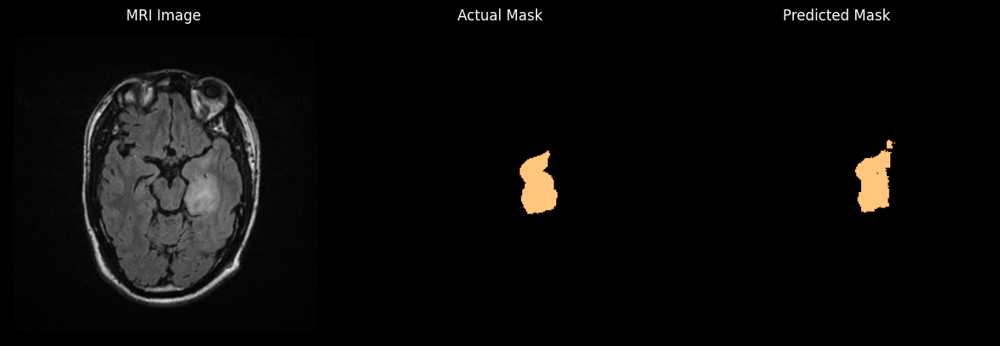

IoU: tensor([[0.9305]])


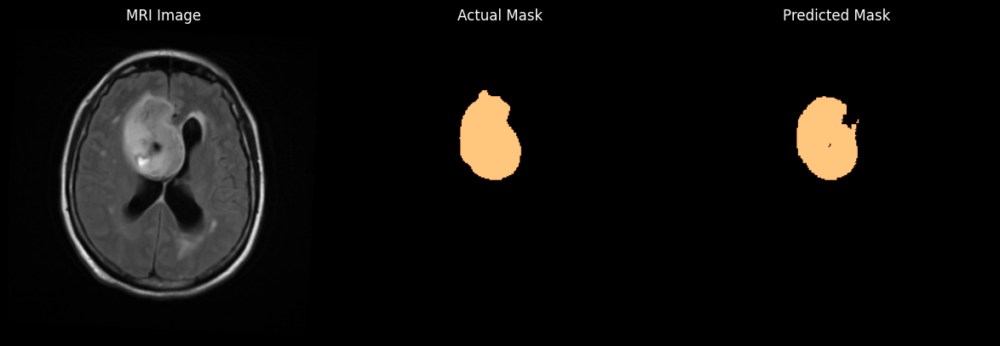

IoU: tensor([[0.8749]])


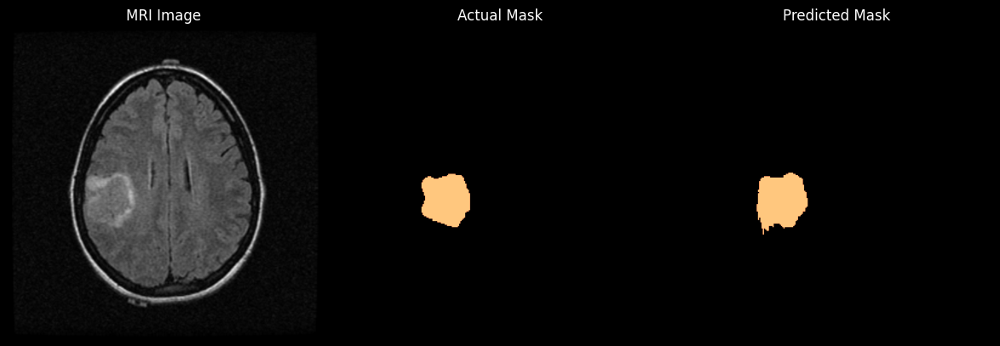

IoU: tensor([[0.9305]])


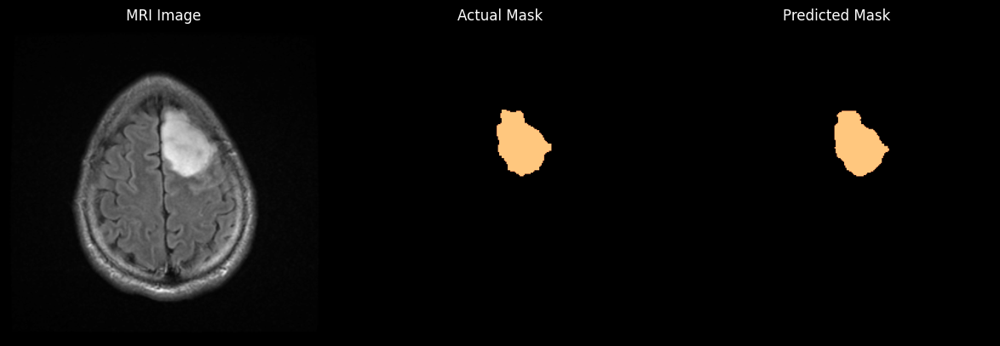

IoU: tensor([[0.8490]])


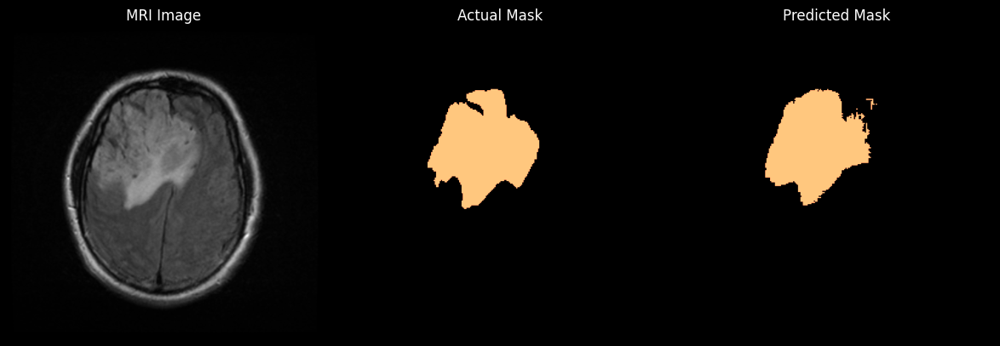

IoU: tensor([[0.7789]])


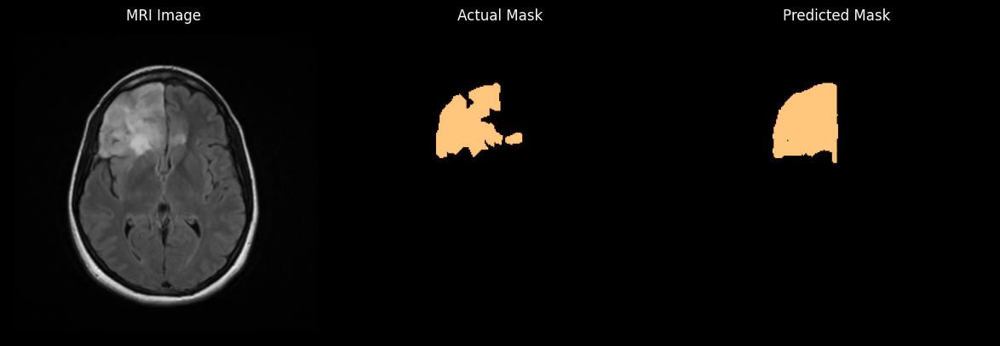

IoU: tensor([[0.7910]])


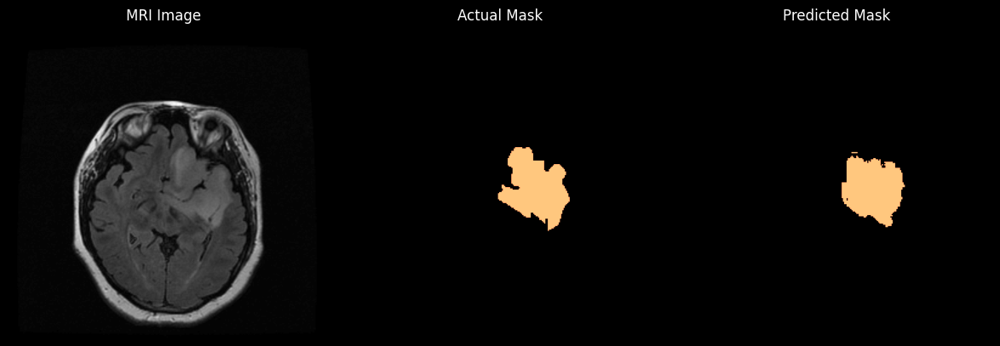

IoU: tensor([[0.6523]])


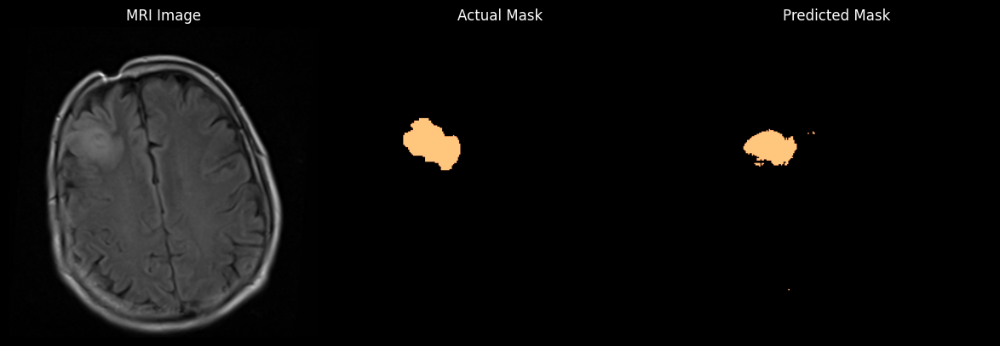

IoU: tensor([[0.8919]])


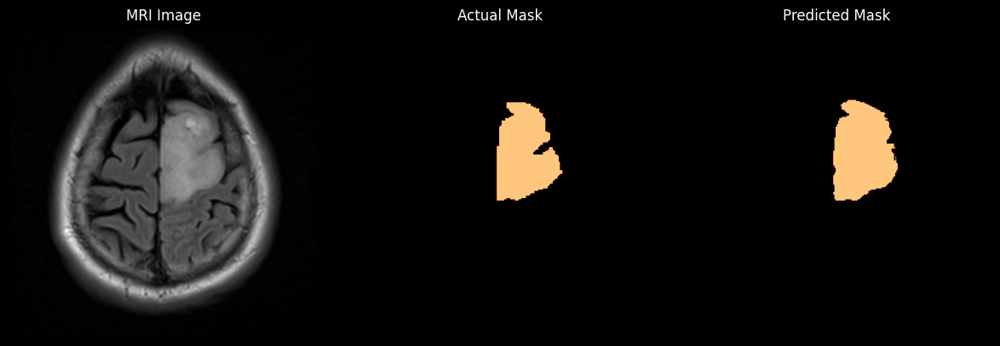

IoU: tensor([[0.2184]])


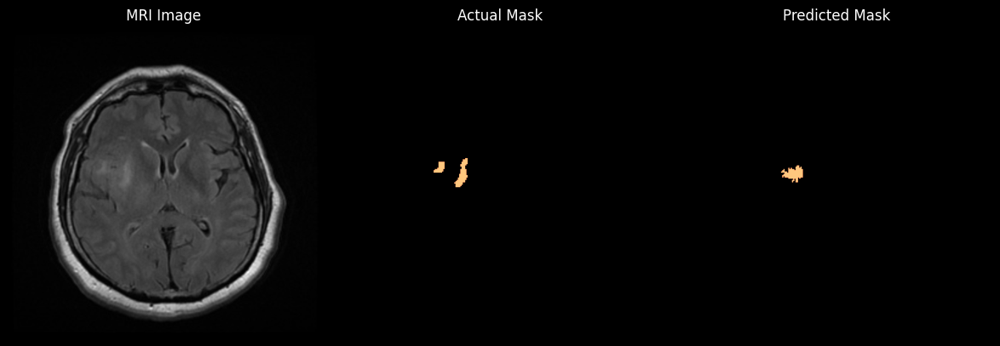

IoU: tensor([[0.9386]])


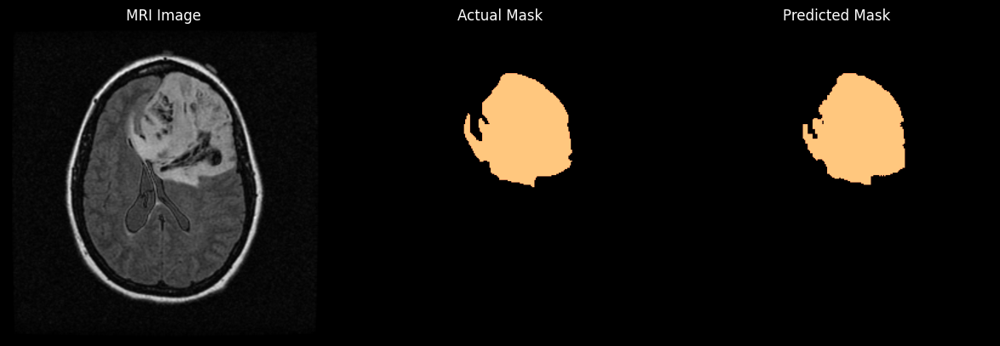

IoU: tensor([[0.5583]])


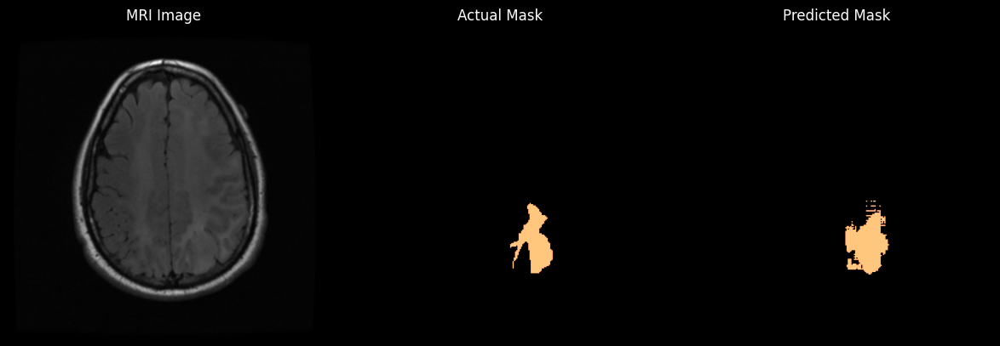

IoU: tensor([[0.9457]])


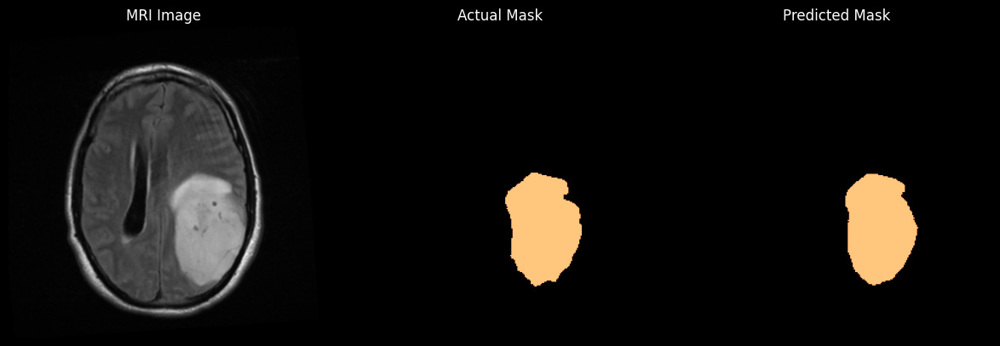

IoU: tensor([[0.6461]])


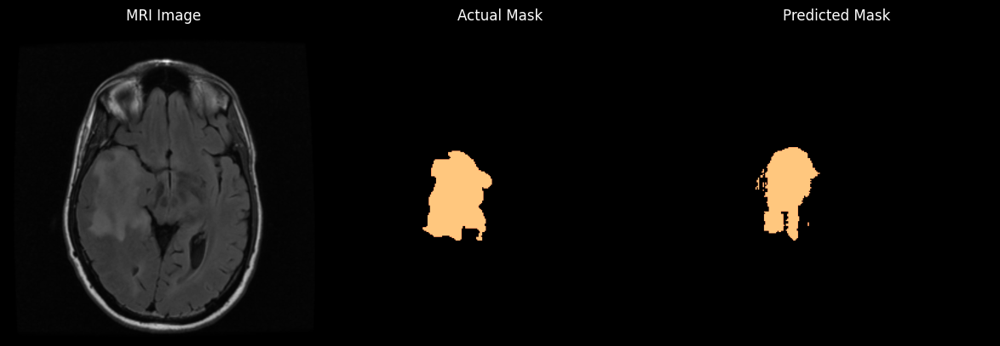

IoU: tensor([[0.7915]])


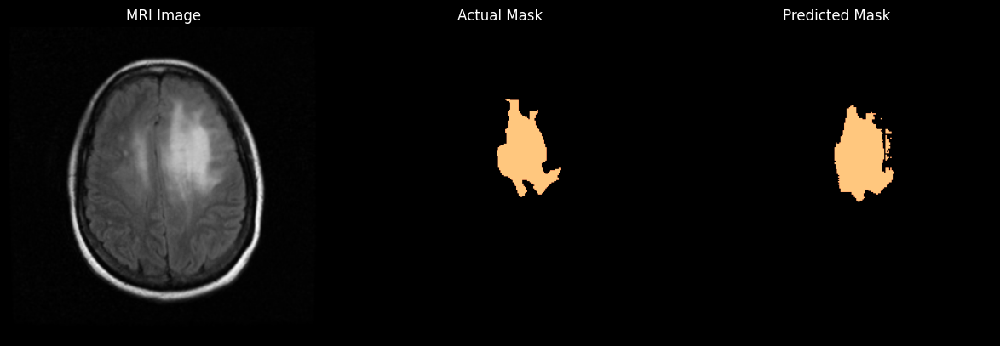

IoU: tensor([[0.4444]])


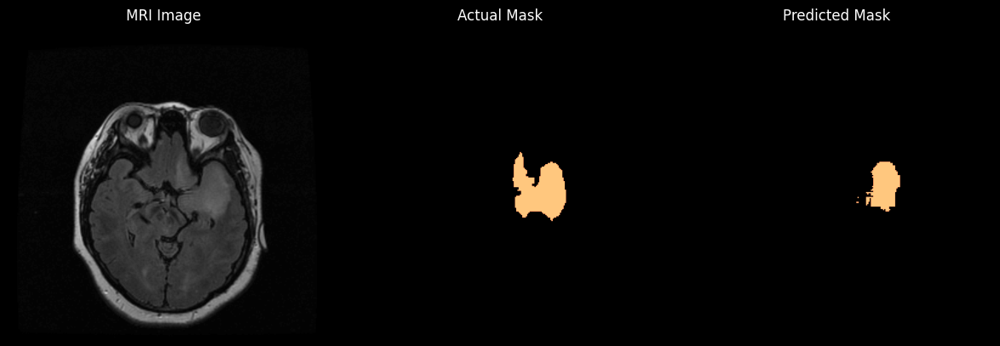

IoU: tensor([[0.8966]])


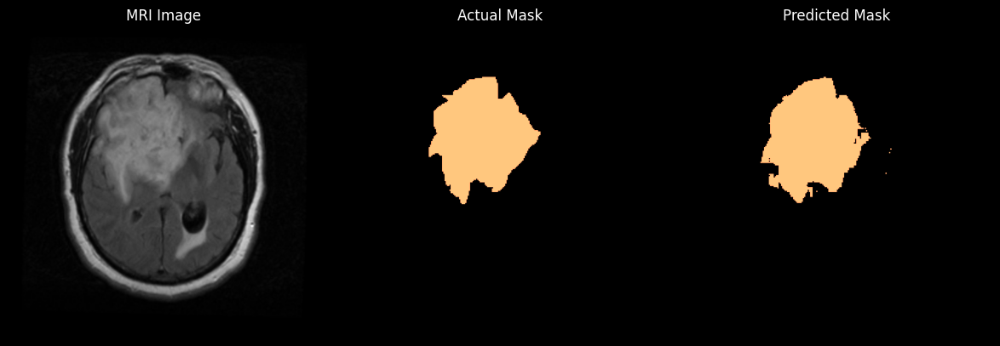

IoU: tensor([[0.4784]])


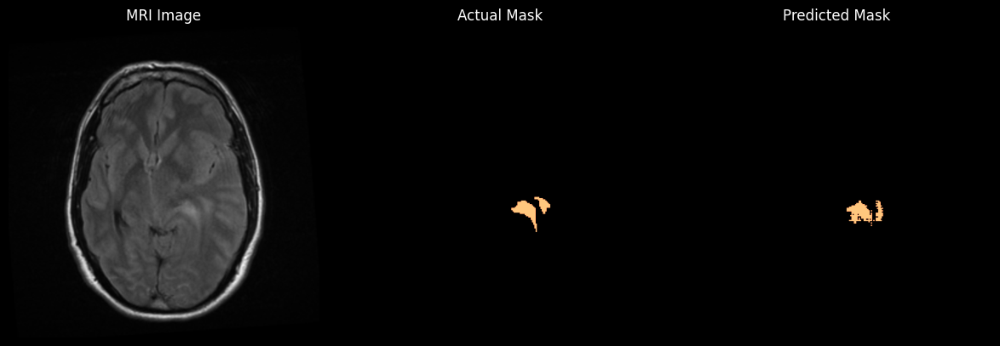

IoU: tensor([[0.7989]])


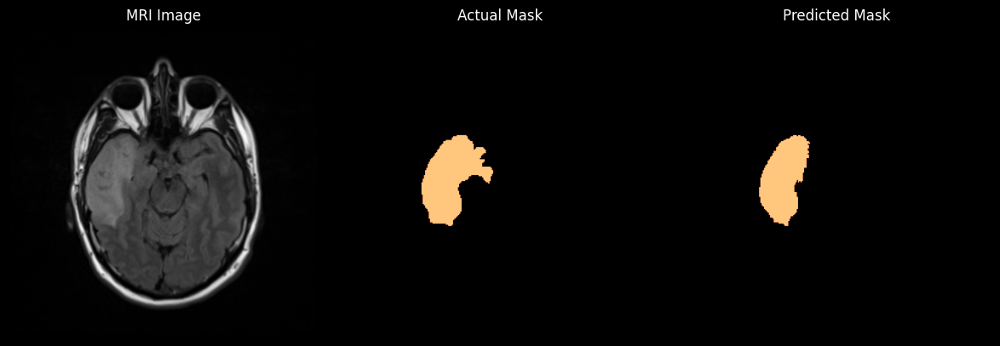

IoU: tensor([[0.8859]])


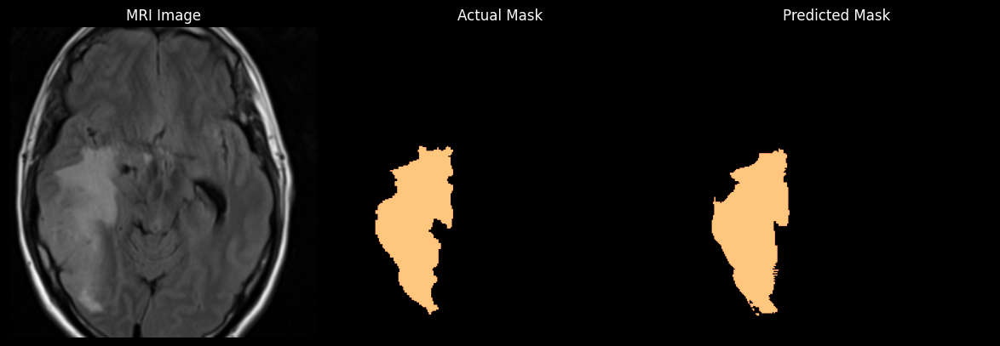

IoU: tensor([[0.6940]])


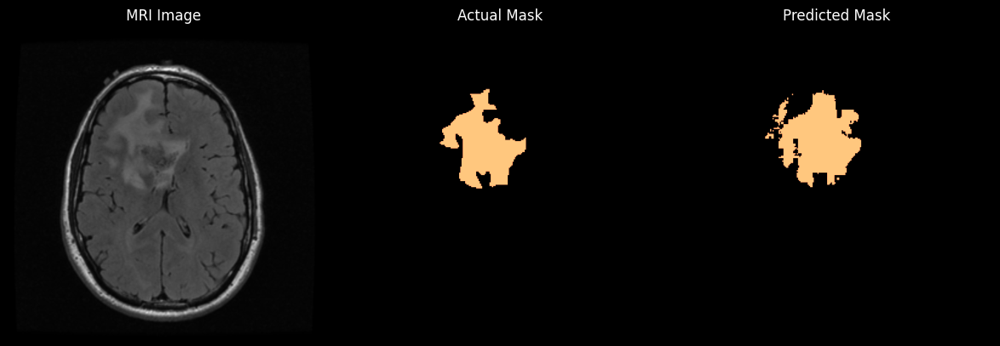

IoU: tensor([[0.8766]])


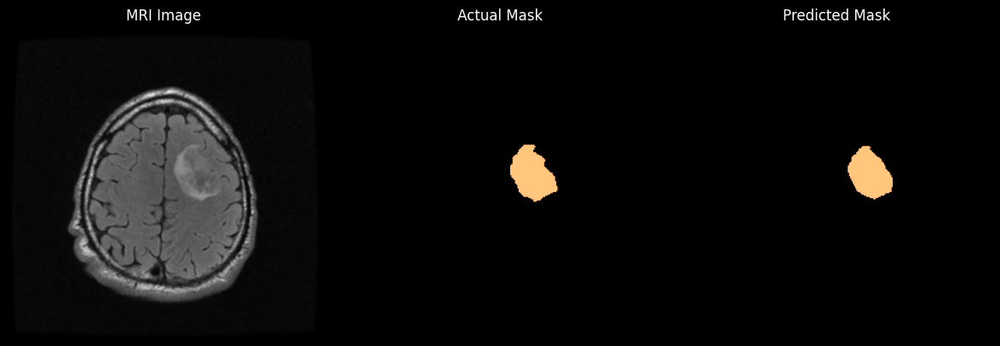

IoU: tensor([[0.7331]])


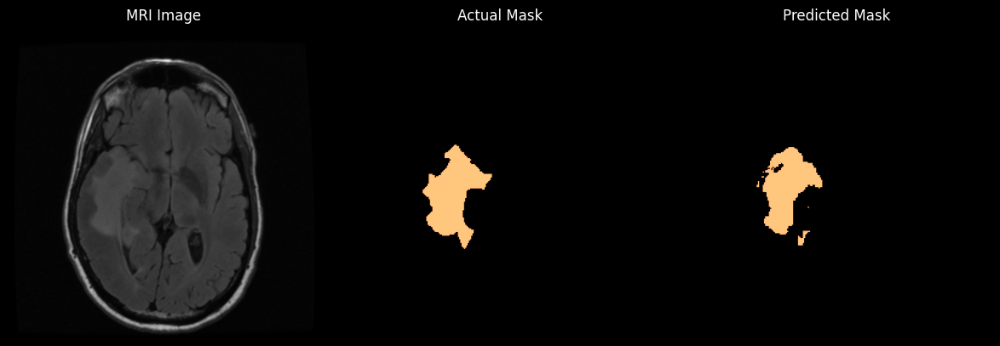

IoU: tensor([[0.6766]])


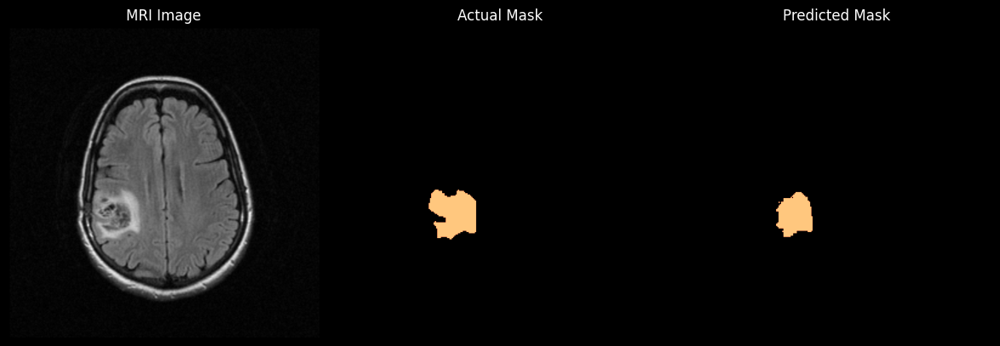

IoU: tensor([[0.9287]])


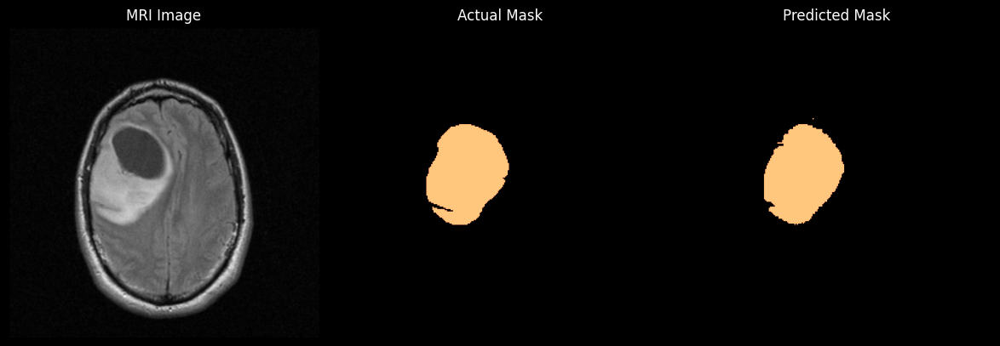

IoU: tensor([[0.7890]])


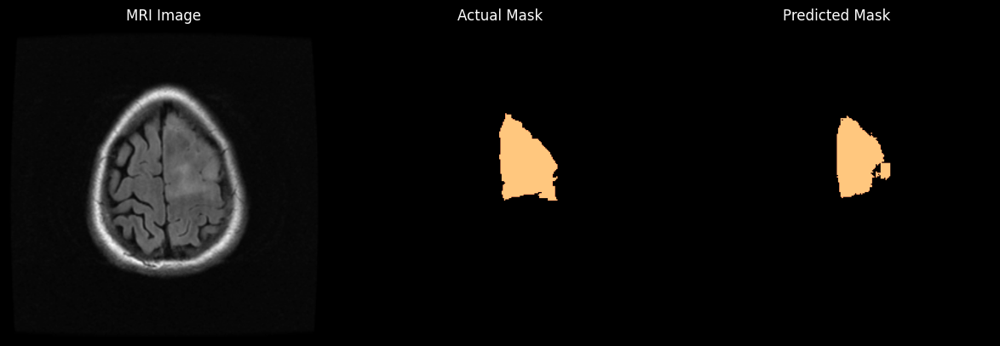

IoU: tensor([[0.8628]])


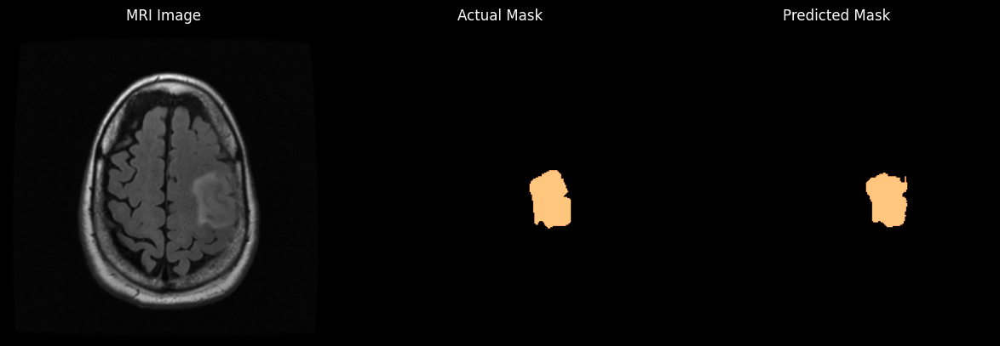

IoU: tensor([[0.4293]])


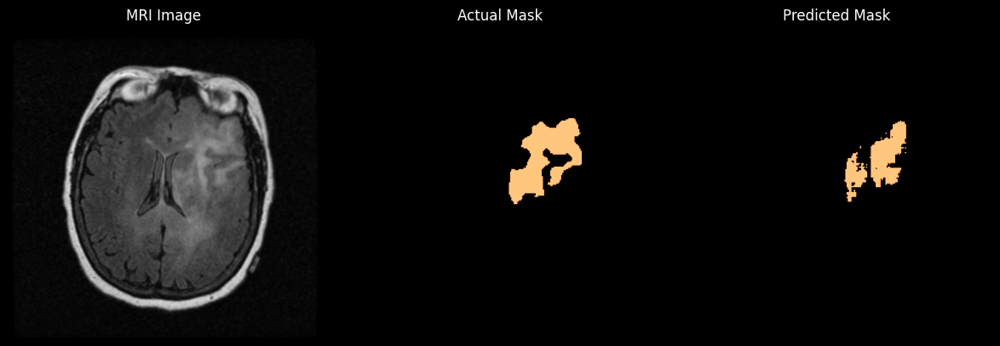

IoU: tensor([[0.3292]])


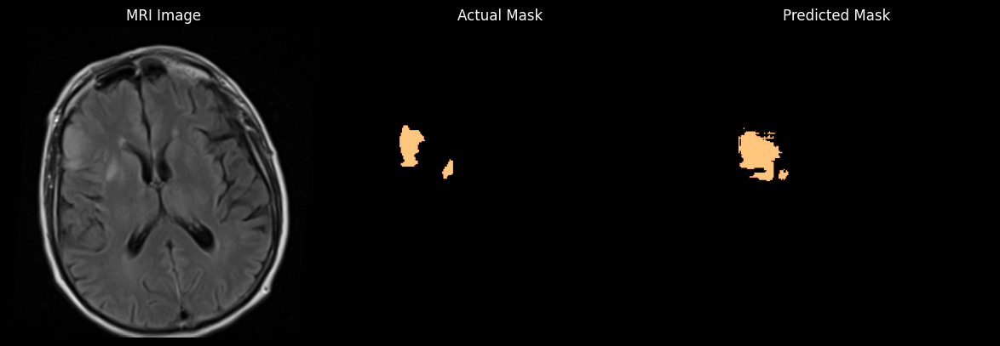

IoU: tensor([[0.9111]])


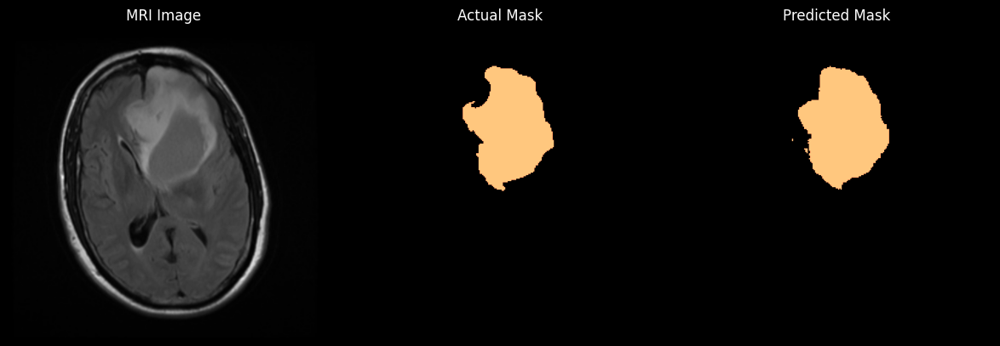

IoU: tensor([[0.8914]])


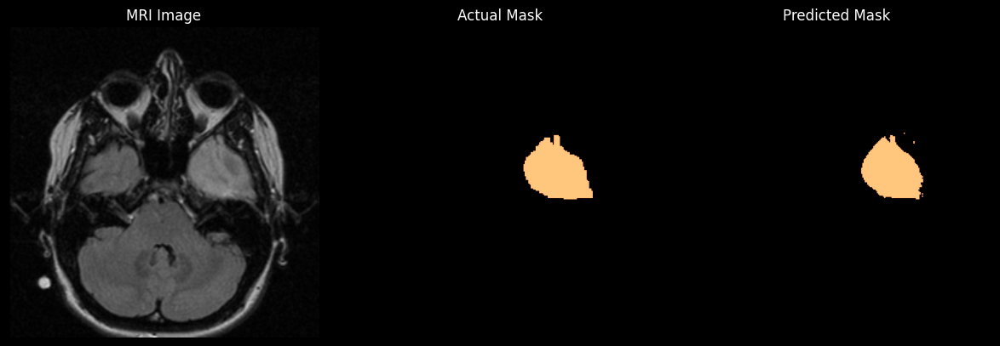

IoU: tensor([[0.8804]])


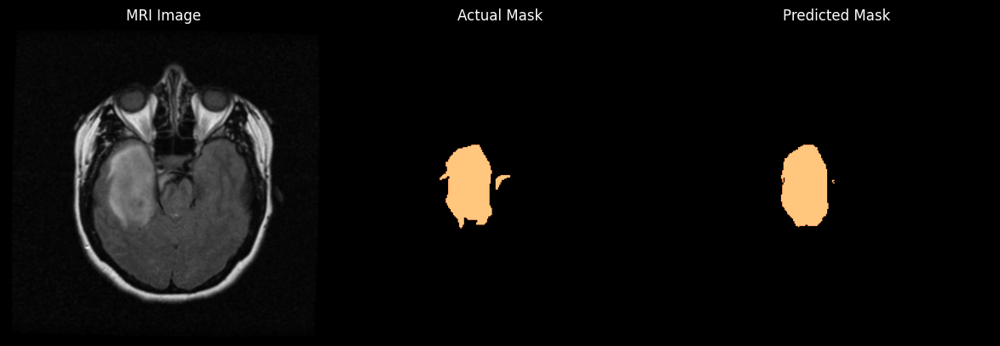

IoU: tensor([[0.9267]])


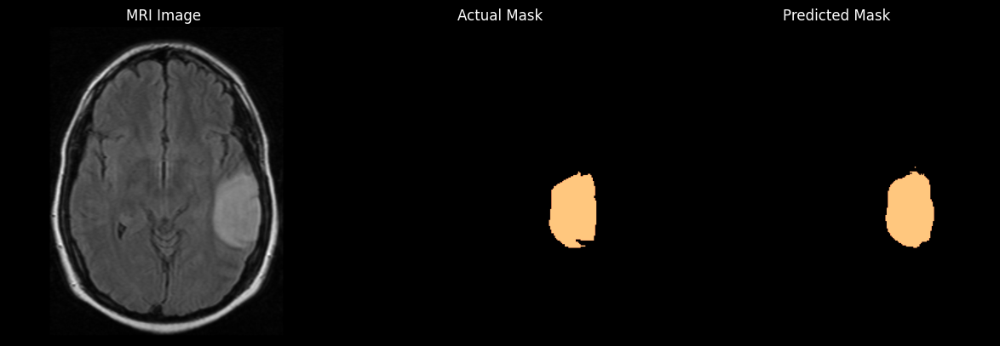

IoU: tensor([[0.5850]])


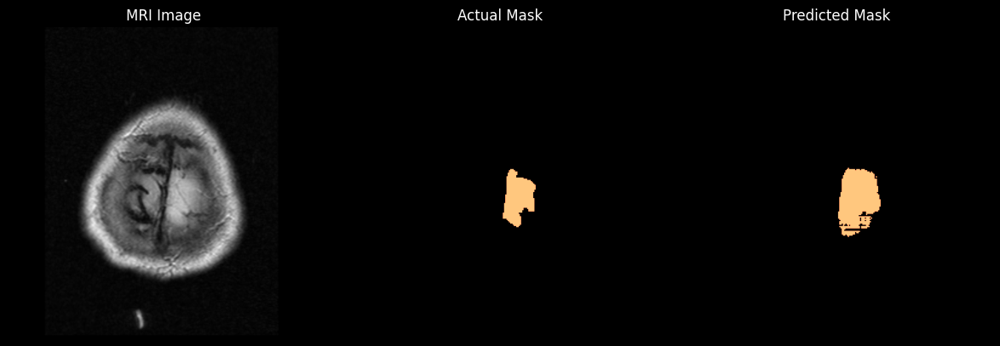

IoU: tensor([[0.6755]])


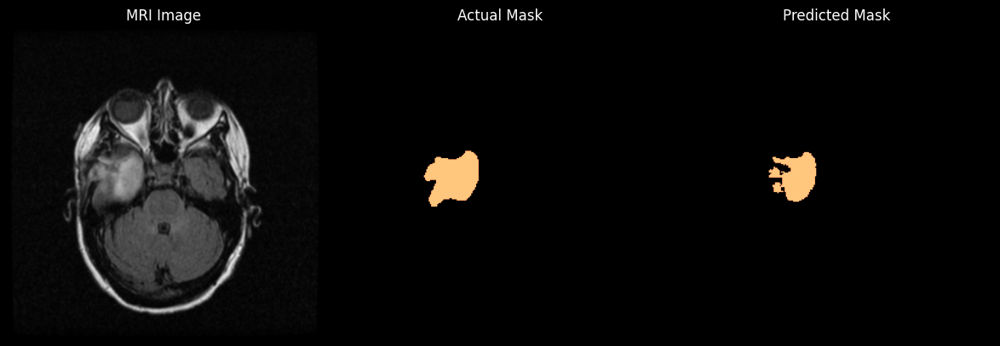

IoU: tensor([[0.8569]])


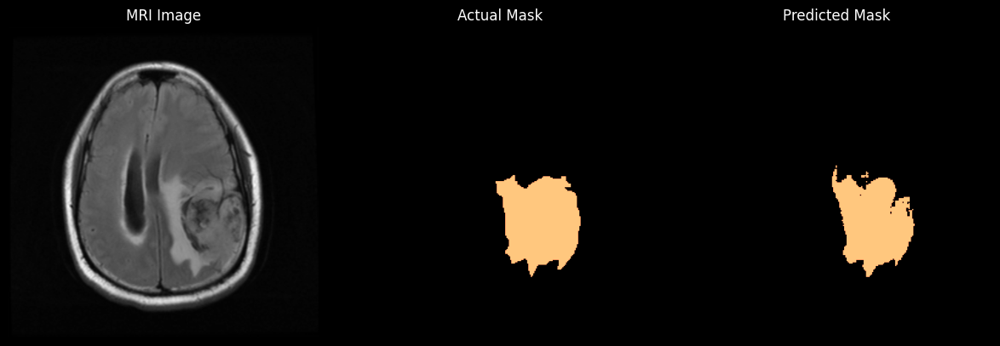

IoU: tensor([[0.7967]])


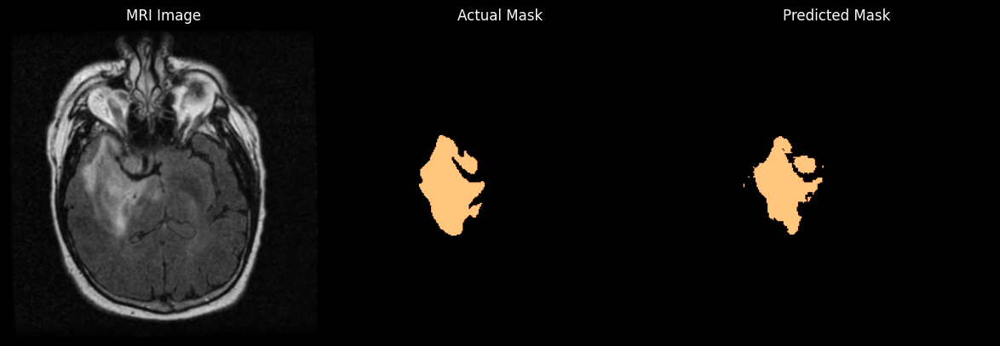

IoU: tensor([[0.8782]])


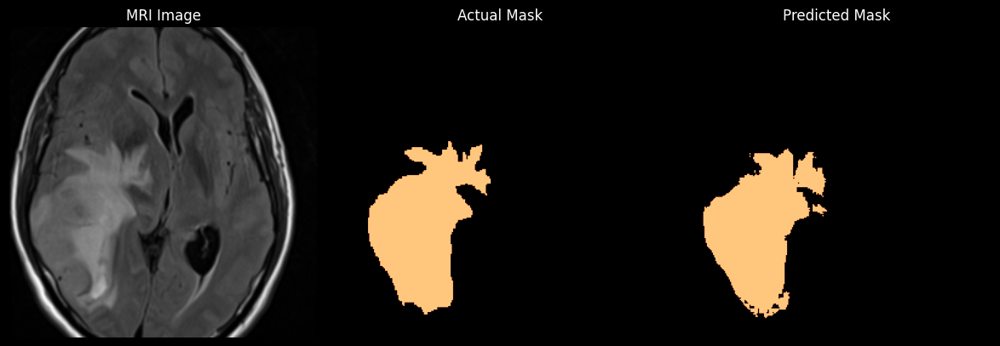

IoU: tensor([[0.9118]])


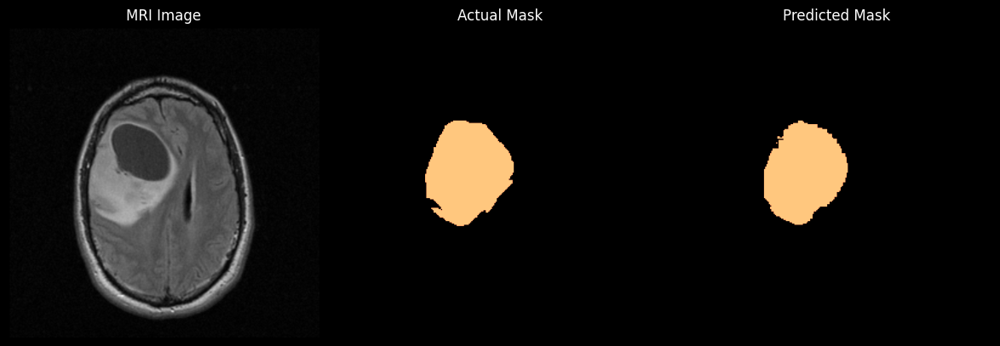

IoU: tensor([[0.8354]])


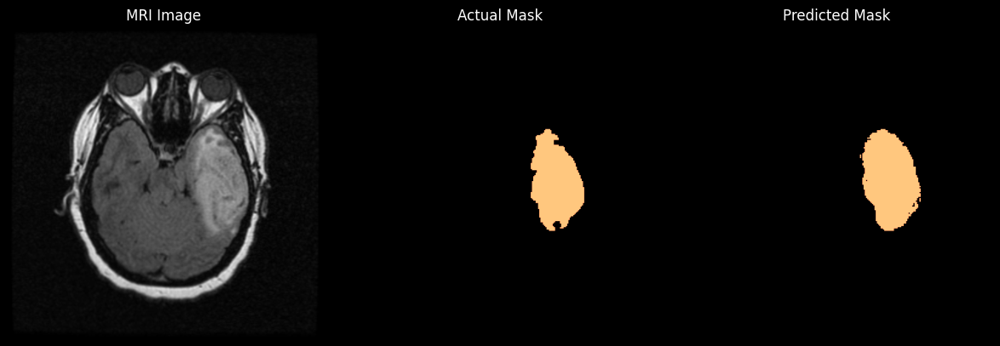

IoU: tensor([[0.9074]])


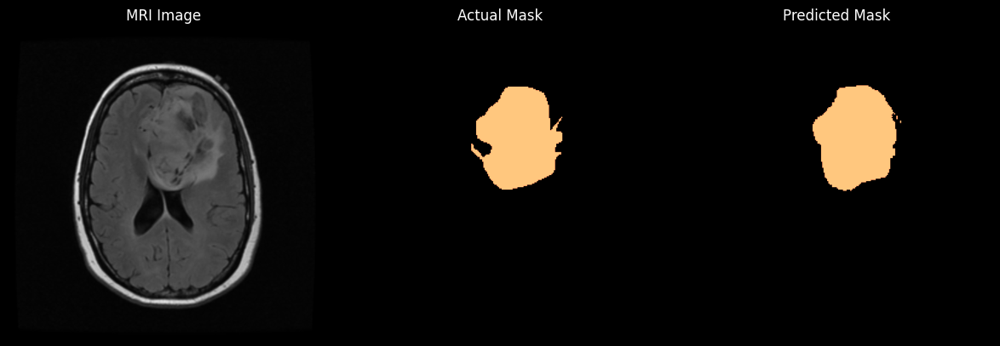

IoU: tensor([[0.8200]])


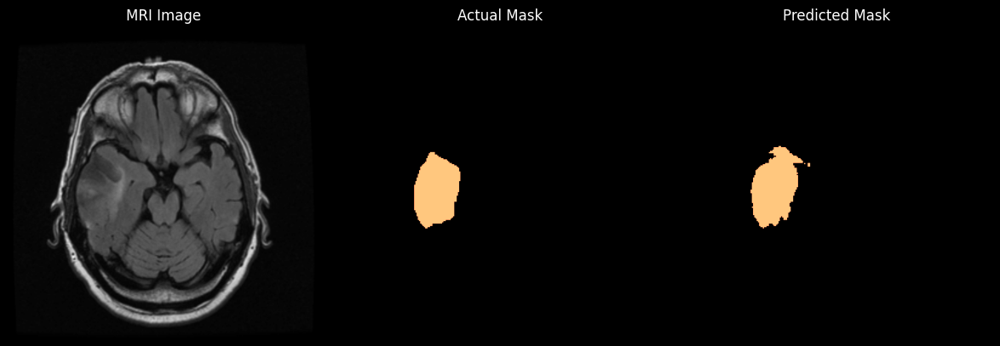

IoU: tensor([[0.8503]])


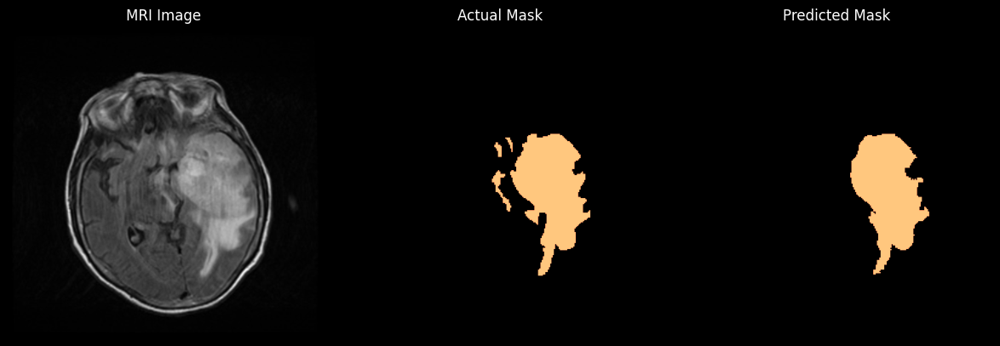

IoU: tensor([[0.7300]])


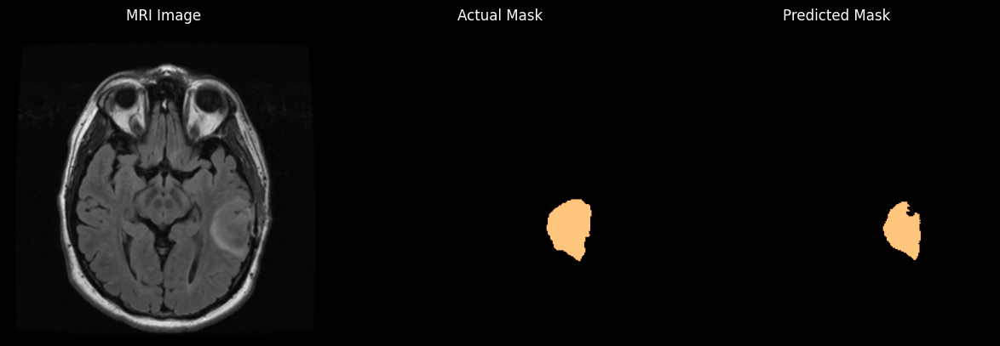

IoU: tensor([[0.8867]])


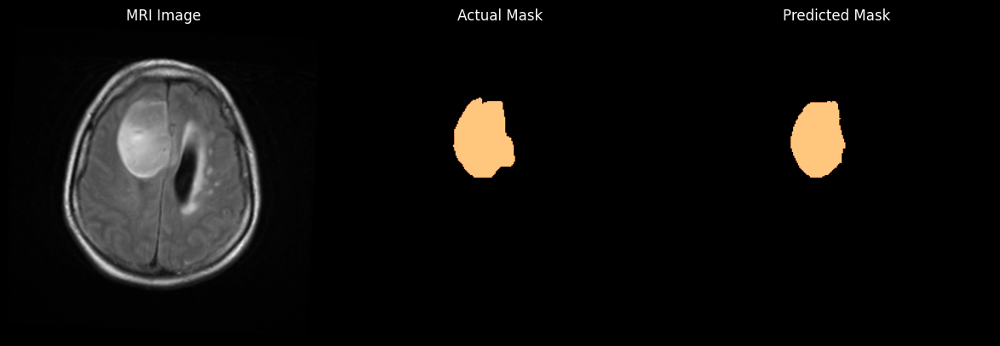

IoU: tensor([[0.8343]])


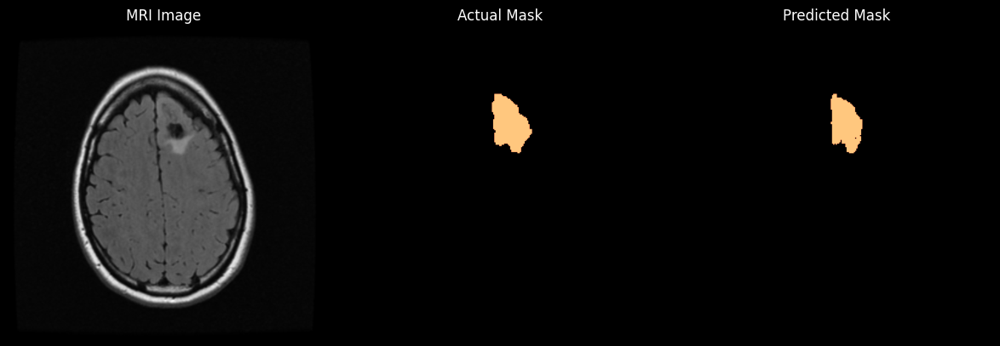

IoU: tensor([[0.8496]])


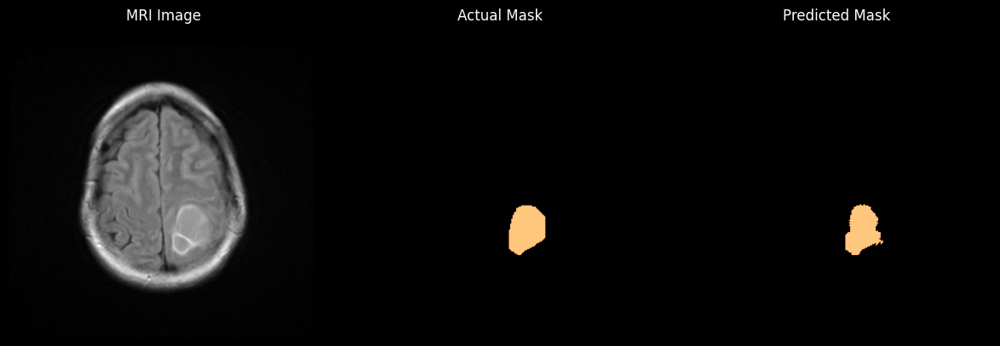

IoU: tensor([[0.7253]])


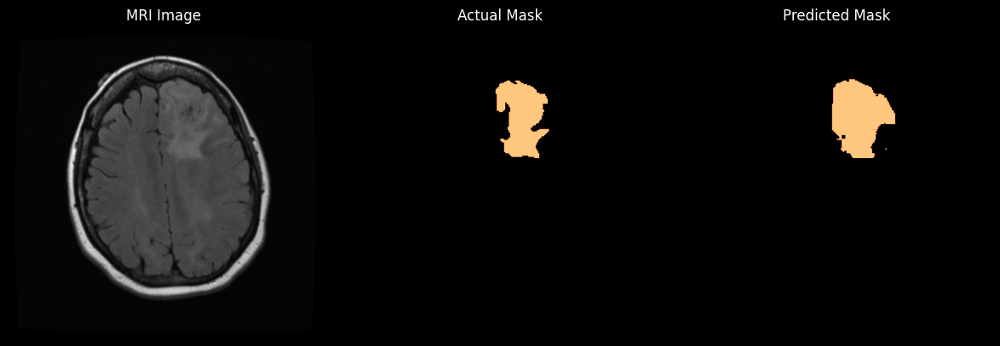

IoU: tensor([[0.6240]])


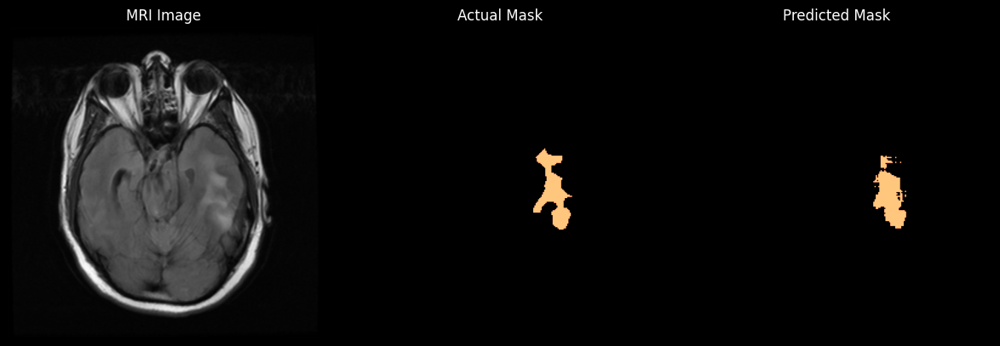

IoU: tensor([[0.9323]])


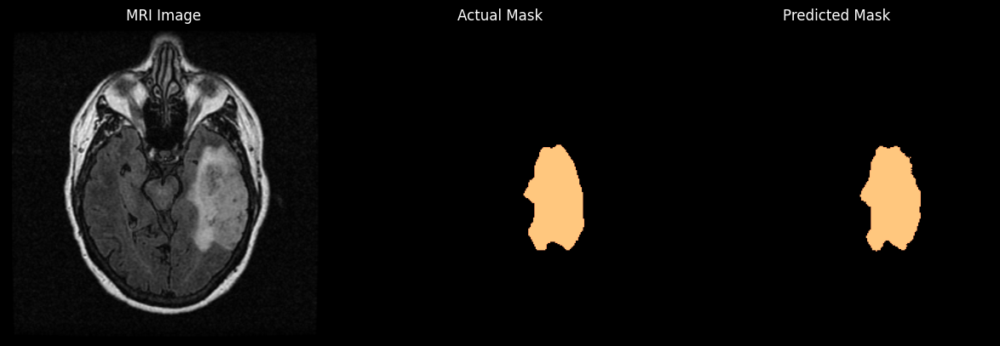

IoU: tensor([[0.7783]])


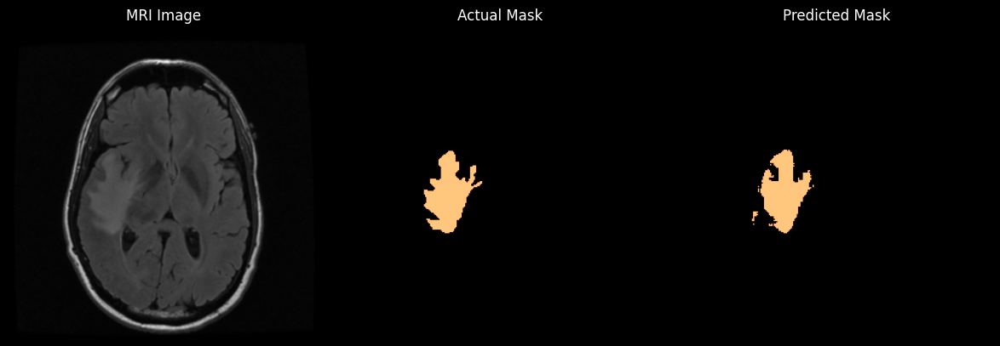

IoU: tensor([[0.6439]])


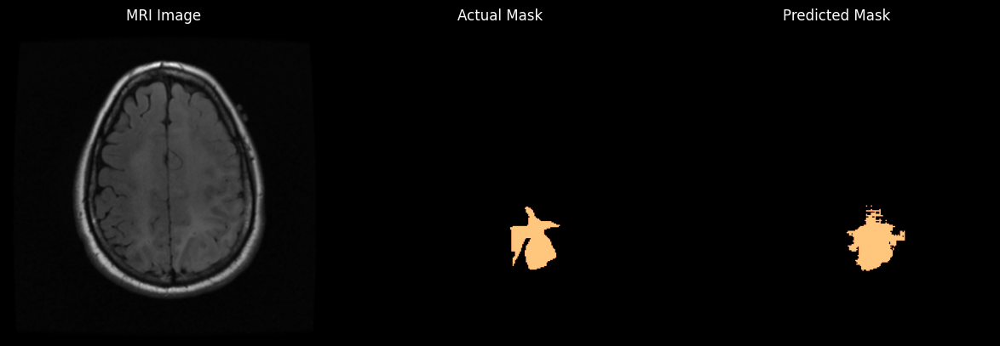

IoU: tensor([[0.5144]])


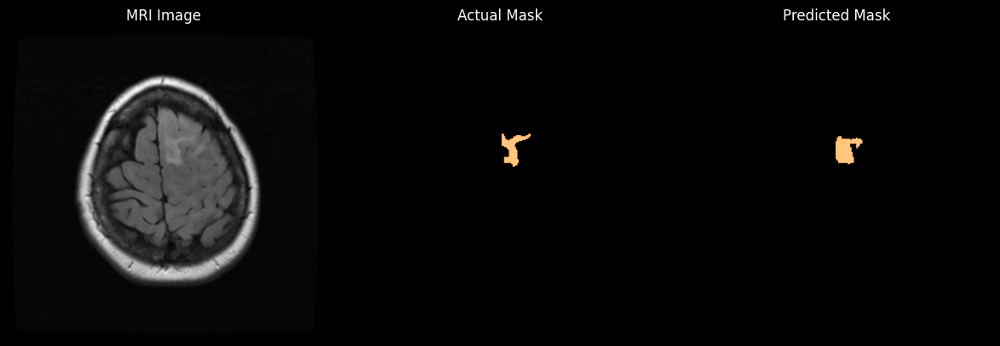

IoU: tensor([[0.5929]])


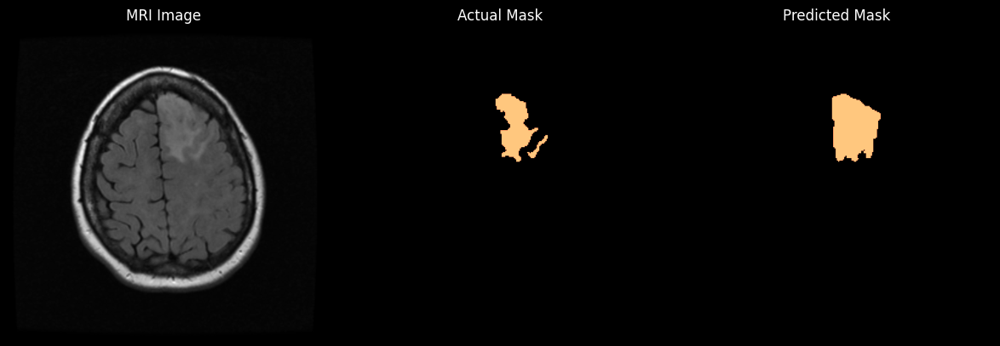

IoU: tensor([[0.4991]])


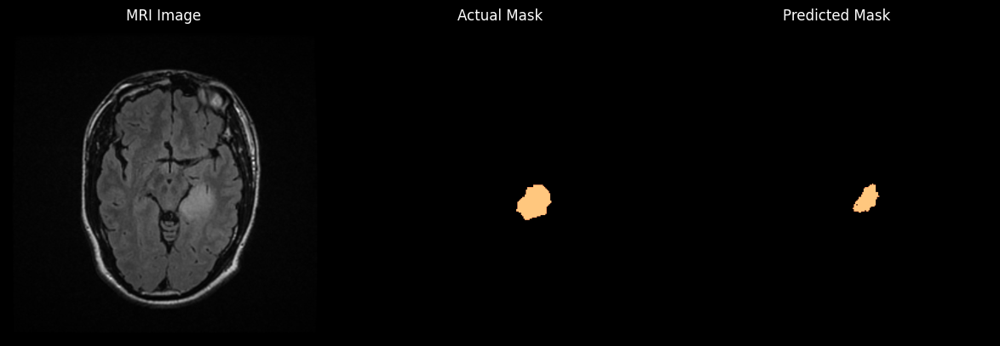

IoU: tensor([[0.6119]])


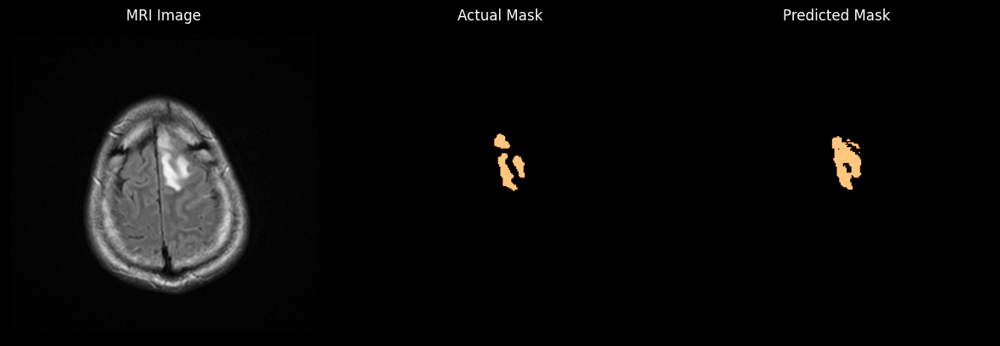

IoU: tensor([[0.6395]])


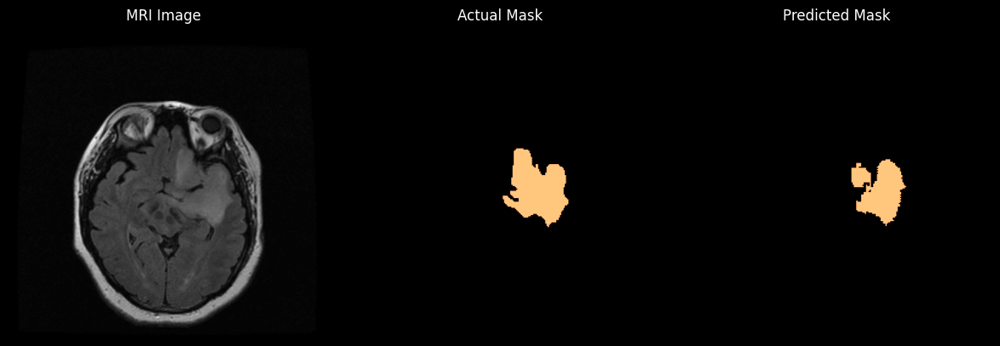

IoU: tensor([[0.8470]])


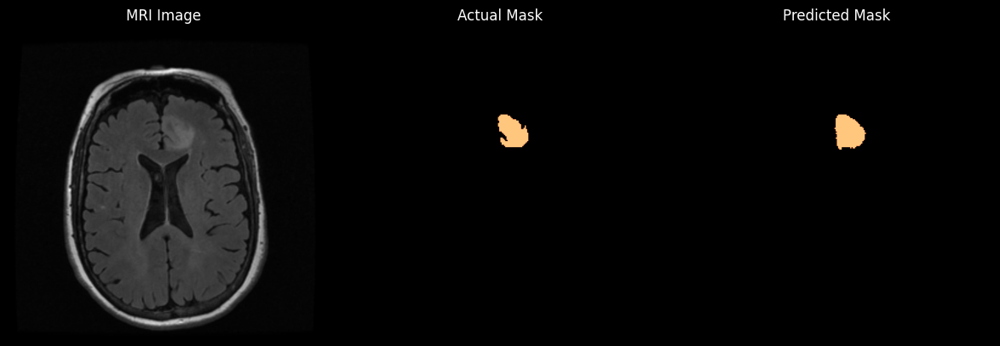

IoU: tensor([[0.7757]])


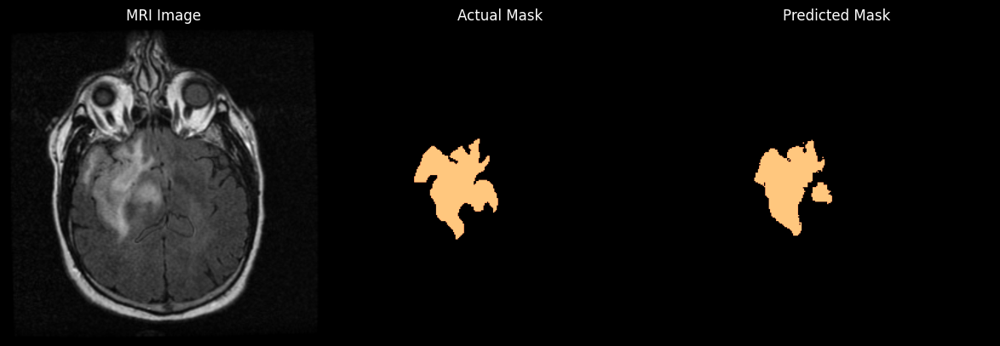

IoU: tensor([[0.8485]])


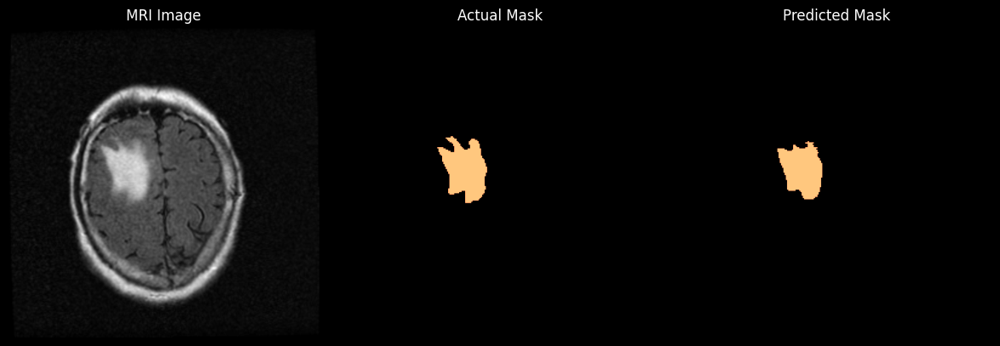

IoU: tensor([[0.8590]])


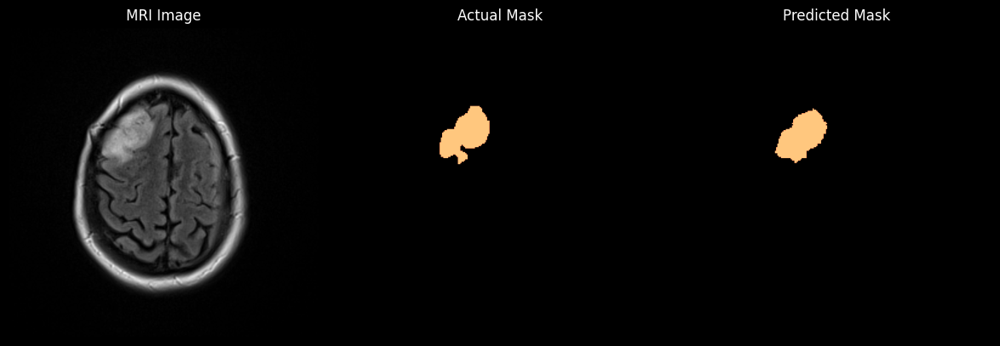

IoU: tensor([[0.9085]])


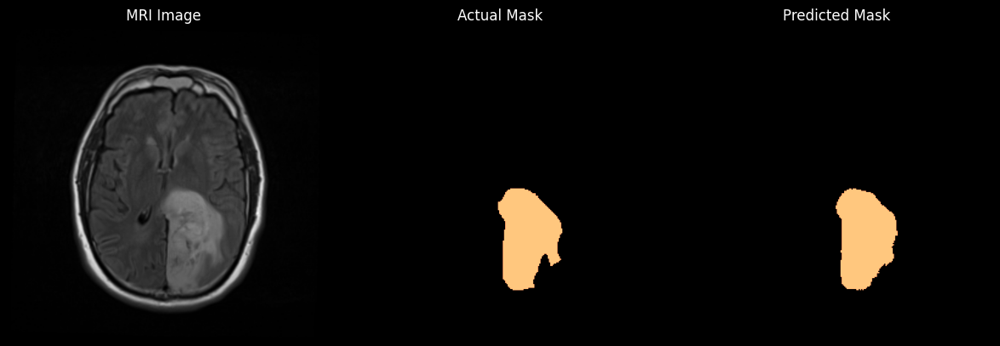

IoU: tensor([[0.1755]])


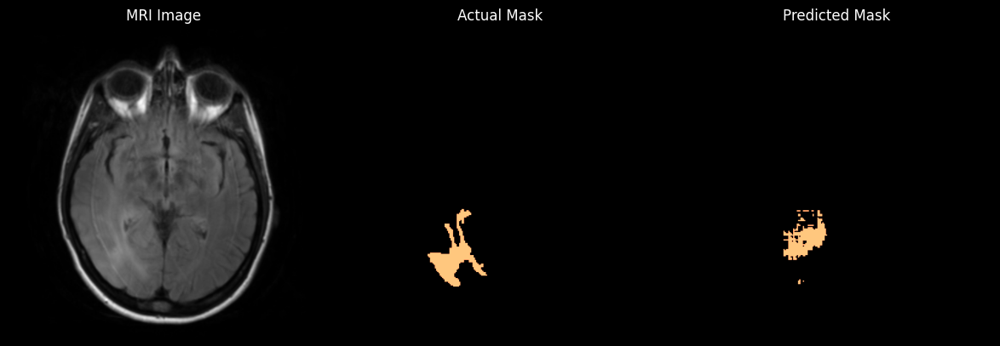

IoU: tensor([[0.8008]])


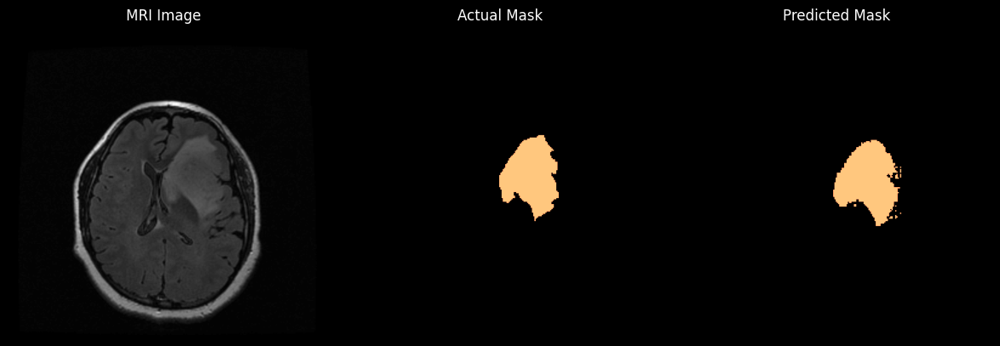

IoU: tensor([[0.4787]])


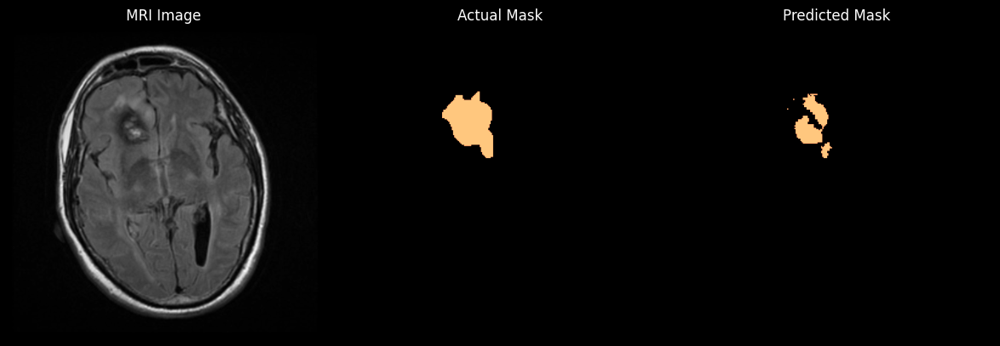

IoU: tensor([[0.9268]])


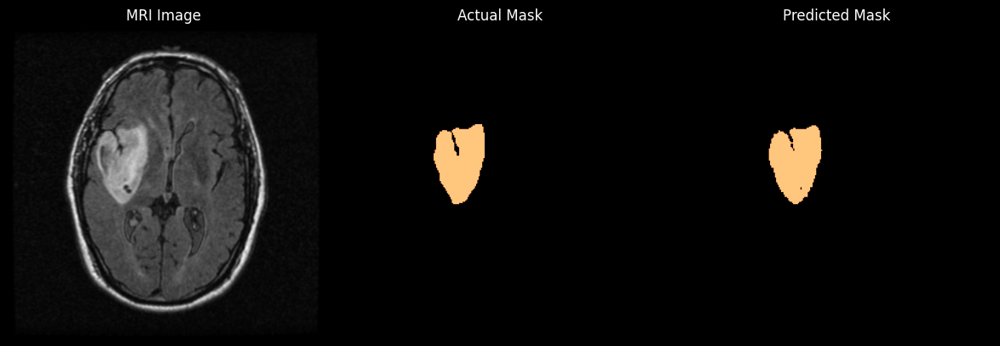

IoU: tensor([[0.8408]])


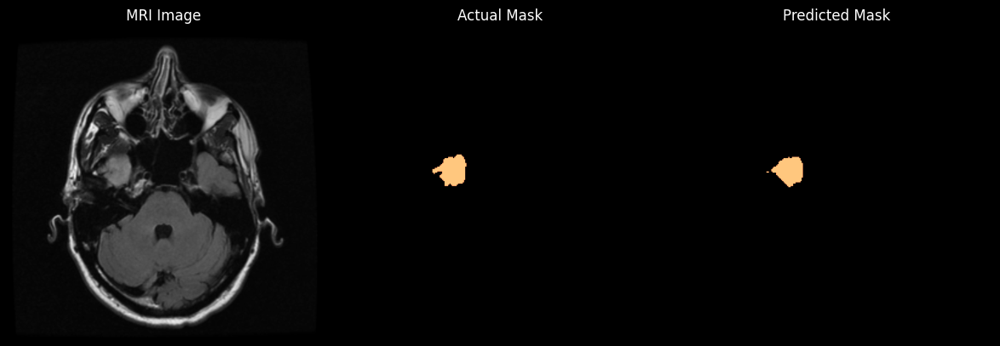

IoU: tensor([[0.8107]])


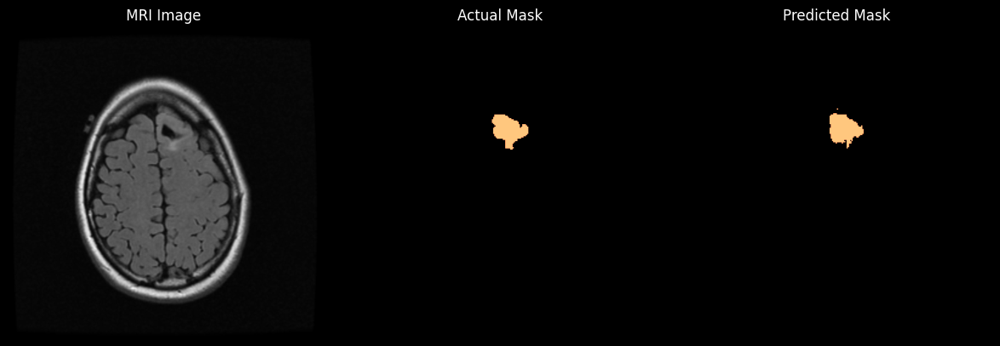

IoU: tensor([[0.6924]])


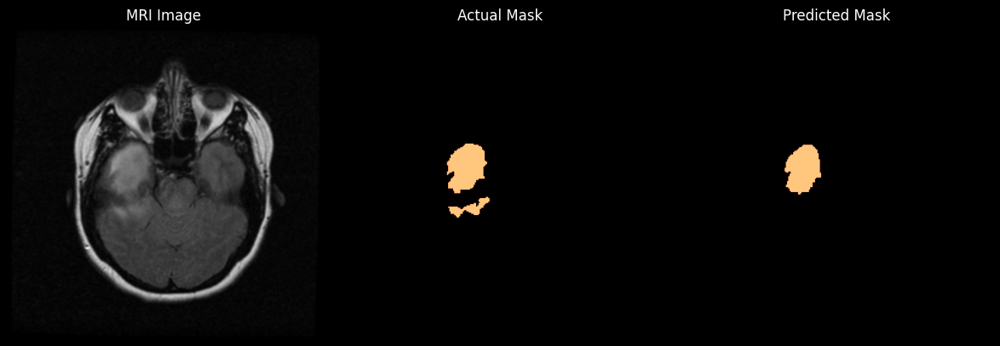

IoU: tensor([[0.8194]])


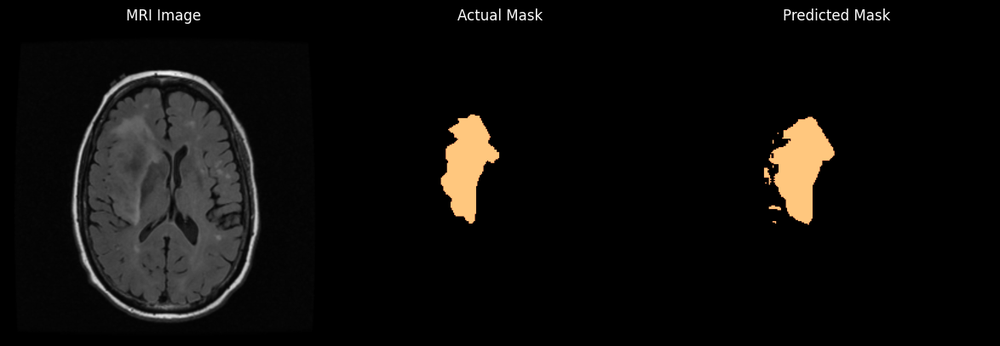

IoU: tensor([[0.8531]])


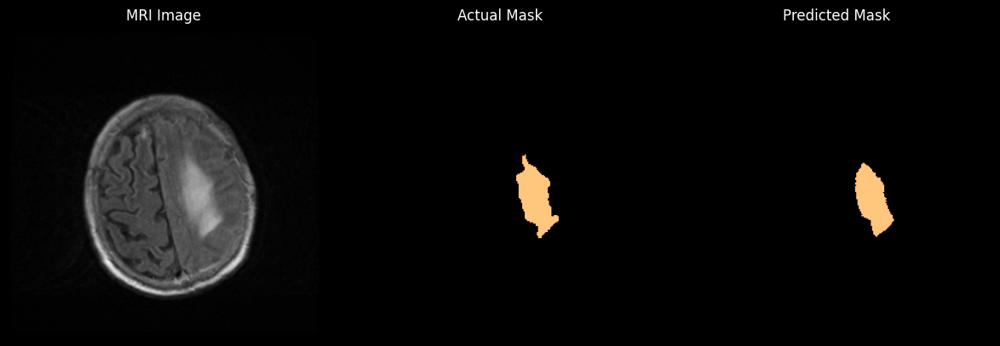

IoU: tensor([[0.7563]])


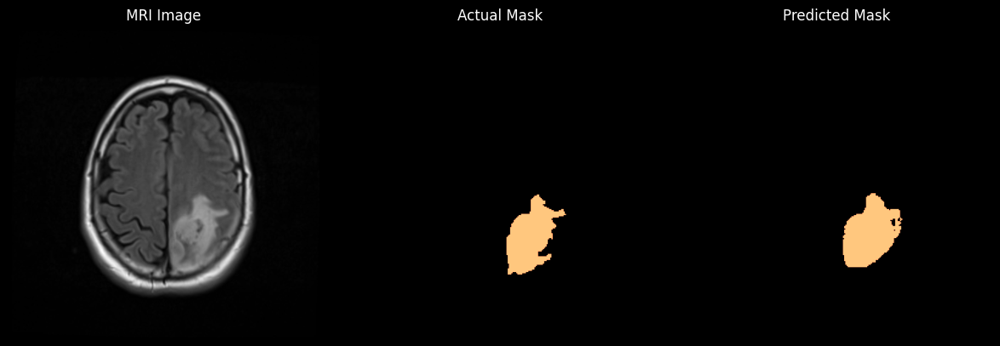

In [82]:
test_ious = []
model.eval()
# Iteratire through test images
with torch.no_grad():
    for batch in tqdm(test_dataloader):

        # forward pass
        outputs = model(pixel_values=batch["pixel_values"].cuda(),
                      input_boxes=batch["input_boxes"].cuda(),
                      multimask_output=False)

        ground_truth_masks = batch["ground_truth_mask"].float().cuda()

        # apply sigmoid
        sam_mask_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
        sam_mask_prob = sam_mask_prob.cpu().numpy().squeeze()
        sam_mask = (sam_mask_prob > 0.5)

        iou = compute_iou(torch.from_numpy(sam_mask).reshape(1, 256, 256).unsqueeze(1).cpu(),
                          ground_truth_masks.unsqueeze(1).cpu(), ignore_empty=False)

        print(f'IoU: {iou}')
        test_ious.append(iou)

        plt.figure(figsize=(12,4))
        plt.subplot(1,3,1)
        plt.imshow(batch["pixel_values"][0,1], cmap='gray')
        plt.title('MRI Image')
        plt.axis('off')
        
        plt.subplot(1,3,2)
        plt.imshow(batch["ground_truth_mask"][0], cmap='copper')
        plt.title('Actual Mask')
        plt.axis('off')
        
        plt.subplot(1,3,3)
        plt.imshow(sam_mask, cmap='copper')
        plt.title('Predicted Mask')
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()

# Inference with Known Bounding Box

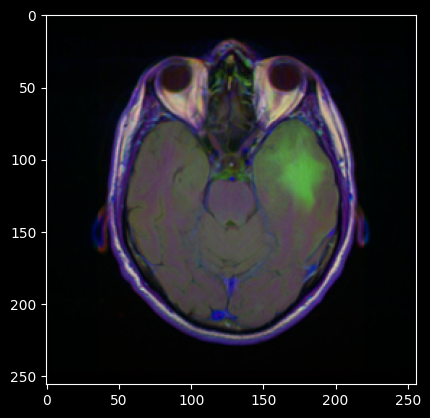

In [135]:
# let's take a random training example
idx = 10

# load image
image = test_dataset[idx]["image"]
plt.imshow(np.array(image))

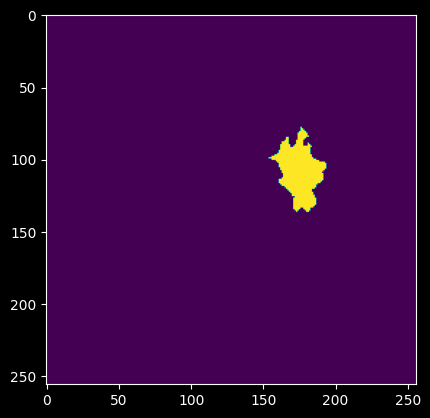

In [136]:
plt.imshow(np.array(test_dataset[idx]["mask"]))

In [137]:
# get box prompt based on ground truth segmentation map
ground_truth_mask = np.array(test_dataset[idx]["mask"])
prompt = get_bounding_box(ground_truth_mask)

# prepare image + box prompt for the model
inputs = processor(image, input_boxes=[[prompt]], return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])


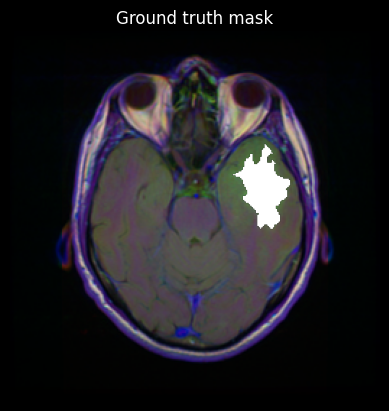

In [138]:
# Plot the image and overlay the mask
fig, axes = plt.subplots()
axes.imshow(np.array(image))
show_mask(ground_truth_mask, axes)
axes.title.set_text(f"Ground truth mask")
axes.axis("off")

plt.show()

In [139]:
model.eval()

# forward pass
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [140]:
# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

(-0.5, 255.5, 255.5, -0.5)

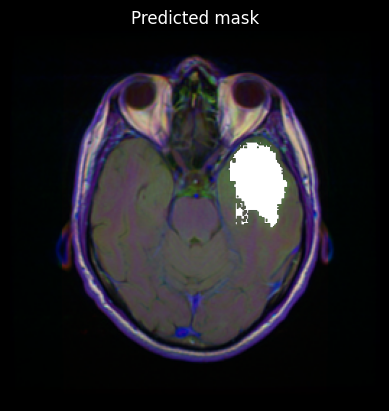

In [141]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([255, 255, 255, 255])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

fig, axes = plt.subplots()

axes.imshow(np.array(image))
show_mask(medsam_seg, axes)
axes.title.set_text(f"Predicted mask")
axes.axis("off")

# Calculate Predicted Mask

In [142]:
predicted_masks = outputs.pred_masks.squeeze(1) # perlu diubah ke sigmoid
ground_truth_masks = batch["ground_truth_mask"].float().to(device)

sam_masks_prob = torch.sigmoid(predicted_masks)
sam_masks_prob = sam_masks_prob.squeeze()
sam_masks = (sam_masks_prob > 0.5)

In [143]:
pred = torch.from_numpy(medsam_seg).float()
pred

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])

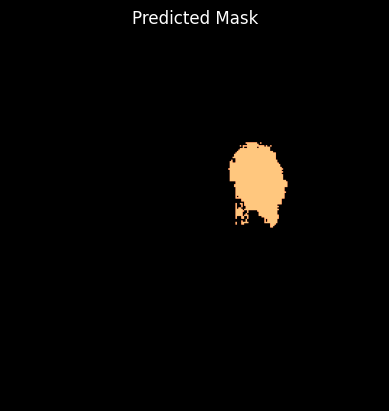

In [144]:
import matplotlib.pyplot as plt

# Ensure pred is a 2D array for visualization
if pred.dim() == 3:
    pred = pred.squeeze(0)  # Remove batch dimension if present

plt.imshow(pred.numpy(), cmap='copper')
plt.title('Predicted Mask')
plt.axis('off')
plt.show()


In [145]:
act = torch.from_numpy(ground_truth_mask).float()
act

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])

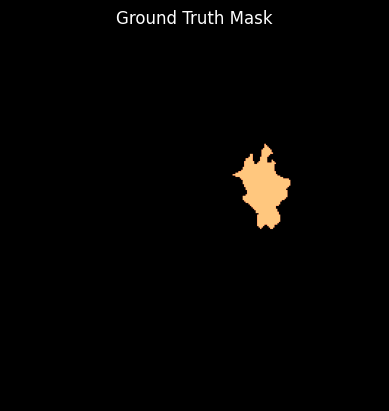

In [146]:
#-----------------------------------
import matplotlib.pyplot as plt

# Ensure act is a 2D array for visualization
if act.dim() == 3:
    act = act.squeeze(0)  # Remove batch dimension if present

plt.imshow(act.numpy(), cmap='copper')
plt.title('Ground Truth Mask')
plt.axis('off')
plt.show()


In [147]:
iou = compute_iou(act/255, pred)

iou

tensor(0.6172)

# Prompt: Bounding Box in Image

In [158]:
# Function to draw a bounding box around the object in an image
def draw_bounding_box(image):
    # Load the image
    # image = cv2.imread(image_path)

    # Convert the image to gray scale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply a blur to the image to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image to get the object in binary
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Find contours in the thresholded image
    contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Find the largest contour, assuming the object to bound is the largest one
    largest_contour = max(contours, key=cv2.contourArea)

    # Draw a bounding box around the largest contour
    x, y, w, h = cv2.boundingRect(largest_contour)
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    plt.imshow(image)

    x_min = x
    x_max = x + w
    y_min = y
    y_max = y + h

    return [x_min, y_min, x_max, y_max]


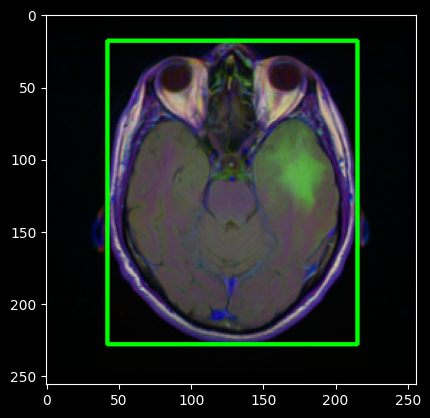

In [159]:
pr = draw_bounding_box(np.array(test_dataset[10]["image"]))

In [160]:
image = test_dataset[10]["image"]
ground_truth_mask = np.array(test_dataset[10]["mask"])

# prepare image + box prompt for the model
inputs = processor(image, input_boxes=[[pr]], return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])


In [161]:
model.eval()

# forward pass
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [162]:
# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

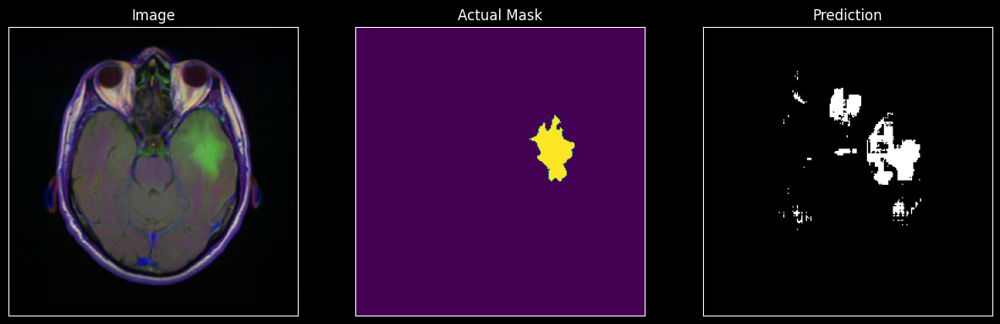

In [163]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(ground_truth_mask)  # Assuming the second image is grayscale
axes[1].set_title("Actual Mask")

# Plot the second image on the right
axes[2].imshow(medsam_seg, cmap='gray')  # Assuming the second image is grayscale
axes[2].set_title("Prediction")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

In [164]:
def compute_iou(pred, target, ignore_empty=False):
    # Ensure inputs are tensors
    if isinstance(pred, np.ndarray):
        pred = torch.from_numpy(pred).float().unsqueeze(0).unsqueeze(0)
    elif isinstance(pred, torch.Tensor):
        pred = pred.unsqueeze(0).unsqueeze(0)

    if isinstance(target, np.ndarray):
        target = torch.from_numpy(target).float().unsqueeze(0).unsqueeze(0)
    elif isinstance(target, torch.Tensor):
        target = target.unsqueeze(0).unsqueeze(0)

    # Calculate IoU
    intersection = torch.sum(pred * target)
    union = torch.sum(pred) + torch.sum(target) - intersection
    iou = intersection / union if union != 0 else torch.tensor(0.)
    
    return iou

# Ensure pred and act are tensors
pred = torch.from_numpy(medsam_seg).float()
act = torch.from_numpy(ground_truth_mask).float()

# Compute IoU
iou = compute_iou(act / 255, pred, ignore_empty=False)
print(f'IoU: {iou.item()}')


IoU: 0.3099282681941986


In [167]:
import numpy as np
from sklearn.metrics import confusion_matrix

def calculate_confusion_matrix(pred_mask, gt_mask, threshold=0.5):
    # Flatten masks
    pred_flat = pred_mask.flatten()
    gt_flat = gt_mask.flatten()
    
    # Binarize predictions and ground truth masks
    pred_binary = (pred_flat > threshold).astype(int)
    gt_binary = (gt_flat > threshold).astype(int)
    
    # Calculate confusion matrix
    cm = confusion_matrix(gt_binary, pred_binary)
    
    return cm

# Calculate confusion matrix
cm = calculate_confusion_matrix(medsam_seg, ground_truth_mask)
print(f'Confusion Matrix:\n{cm}')


Confusion Matrix:
[[62887  1512]
 [  316   821]]


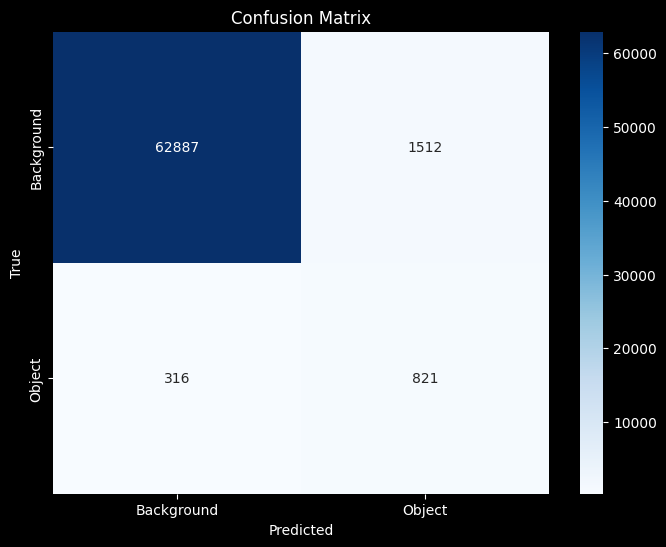

In [168]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_confusion_matrix(cm, class_names):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()

# Define class names
class_names = ['Background', 'Object']  # Adjust if you have more classes

# Plot confusion matrix
plot_confusion_matrix(cm, class_names)


In [169]:
import numpy as np

# Confusion matrix values
cm = np.array([[62887, 1512],
               [  316,  821]])

# Extract values
TN, FP = cm[0]
FN, TP = cm[1]

# Calculate metrics
accuracy = (TN + TP) / (TN + FP + FN + TP)
precision = TP / (TP + FP)
recall = TP / (TP + FN)
f1_score = 2 * (precision * recall) / (precision + recall)

# Print results
print(f'Confusion Matrix:\n{cm}')
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1_score:.4f}')


Confusion Matrix:
[[62887  1512]
 [  316   821]]
Accuracy: 0.9721
Precision: 0.3519
Recall: 0.7221
F1 Score: 0.4732
